In [1]:
import os
import warnings

import numpy as np 

from scipy.stats import chisquare

from astropy.io import fits
from astropy.stats import sigma_clipped_stats
from astropy.stats import mad_std, gaussian_sigma_to_fwhm
from astropy.table import Table
from astropy.modeling import models, fitting, functional_models, Parameter
from astropy.nddata import Cutout2D
from astropy.wcs import WCS
from astropy.utils.exceptions import AstropyWarning
from astropy import units as u

from astropy.stats import gaussian_fwhm_to_sigma

from photutils import DAOStarFinder
from photutils import aperture_photometry, CircularAperture

In [2]:
from lcbg.utils import cutout, measure_fwhm
from lcbg.fitting import fit_gaussian2d, fit_sersic2d, plot_fit

In [3]:
%matplotlib inline
from matplotlib import pyplot as plt
from matplotlib import gridspec
from mpl_toolkits.mplot3d import Axes3D
from matplotlib import cm
plt.rcParams['figure.figsize'] = [12, 12]

# TODO

- [ ] Find out the mean pixel value of an LCBG in the ACS images
    - We need this for clipping the catalog without removing these objects
    - Do we already know where the LCBGs are or do we use spectra data to find them?
    
    
- [ ] Compare the output catalog to catalogs that are already out there
    - There might be a catalog in the fits files?

        
- [ ] Look up what the flux and mag columns in the sources table mean



- Do we clip negative data values or do we add the min for the data to the data (sale it up)?  


- Use sig in model to find FWHM


- Use 2D models for FWHM 


- Comment sub-sections of FWHM

# Local Paths (NB Inputs)

In [4]:
input_data_path = "https://archive.stsci.edu/pub/hlsp/frontier/abell370/images/hst/v1.0-epoch2/hlsp_frontier_hst_wfc3-30mas_abell370_f105w_v1.0-epoch2_drz.fits"
input_data_path = "https://archive.stsci.edu/pub/hlsp/frontier/abell370/images/hst/v1.0-epoch2/hlsp_frontier_hst_wfc3-30mas-bkgdcor_abell370_f105w_v1.0-epoch2_drz.fits"
# input_data_path = "https://archive.stsci.edu/pub/hlsp/frontier/abell370/images/hst/v1.0-epoch2/hlsp_frontier_hst_acs-30mas-selfcal_abell370-hffpar_f435w_v1.0-epoch2_drz.fits"
output_path = "{}_catalog.csv".format(os.path.splitext(os.path.basename(input_data_path))[0])

print("Output: ", output_path)

Output:  hlsp_frontier_hst_wfc3-30mas-bkgdcor_abell370_f105w_v1.0-epoch2_drz_catalog.csv


# Load Data

In [5]:
hdul = fits.open(input_data_path)
hdu = hdul[0]

In [6]:
data = hdu.data
header = hdu.header
wcs = WCS(header)

Plot image

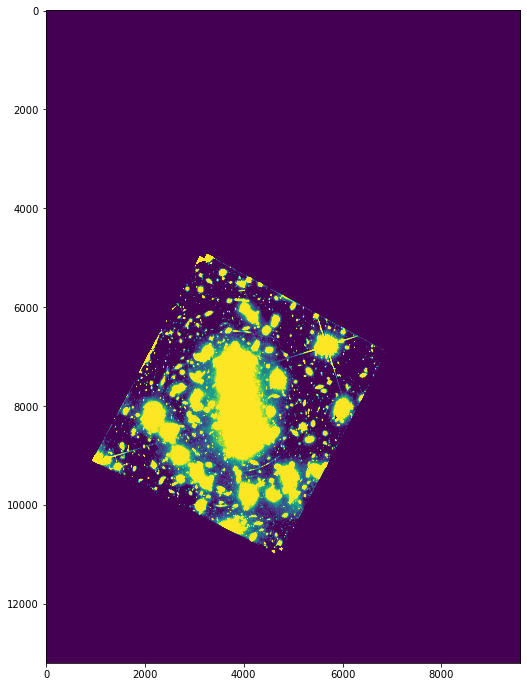

In [7]:
plt.imshow(data, vmin=0, vmax=2.9534784e-05*90)

# Clean the Data

Estimate noise and remove it from image 

### Estimate Mean Noise

Mean of the image 

0.0032234956

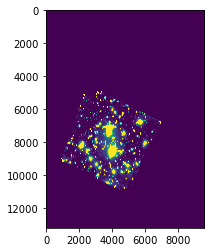

In [8]:
subsection = data 
plt.imshow(subsection, vmin=0, vmax=2.9534784e-05*350)
subsection.mean()

Zoom into image croping out zero and nan values

0.0105100395

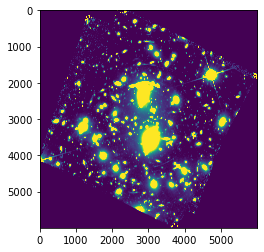

In [9]:
cx, cy = wcs.world_to_pixel_values(header["RA_TARG"], header["DEC_TARG"])
subsection = cutout(data, int(cx), int(cy), 6000)
plt.imshow(subsection, vmin=0, vmax=2.9534784e-05*350)
subsection.mean()

Zoom into dark region of the image and find noise

0.000312165

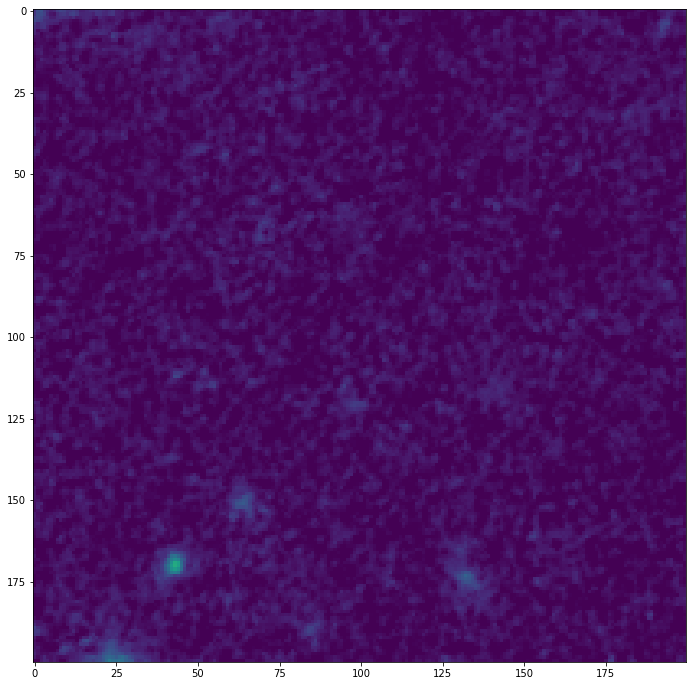

In [8]:
subsection = cutout(data, 4444, 10150, 200)
plt.imshow(subsection, vmin=0, vmax=2.9534784e-05*350)
subsection.mean()

In [15]:
mad_std(data)  

0.0

In [9]:
mean_noise = 0.0003401655
#mean_noise = 0.00017202659

# Estimate FWHM

This will be used to estimate the size of the apertures used in the DAOStarFinder finder and photometry section

### Bright star:

Image Max: 1447.6043701171875
Amplitude: 1320.8922874433763
Center: (19.911180998120038, 20.62014113193742)
Sigma = (3.081912526281486, 3.5843770574459386)
Mean FWHM: 8 Pix 
FWHM: (x=7.257349393919616, y=8.440562943822746) Pix 


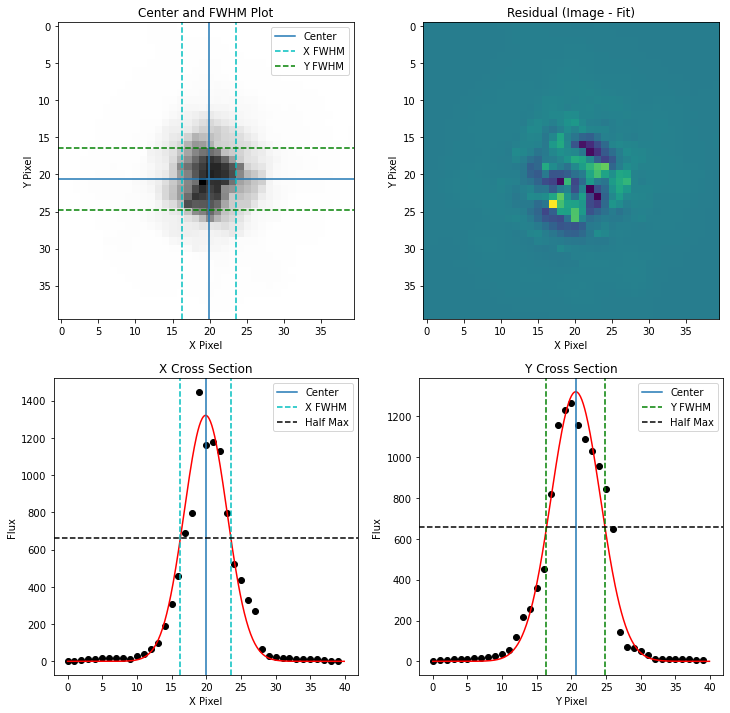

In [10]:
image = cutout(data, 5670, 6788, 40)
measure_fwhm(image-mean_noise);

### Dim star:

Image Max: 78.48284149169922
Amplitude: 69.76803828168299
Center: (20.297992745930166, 20.37175698609268)
Sigma = (2.5390699698579104, 2.6981948036939594)
Mean FWHM: 6 Pix 
FWHM: (x=5.979052860757536, y=6.353763209136883) Pix 


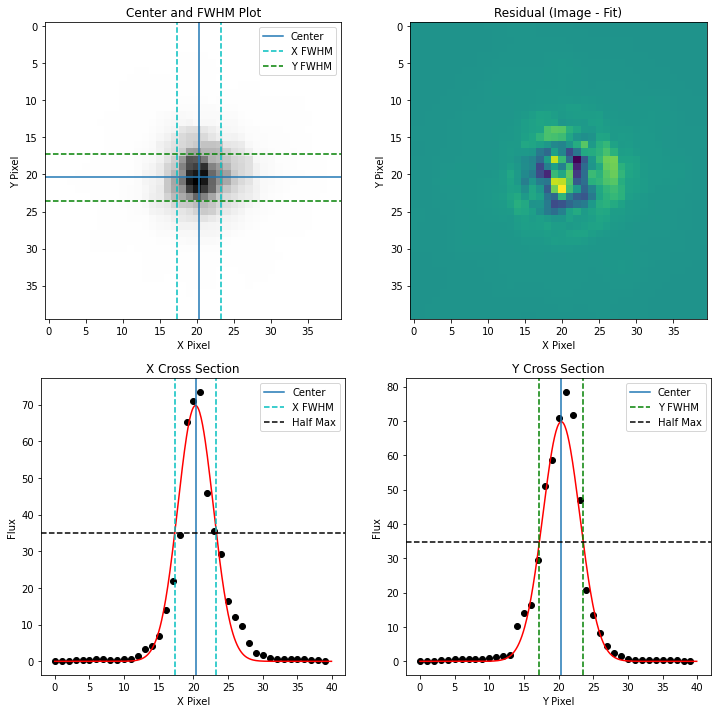

In [11]:
image = cutout(data, 1457, 9231, 40)
measure_fwhm(image);

In [12]:
((8*gaussian_fwhm_to_sigma)*3)*gaussian_sigma_to_fwhm

24.0

# Aperture Photometry

### Select Image

In [224]:
cx, cy = wcs.world_to_pixel_values(header["RA_TARG"], header["DEC_TARG"])
#image = cutout(data, int(cx), int(cy), 6000)
image = cutout(data, int(cx), int(cy), 3500)

#image = cutout(data, 2072, 8309, 1000)
#image = cutout(data, 3791, 7332, 2000)
#image = data[1000:-1000,1000:-1000]

#image -= mean_noise
#mean_noise = image.mean()

In [225]:
#image = np.clip(image_copy, mean_noise*400, image.max())

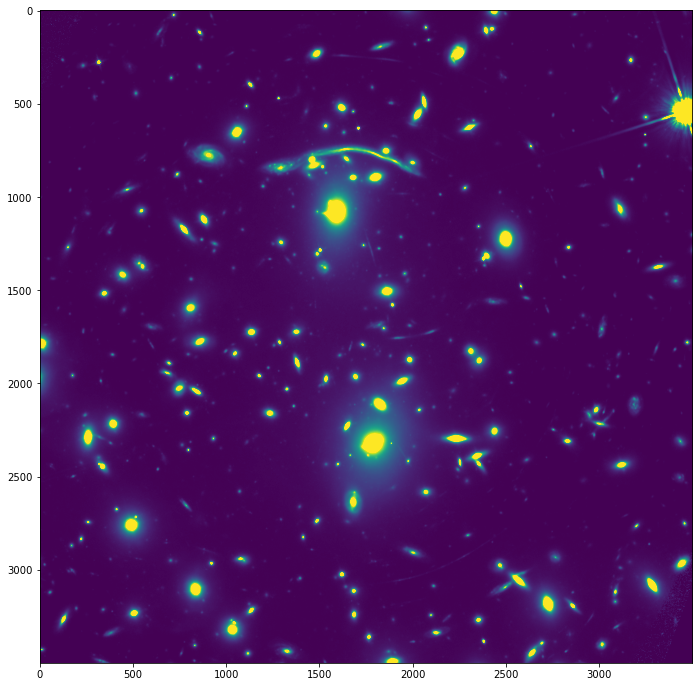

In [227]:
plt.imshow(image, vmin=0, vmax=mean_noise*300)

#  Image Segmentation

In [233]:
from photutils import detect_threshold
#threshold = detect_threshold(image, nsigma=5.)
threshold = detect_threshold(image, nsigma=8.)
#threshold[:, :] = mean_noise*300

In [234]:
np.unique(threshold)

array([0.01020801], dtype=float32)

In [235]:
from astropy.convolution import Gaussian2DKernel
from astropy.stats import gaussian_fwhm_to_sigma
from photutils import detect_sources

sigma = 6.0 * gaussian_fwhm_to_sigma  # FWHM = 8.
kernel = Gaussian2DKernel(sigma, x_size=4, y_size=4)
kernel.normalize()
segm = detect_sources(image, threshold, npixels=8**2 ,filter_kernel=kernel,)

Text(0.5, 1.0, 'Segmentation Image')

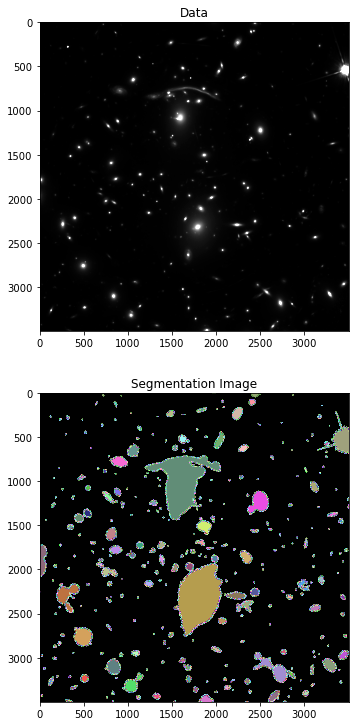

In [236]:
import numpy as np
import matplotlib.pyplot as plt
from astropy.visualization import SqrtStretch
from astropy.visualization.mpl_normalize import ImageNormalize
norm = ImageNormalize(stretch=SqrtStretch())
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(10, 12.5))
ax1.imshow(image, cmap='Greys_r', vmin=0, vmax=mean_noise*1000)
ax1.set_title('Data')

cmap = segm.make_cmap(random_state=np.random.randint(1000))
ax2.imshow(segm, cmap=cmap)
ax2.set_title('Segmentation Image')

In [237]:
from photutils import deblend_sources
segm_deblend = deblend_sources(image, segm, npixels=8**2, filter_kernel=kernel, nlevels=30, contrast=1/1000)
#segm_deblend = segm

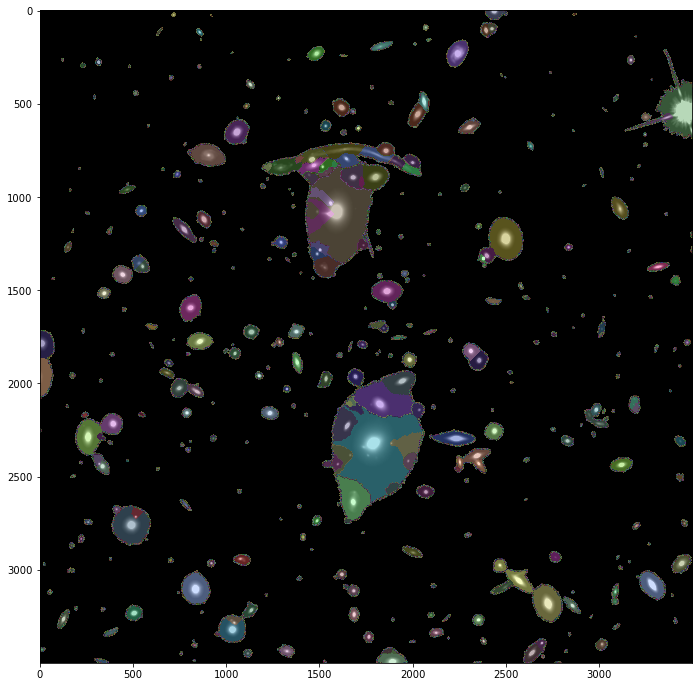

In [238]:
fig = plt.figure(figsize=(12, 12))

cmap = segm.make_cmap(random_state=np.random.randint(1000000))


plt.imshow(image, vmin=mean_noise*100, vmax=mean_noise*600, cmap="gist_gray")
plt.imshow(segm_deblend, cmap=cmap, alpha=0.5)

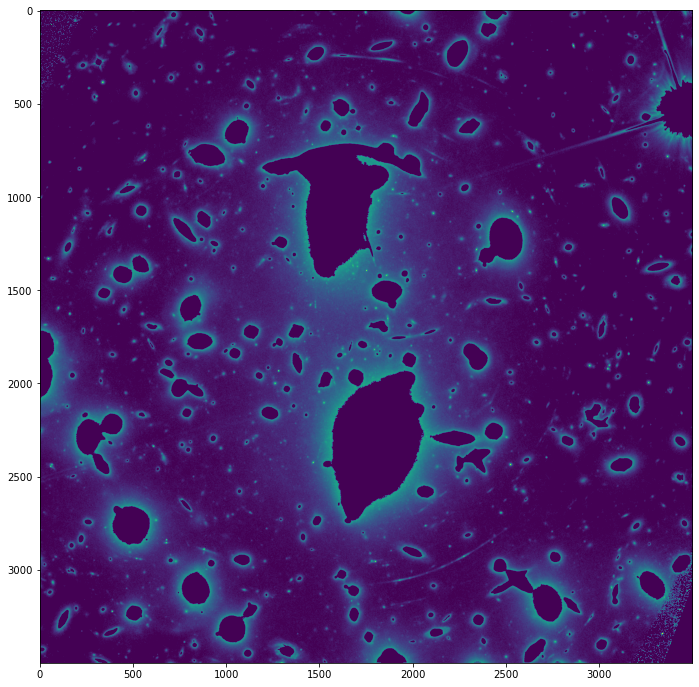

In [239]:
temp = image.copy()
temp[np.where(segm_deblend.data != 0)] = 0.0

fig = plt.figure(figsize=(12, 12))

plt.imshow(temp, vmin=0, vmax=mean_noise*50)

In [240]:
segm_deblend.remove_border_labels(50)
len(segm_deblend.segments)

373

In [241]:
>>> from photutils import source_properties
>>> cat = source_properties(image, segm_deblend)

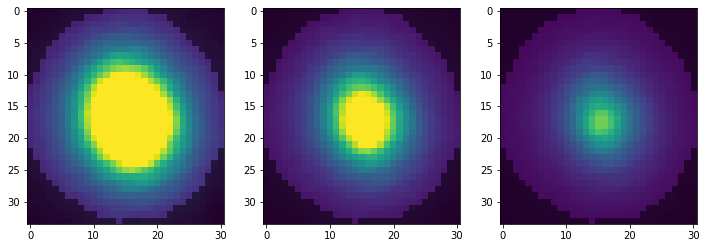

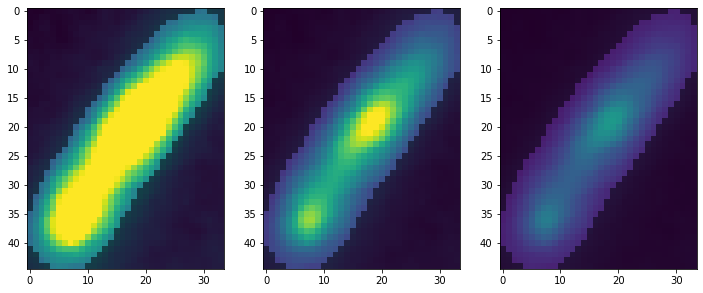

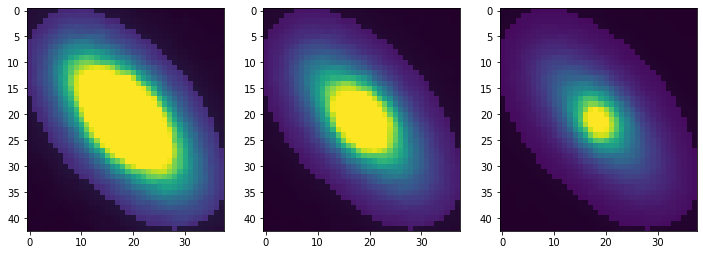

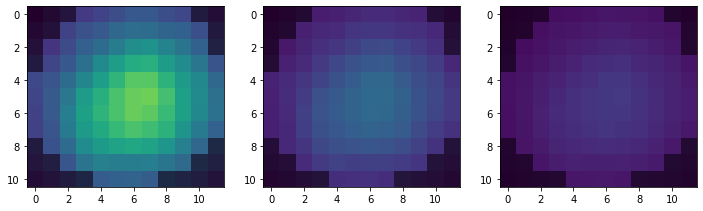

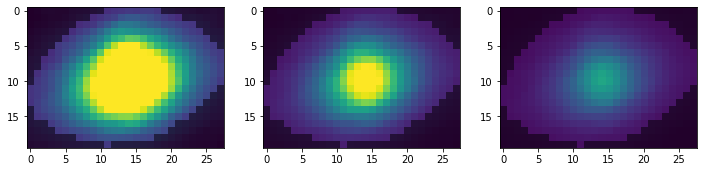

...

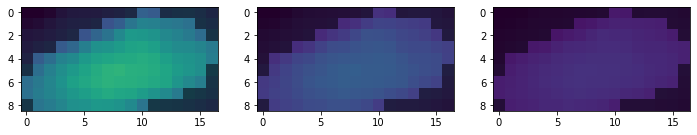

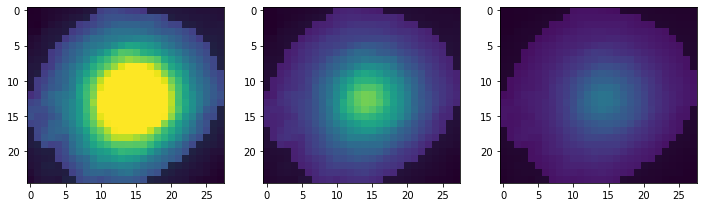

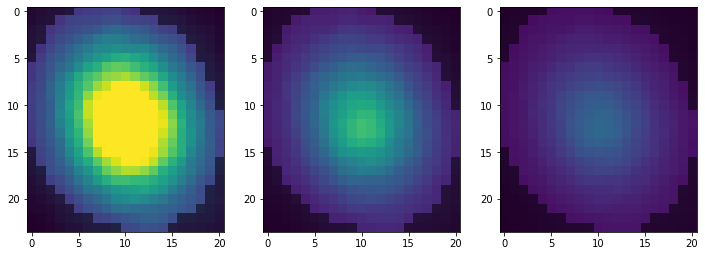

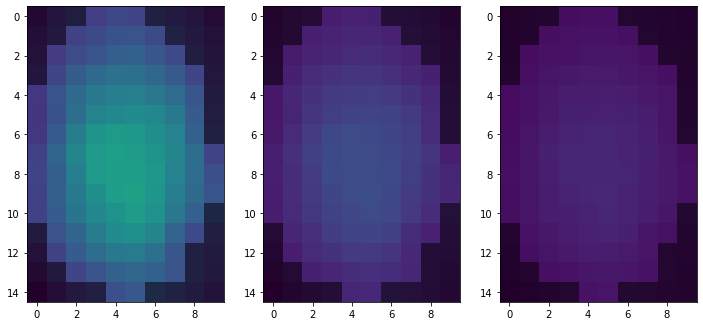

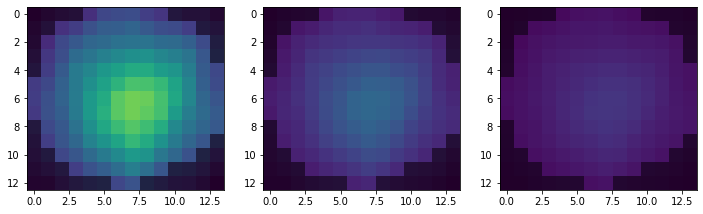

In [200]:
for seg in segm_deblend.segments[:20]:
    fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(12, 12))
    
    temp = seg.make_cutout(image)
    ax1.imshow(temp, vmax=temp.mean()*2)
    ax2.imshow(temp, vmax=temp.mean()*4)
    ax3.imshow(temp, vmax=temp.mean()*8)
    
    mask = seg.data.copy()
    mask = mask.astype(float)
    mask[np.where(mask > 0.)] = np.nan
    
    alpha = 0.5
    ax1.imshow(mask,  cmap='gray', alpha=alpha)
    ax2.imshow(mask, cmap='gray', alpha=alpha)
    ax3.imshow(mask, cmap='gray', alpha=alpha)
    
    plt.show()
    

Image Max: 0.022731531411409378
Amplitude: 0.020209902177124827
Center: (51.13433772546949, 51.317986382650396)
Sigma = (5.4341749513170186, 5.000458479662096)
Mean FWHM: 12 Pix 
FWHM: (x=12.796504103566399, y=11.775179862253289) Pix 


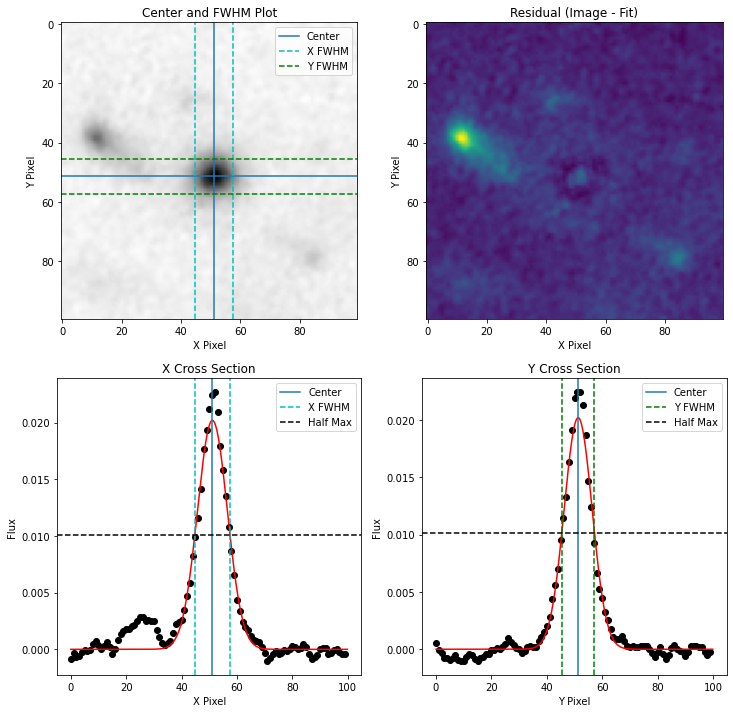

Image Max: 0.38023483753204346
Amplitude: 0.29242100484899136
Center: (43.46124788346977, 14.023740696012206)
Sigma = (4.123738761261444, 7.1640747309903965)
Mean FWHM: 13 Pix 
FWHM: (x=9.710662695489544, y=16.87010678063589) Pix 


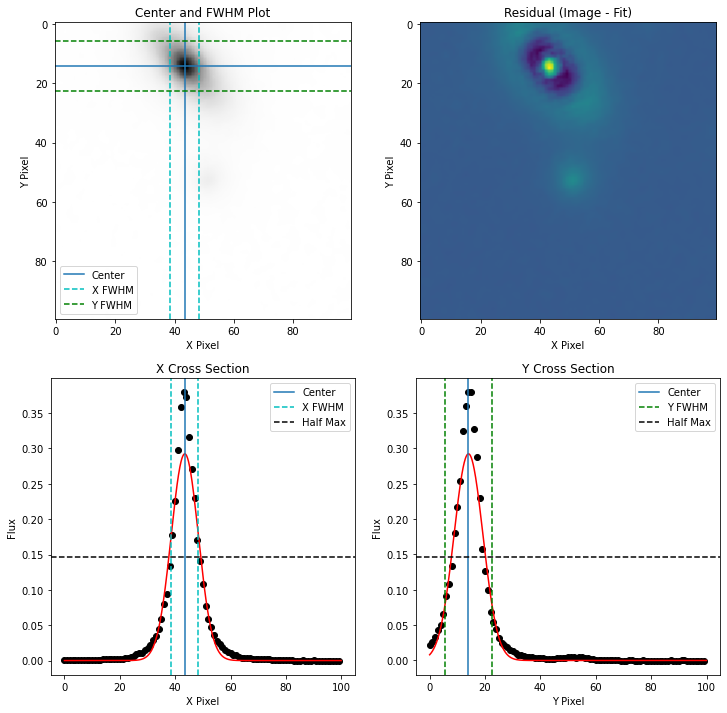

Image Max: 0.12430395185947418
Amplitude: 0.1023106415179587
Center: (51.0751827525818, 50.81918270129452)
Sigma = (5.2938361757045485, 4.130711016388069)
Mean FWHM: 11 Pix 
FWHM: (x=12.466031541659053, y=9.727081101620792) Pix 


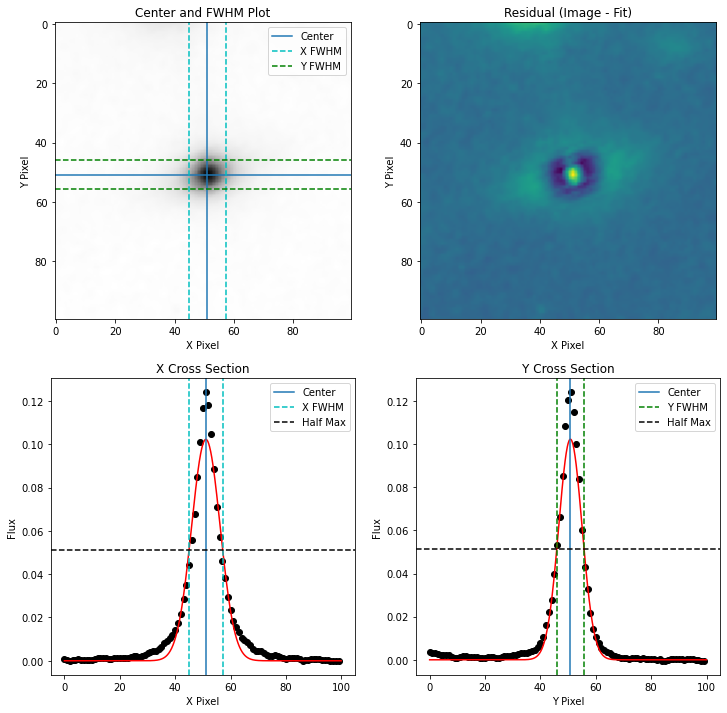

Image Max: 1.0016138553619385
Amplitude: 0.38470897337152066
Center: (51.74883966188668, 50.399587196289545)
Sigma = (15.572951636979267, 20.164014669836625)
Mean FWHM: 42 Pix 
FWHM: (x=36.67149867505631, y=47.48262593282941) Pix 


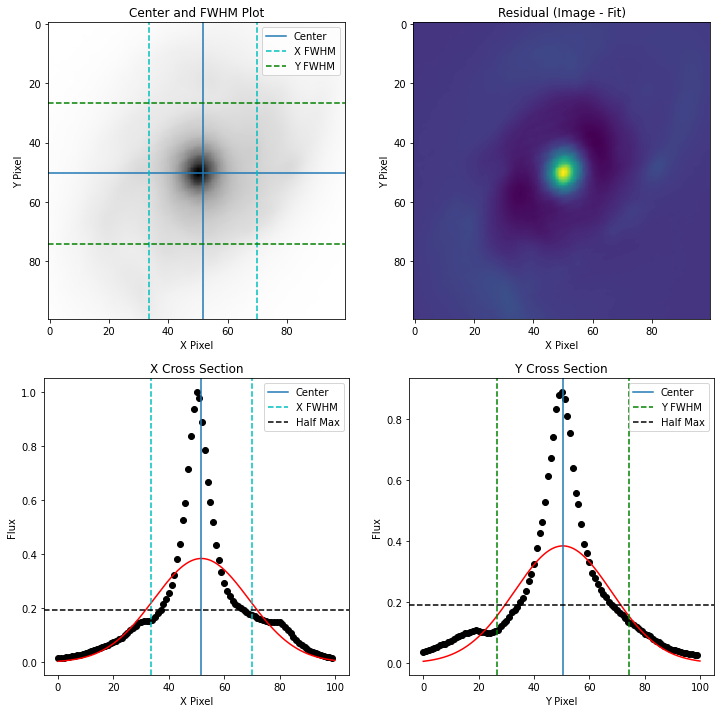

Image Max: 0.04336679354310036
Amplitude: 0.03329137927047793
Center: (31.80450051640102, 2.7830120711659614)
Sigma = (5.625509291796492, 16.61191917015153)
Mean FWHM: 26 Pix 
FWHM: (x=13.247062043830239, y=39.11808024830672) Pix 


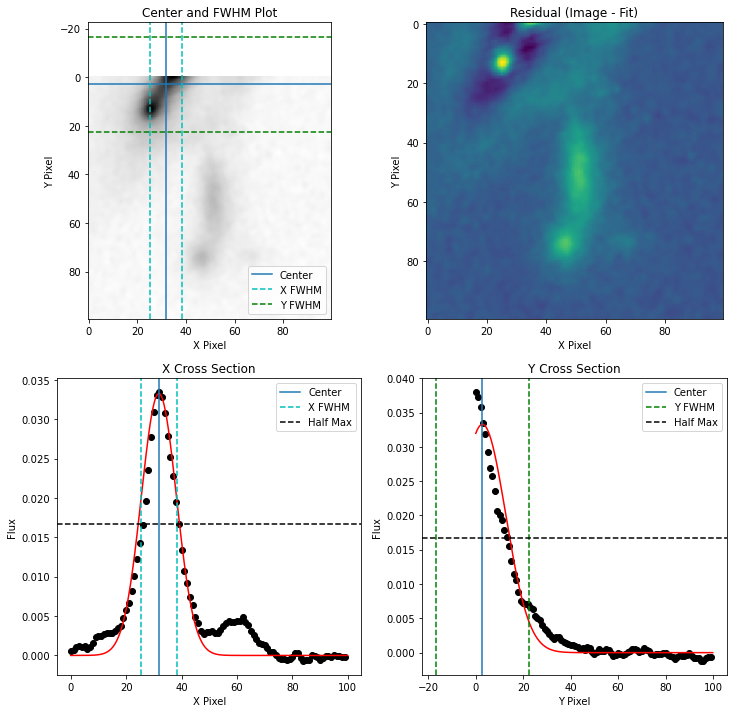

Image Max: 0.13149701058864594
Amplitude: 0.08474862940740636
Center: (46.8907846129176, 51.992128865241455)
Sigma = (29.637027610158903, 8.489842498142533)
Mean FWHM: 45 Pix 
FWHM: (x=69.78986669153788, y=19.992051293781667) Pix 


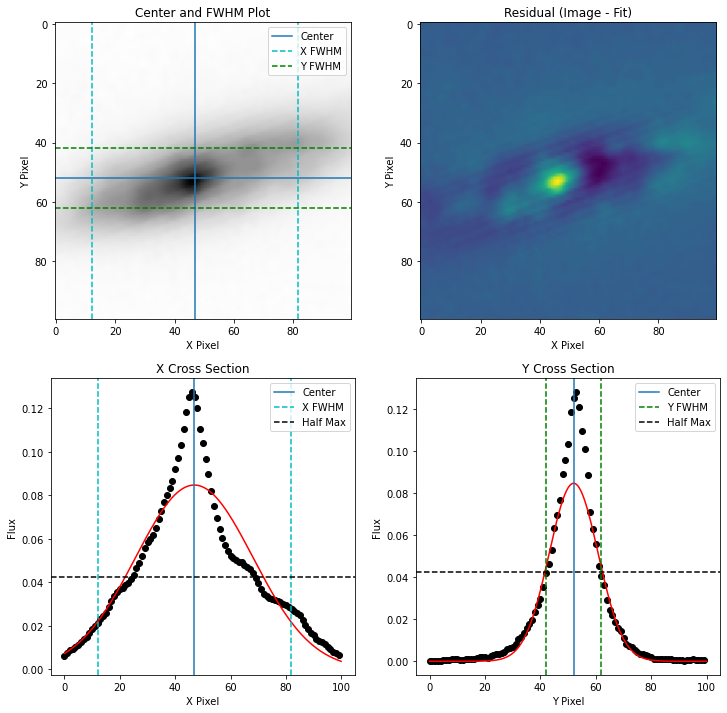

Image Max: 0.03721156343817711
Amplitude: 0.03015291670232413
Center: (50.997946865241104, 50.67760656340448)
Sigma = (5.049271307904889, 5.7449627541420485)
Mean FWHM: 13 Pix 
FWHM: (x=11.890125288654072, y=13.528353451409906) Pix 


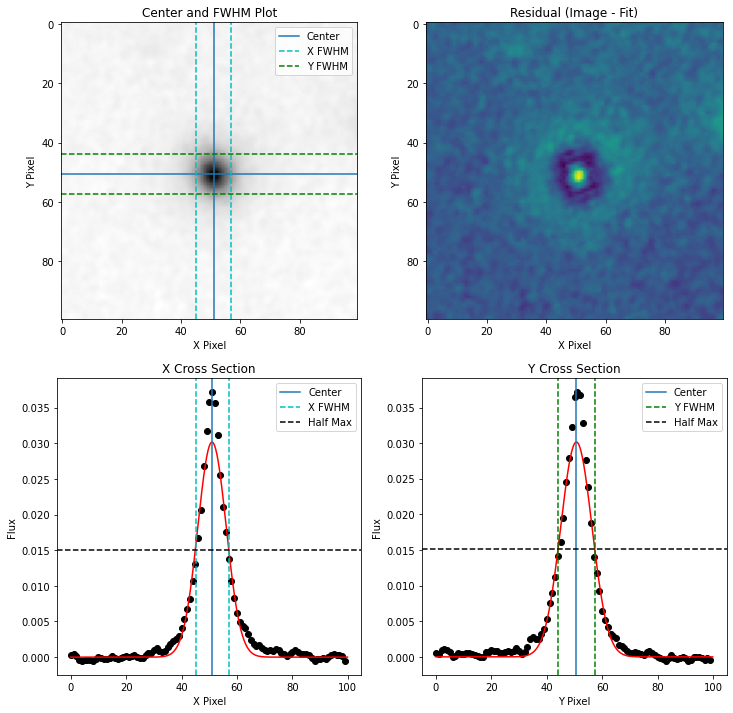

Image Max: 0.015677986666560173
Amplitude: 0.015624714089890055
Center: (50.67600707972738, 50.534421565090724)
Sigma = (3.277891736292396, 7.077757784056735)
Mean FWHM: 12 Pix 
FWHM: (x=7.7188451660626365, y=16.666845903770632) Pix 


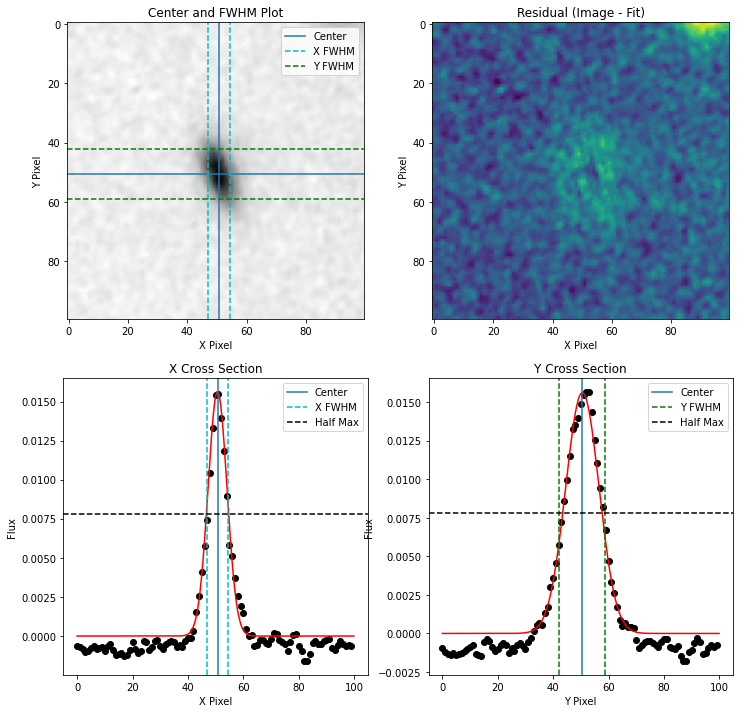

Image Max: 0.01025237888097763
Amplitude: 0.008852164646066005
Center: (50.79613480247285, 51.4708871567453)
Sigma = (8.56775288047834, 10.232713996032896)
Mean FWHM: 22 Pix 
FWHM: (x=20.17551622382205, y=24.09620003292701) Pix 


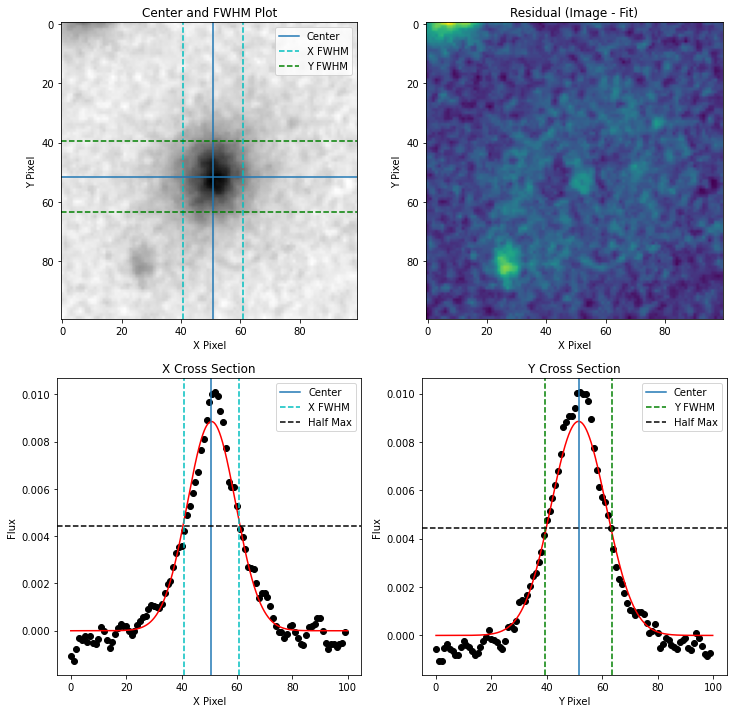

Image Max: 0.6479021906852722
Amplitude: 0.3382811754852297
Center: (52.093444967300755, 50.27426898116194)
Sigma = (9.38571506593948, 13.113645559888798)
Mean FWHM: 26 Pix 
FWHM: (x=22.101669974223267, y=30.88027542785725) Pix 


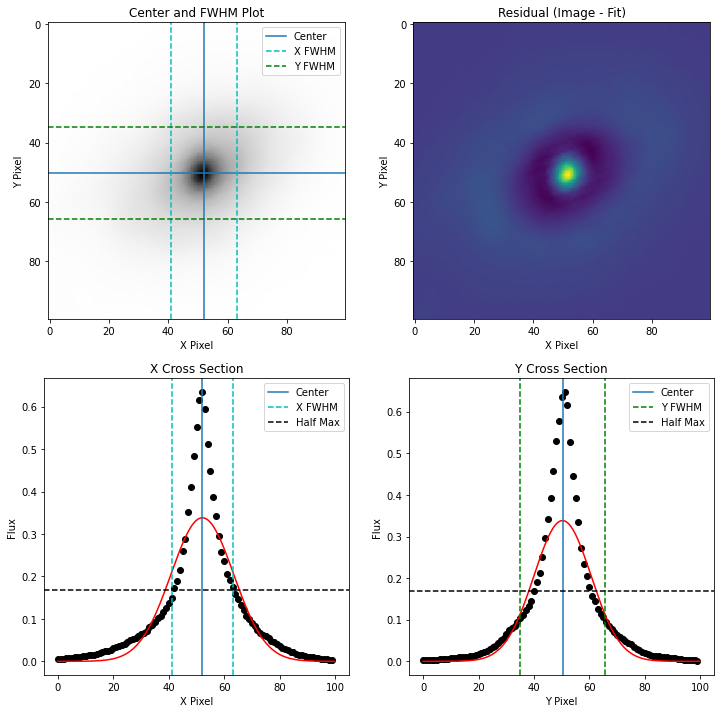

In [77]:
for obj in cat[:10]:
    x, y = np.transpose((obj.xcentroid.value, obj.ycentroid.value)).astype(int)
    temp = cutout(image, x, y, 100)
    
    try:
        measure_fwhm(temp)
    except Exception as e:
        print(e)

In [25]:
def fit_sersic2d(image, amplitude=None, r_eff=None, n=1, ellip=0.5, theta=0, fixed={}, bounds={}):
    
    # Estimate center of target
    y_mean, x_mean = np.array(image.shape) // 2  # Center guess

    # Make x and y grid to fit to
    y_arange, x_arange = np.mgrid[:image.shape[0], :image.shape[1]]
    
    # inital guesses
    if amplitude is None:
        amplitude=image.max()
        
    if r_eff is None:
        r_eff=x_mean//4
        
    # Create model to fit
    model = models.Sersic2D(amplitude=amplitude,
                            r_eff=r_eff,
                            n=n,
                            x_0=x_mean,
                            y_0=y_mean,
                            ellip=ellip,
                            theta=theta,
                            fixed=fixed,
                            bounds=bounds,
                            )
    

    # Fit model to grid
    fit = fitting.LevMarLSQFitter()
    fitted_line = fit(model, x_arange, y_arange, image, maxiter=5000, epsilon=1e-20)
    
    return fitted_line, fit

In [26]:
def fit_gaussian2d(image, fixed={}):
    # Estimate center of target
    y_mean, x_mean = np.array(image.shape) // 2  # Center guess

    # Make x and y grid to fit to
    y_arange, x_arange = np.mgrid[:image.shape[0], :image.shape[1]]

    # Create model to fit
    model = models.Gaussian2D(amplitude=image.max(),
                              x_mean=x_mean,
                              y_mean=y_mean,
                              fixed=fixed
                              )
    

    # Fit model to grid
    fit = fitting.LevMarLSQFitter()
    fitted_line = fit(model, x_arange, y_arange, image, maxiter=5000, epsilon=1e-9)

    return fitted_line, fit

In [27]:

def fit_sersic_trapezoiddisk_2d(image, amplitude=None, r_eff=None, n=1, ellip=0.5, theta=0, fixed={}, bounds={}):
    
        
    # Estimate center of target
    y_mean, x_mean = np.array(image.shape) // 2  # Center guess

    # Make x and y grid to fit to
    y_arange, x_arange = np.mgrid[:image.shape[0], :image.shape[1]]
    
    # inital guesses
    if amplitude is None:
        amplitude=image.max()
        
    if r_eff is None:
        r_eff=x_mean//4
        
    # Create model to fit
    model1 = models.Sersic2D(amplitude=amplitude,
                            r_eff=r_eff,
                            n=n,
                            x_0=x_mean,
                            y_0=y_mean,
                            ellip=ellip,
                            theta=theta,
                            fixed=fixed,
                            bounds=bounds,
                            )
    
    model2 = models.TrapezoidDisk2D(amplitude=amplitude/4.,
                                    x_0=x_mean,
                                    y_0=y_mean,
                                    R_0=model1.r_eff,
                                    slope=1.0
                              )
    model = model1 + model2

    # Fit model to grid
    fit = fitting.LevMarLSQFitter()
    fitted_line = fit(model, x_arange, y_arange, image, maxiter=1000, epsilon=1e-20)
    
    fitted_line.x_0 = fitted_line.x_0_0
    fitted_line.y_0 = fitted_line.y_0_0

    return fitted_line, fit

In [28]:

def fit_trapezoiddisk2d(image, amplitude=None, r_eff=None, n=1, ellip=0.5, theta=0, fixed={}, bounds={}):
    
        
    # Estimate center of target
    y_mean, x_mean = np.array(image.shape) // 2  # Center guess

    # Make x and y grid to fit to
    y_arange, x_arange = np.mgrid[:image.shape[0], :image.shape[1]]
    
    # inital guesses
    if amplitude is None:
        amplitude=image.max()
        
    if r_eff is None:
        r_eff=x_mean//4
    
    model = models.TrapezoidDisk2D(amplitude=amplitude/4.,
                                    x_0=x_mean,
                                    y_0=y_mean,
                                    R_0=r_eff,
                                    slope=1.0
                              )
   
    # Fit model to grid
    fit = fitting.LevMarLSQFitter()
    fitted_line = fit(model, x_arange, y_arange, image, maxiter=1000, epsilon=1e-20)
    

    return fitted_line, fit

In [29]:
class Exponential2d(functional_models.Fittable2DModel):
    amplitude = Parameter(default=1)
    r_eff = Parameter(default=1)
    x_0 = Parameter(default=0)
    y_0 = Parameter(default=0)
    ellip = Parameter(default=0)
    theta = Parameter(default=0)
    _gammaincinv = None
    
    @classmethod
    def evaluate(cls, x, y, amplitude, r_eff, x_0, y_0, ellip, theta):
        """Two dimensional Sersic profile function."""

        if cls._gammaincinv is None:
            try:
                from scipy.special import gammaincinv
                cls._gammaincinv = gammaincinv
            except ValueError:
                raise ImportError('Sersic2D model requires scipy > 0.11.')
    
        a, b = r_eff, (1 - ellip) * r_eff
        cos_theta, sin_theta = np.cos(theta), np.sin(theta)
        x_maj = (x - x_0) * cos_theta + (y - y_0) * sin_theta
        x_min = -(x - x_0) * sin_theta + (y - y_0) * cos_theta
        z = np.sqrt((x_maj / a) ** 2 + (x_min / b) ** 2)

        return amplitude * np.exp(-z)
    
    @property
    def input_units(self):
        if self.x_0.unit is None:
            return None
        return {'x': self.x_0.unit,
                'y': self.y_0.unit}
    
    def _parameter_units_for_data_units(self, inputs_unit, outputs_unit):
        # Note that here we need to make sure that x and y are in the same
        # units otherwise this can lead to issues since rotation is not well
        # defined.
        if inputs_unit['x'] != inputs_unit['y']:
            raise UnitsError("Units of 'x' and 'y' inputs should match")
        return {'x_0': inputs_unit['x'],
                'y_0': inputs_unit['x'],
                'r_eff': inputs_unit['x'],
                'theta': u.rad,
                'amplitude': outputs_unit['z']}
    

In [30]:
def fit_double_sersic2d(image, amplitude=None, r_eff=None, n=0.5, ellip=0., theta=0, fixed={}, bounds={}, model1=None):
    
    #################################
    # Estimate center of target
    y_mean, x_mean = np.array(image.shape) // 2  # Center guess

    # Make x and y grid to fit to
    y_arange, x_arange = np.mgrid[:image.shape[0], :image.shape[1]]
    
    # inital guesses
    if amplitude is None:
        amplitude=image.max()
        
    if r_eff is None:
        r_eff=x_mean//4
        
    # Create model to fit
    model2 = models.Sersic2D(amplitude=amplitude,
                            r_eff=r_eff,
                            n=n,
                            x_0=x_mean,
                            y_0=y_mean,
                            ellip=ellip,
                            theta=theta,
                            #fixed=fixed,
                            bounds=bounds,
                            )
    """
    
    
    model2 = Exponential2d(
        amplitude=amplitude,
        r_eff=r_eff, 
        x_0=x_mean,
        y_0=y_mean,
        fixed=fixed,
        ellip=0.5,
        theta=theta,
        bounds=bounds,
    )
    
    """


    model = model1 + model2

    # Fit model to grid
    fit = fitting.LevMarLSQFitter()
    fitted_line = fit(model, x_arange, y_arange, image, maxiter=5000, epsilon=1e-20)
    
    fitted_line.x_0 = fitted_line.x_0_0
    fitted_line.y_0 = fitted_line.y_0_0

    return fitted_line, fit

In [31]:
def fit_sersic_gaussian_2d(image, amplitude=None, r_eff=None, n=1, ellip=0.5, theta=0, fixed={}, bounds={}):
    
        
    # Estimate center of target
    y_mean, x_mean = np.array(image.shape) // 2  # Center guess

    # Make x and y grid to fit to
    y_arange, x_arange = np.mgrid[:image.shape[0], :image.shape[1]]
    
    # inital guesses
    if amplitude is None:
        amplitude=image.max()
        
    if r_eff is None:
        r_eff=x_mean//4
        
    # Create model to fit
    model1 = models.Sersic2D(amplitude=amplitude,
                            r_eff=r_eff,
                            n=n,
                            x_0=x_mean,
                            y_0=y_mean,
                            ellip=ellip,
                            theta=theta,
                            fixed=fixed,
                            bounds=bounds,
                            )
    
    model2 = models.Gaussian2D(amplitude=image.max()/100.,
                               x_mean=x_mean,
                               y_mean=y_mean,
                              )
    model = model1 + model2

    # Fit model to grid
    fit = fitting.LevMarLSQFitter()
    fitted_line = fit(model, x_arange, y_arange, image, maxiter=1000, epsilon=1e-20)
    
    fitted_line.x_0 = fitted_line.x_0_0
    fitted_line.y_0 = fitted_line.y_0_0

    return fitted_line, fit

In [32]:
def fit_model(image, model):
    # Make x and y grid to fit to
    y_arange, x_arange = np.mgrid[:image.shape[0], :image.shape[1]]
    
    # Fit model to grid
    fit = fitting.LevMarLSQFitter()
    fitted_line = fit(model, x_arange, y_arange, image, maxiter=10000, epsilon=1e-20)

    return fitted_line, fit

In [33]:
def model_subtract(image, target, x, y):
    dy, dx = target.shape
    bounds = np.array([y - dy // 2, y + dy // 2, x - dx // 2, x + dx // 2])
    #bounds[bounds < 0] = 0
    ymin, ymax, xmin, xmax = bounds

    targ_xmin = None
    if xmin < 0:
        targ_xmin = abs(xmin)
        xmin = 0

    targ_ymin = None
    if ymin < 0:
        targ_ymin = abs(ymin)
        ymin = 0

    targ_xmax = None
    if xmax >= image.shape[1]:
        targ_xmax = image.shape[1] - x + target.shape[1]//2
        xmax = image.shape[1]

    targ_ymax = None
    if ymax >= image.shape[0]:
        targ_ymax = image.shape[0] - y + target.shape[0]//2
        ymax = image.shape[0]
    
    image[ymin:ymax, xmin:xmax] -= target[targ_ymin:targ_ymax, targ_xmin:targ_xmax]

    return image

In [34]:
def find_chi2(image, model):
    image1 = np.clip(image, 1e20, image.max())
    
    y_arange, x_arange = np.mgrid[:image.shape[0], :image.shape[1]]
    image2 = model(x_arange, y_arange)
    image2 = np.clip(image2, 1e20, image2.max())

    diff = abs(image2 - image1)
    y, x = np.array(diff.shape)//2
    #diff[y-3:y+3, x-3:x+3] = 0. 
    return np.mean(100*diff/image1)

In [35]:

def plot_fit(image, model):
    if isinstance(model, models.Sersic2D):
        x_0, y_0 = model.x_0, model.y_0  # Center
    elif isinstance(model, models.Gaussian2D):
        x_0, y_0 = [i.value for i in [model.x_mean, model.y_mean]]
    else:
        x_0, y_0 = model.x_0, model.y_0  # Center

    fig = plt.figure(figsize=(12, 12))

    # Make x and y grid to plot to
    y_arange, x_arange = np.mgrid[:image.shape[0], :image.shape[1]]

    # Plot input image with FWHM and center
    # -------------------------------------
    ax0 = fig.add_subplot(221)

    ax0.imshow(image)
    ax0.axvline(x_0, label="Center")
    ax0.axhline(y_0)

    ax0.set_title("Image")
    ax0.set_xlabel("X Pixel")
    ax0.set_ylabel("Y Pixel")

    ax0.legend()

    # Plot residuals
    # ---------------

    residuals = image - model(x_arange, y_arange)
    residuals[np.where(residuals < 0)] = 0.
    ax1 = fig.add_subplot(222)
    ax1.imshow(residuals)

    ax1.set_title("Residual (Image - Fit)")
    ax1.set_xlabel("X Pixel")
    ax1.set_ylabel("Y Pixel")

    # Prepare fine grid
    # -----------------

    # We need a fine grid to fill in inter-pixel values
    # Oversample by a factor of 10

    y_arange_fine, x_arange_fine = np.mgrid[:image.shape[0] * 10, :image.shape[1] * 10] / 10
    x_slice_fine = model(x_arange_fine[1, :], y_0)
    y_slice_fine = model(np.ones_like(y_arange_fine[:, 1]) * x_0, y_arange_fine[:, 1])

    # Plot X fit
    # ----------

    ax2 = fig.add_subplot(223)

    ax2.plot(x_arange_fine[1, :], x_slice_fine, c='r')
    ax2.scatter(x_arange[1, :], image[int(np.round(y_0)), :], c='black')

    ax2.set_title("X Cross Section")
    ax2.set_xlabel("X Pixel")
    ax2.set_ylabel("Flux")

    # Plot Y fit
    # ----------

    ax3 = fig.add_subplot(224)

    ax3.plot(y_arange_fine[:, 1], y_slice_fine, c='r')
    ax3.scatter(y_arange[:, 1], image[:, int(np.round(x_0))], c='black')

    ax3.set_title("Y Cross Section")
    ax3.set_xlabel("Y Pixel")
    ax3.set_ylabel("Flux")

    return fig, [ax0, ax1, ax2, ax3]


In [36]:
import ipywidgets as widgets
from IPython.display import display

In [37]:
sig3 = np.unique(detect_threshold(image, nsigma=0.))[0]
image = np.clip(image, sig3, image.max())

In [39]:
sig8 = np.unique(detect_threshold(image, nsigma=8.))[0]
sig3 = np.unique(detect_threshold(image, nsigma=3.))[0]

IntProgress(value=0, description='Loading:', max=373)

Label: 400


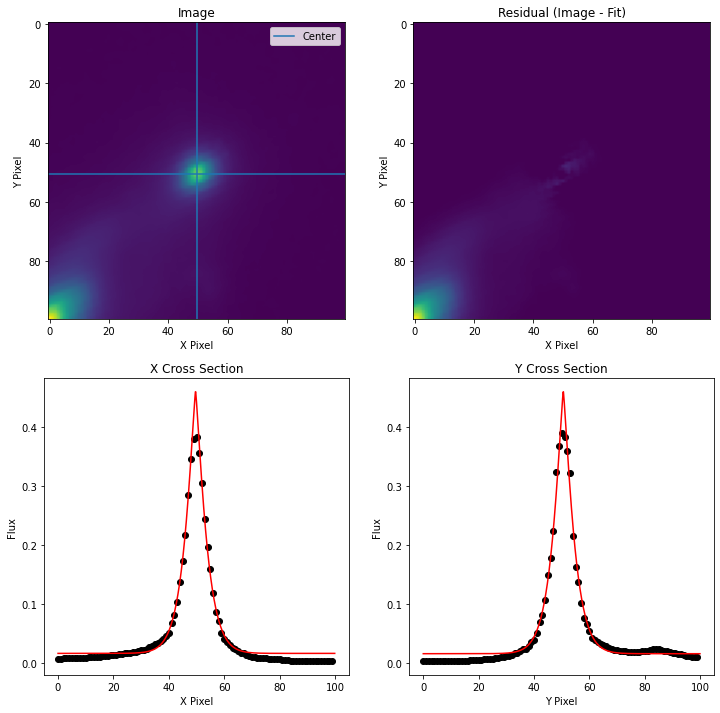

Label: 399


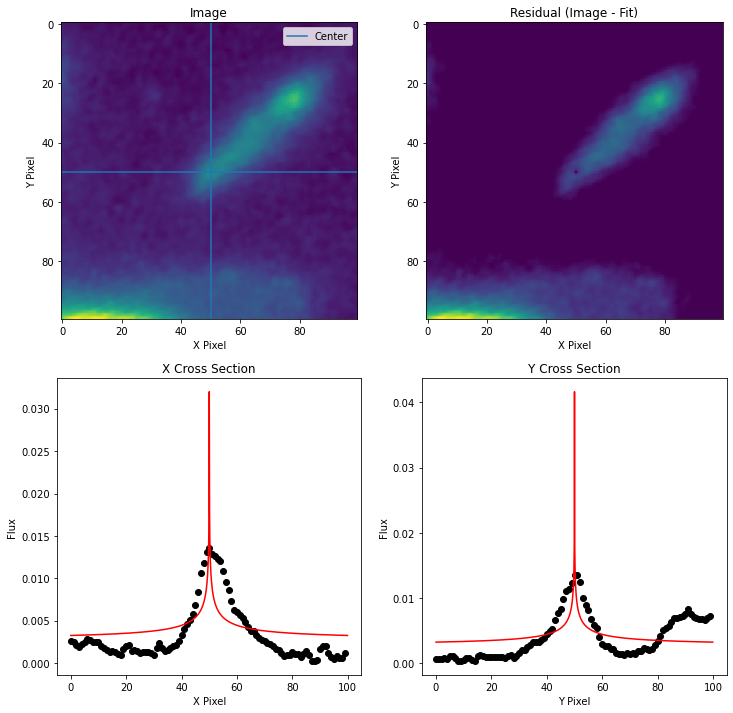

Label: 396


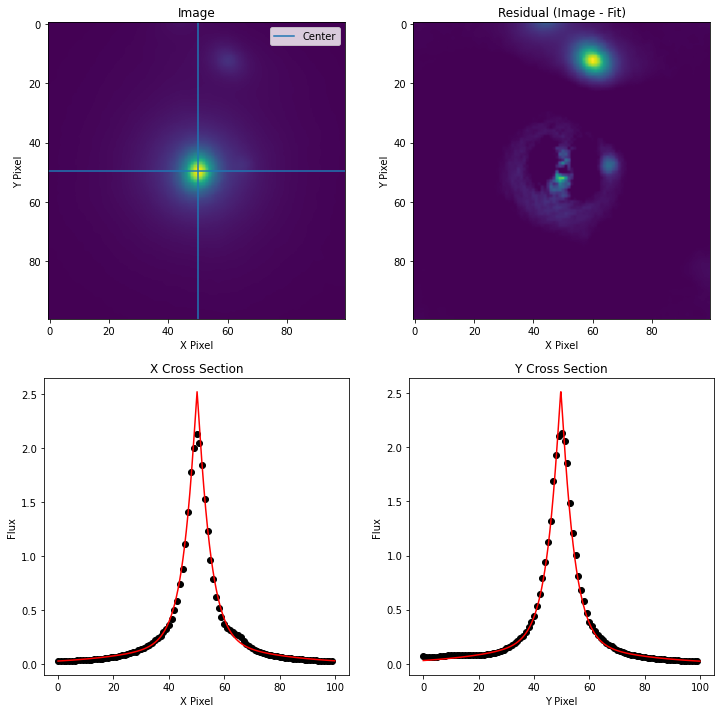

Label: 394


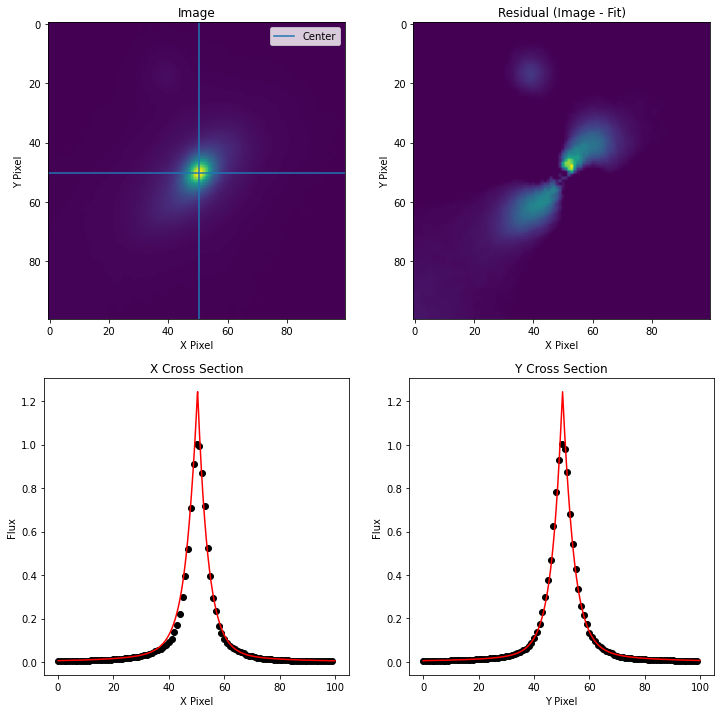

Label: 392


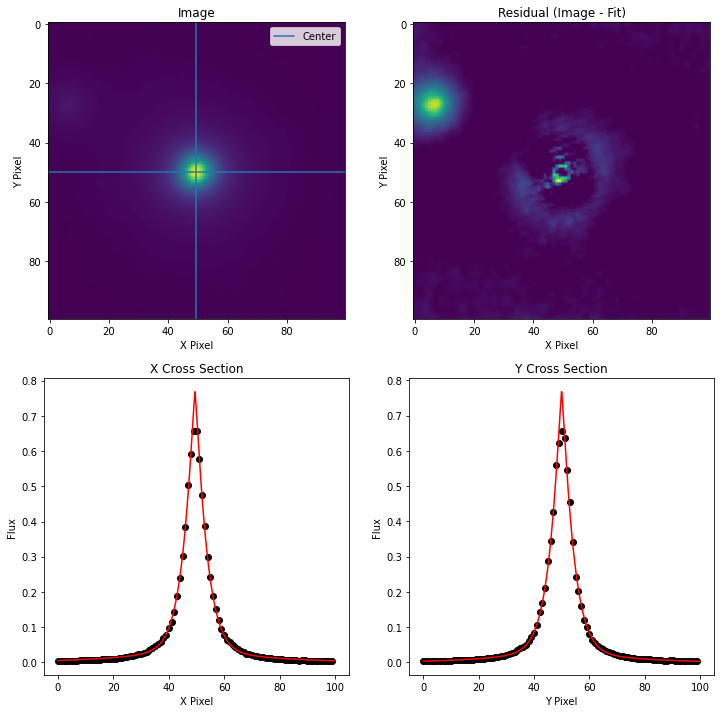

Label: 389


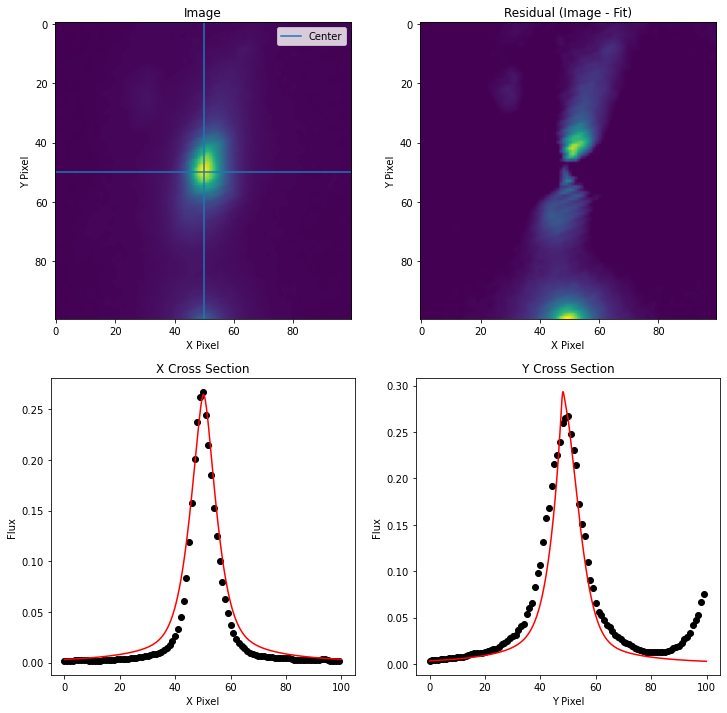

Label: 387


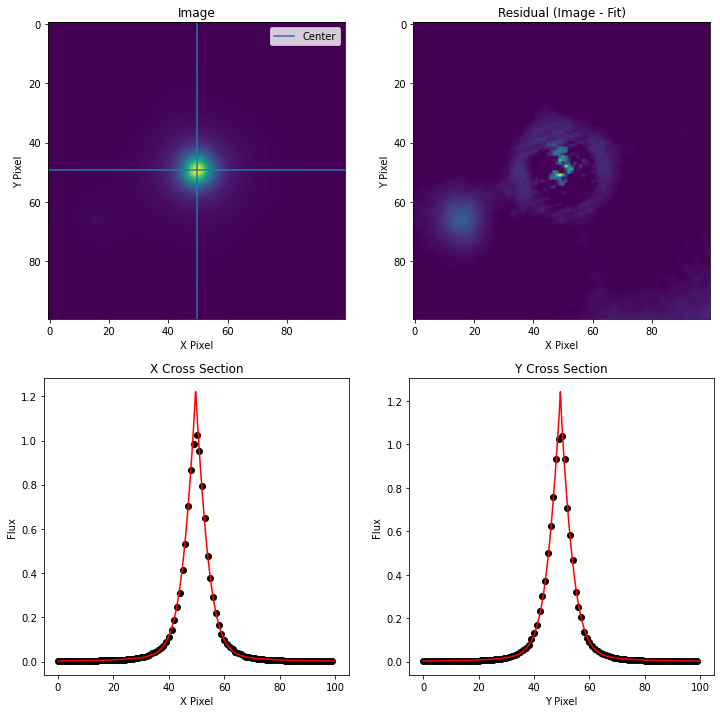

Label: 386


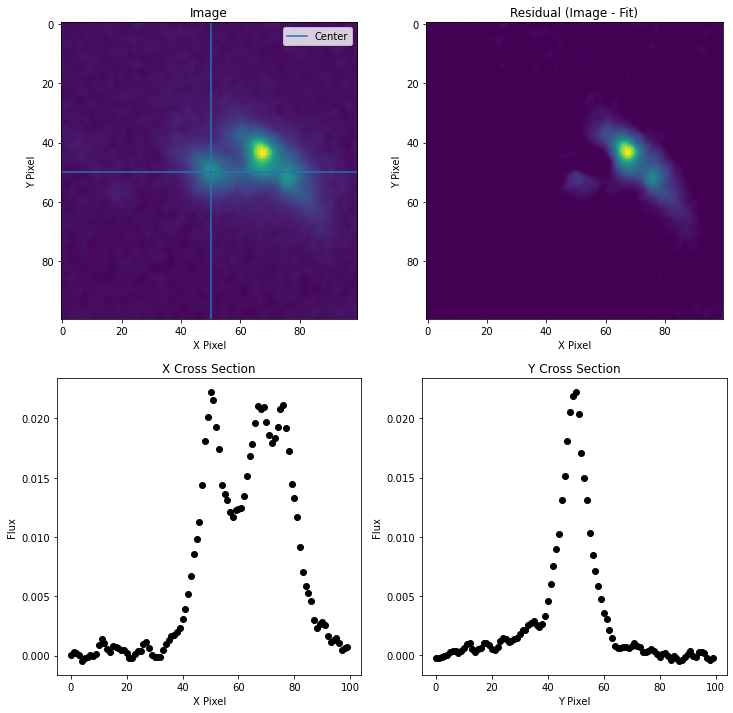

Label: 384


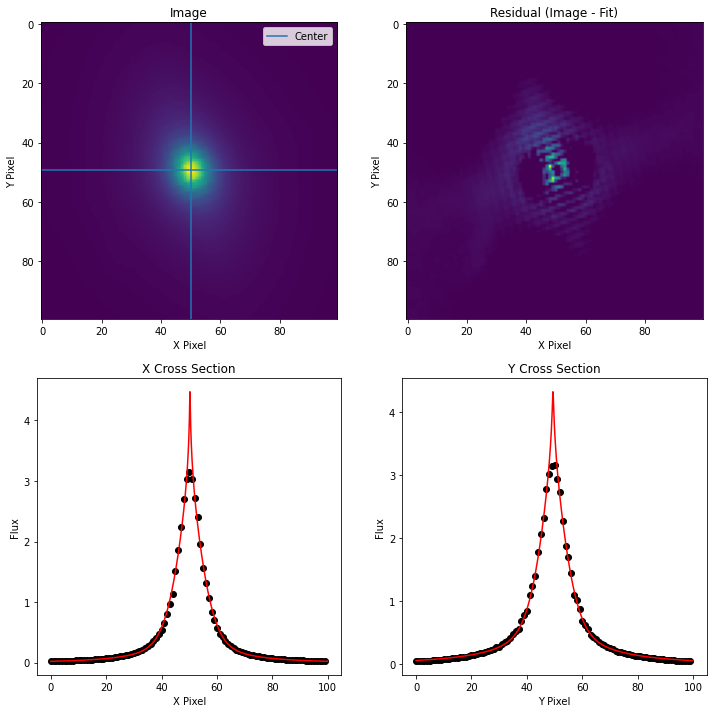

Label: 383


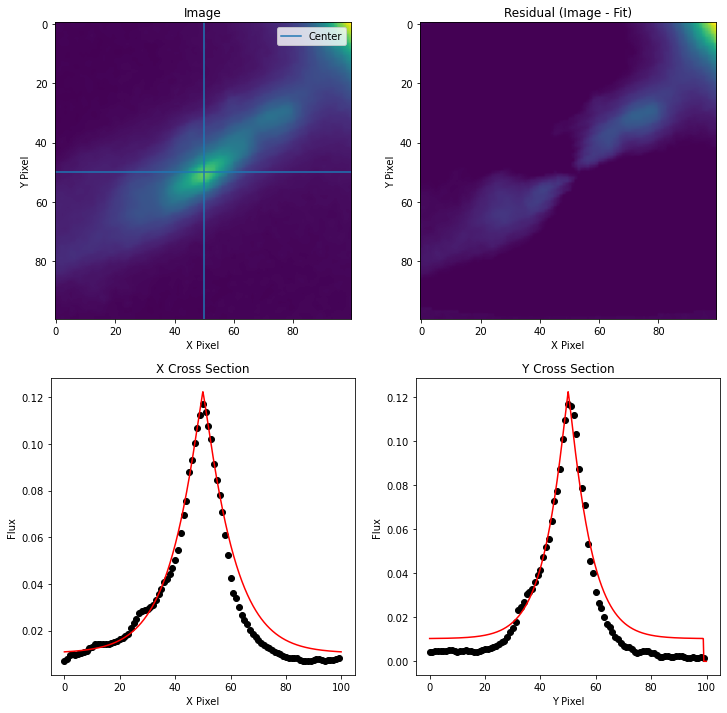

Label: 382


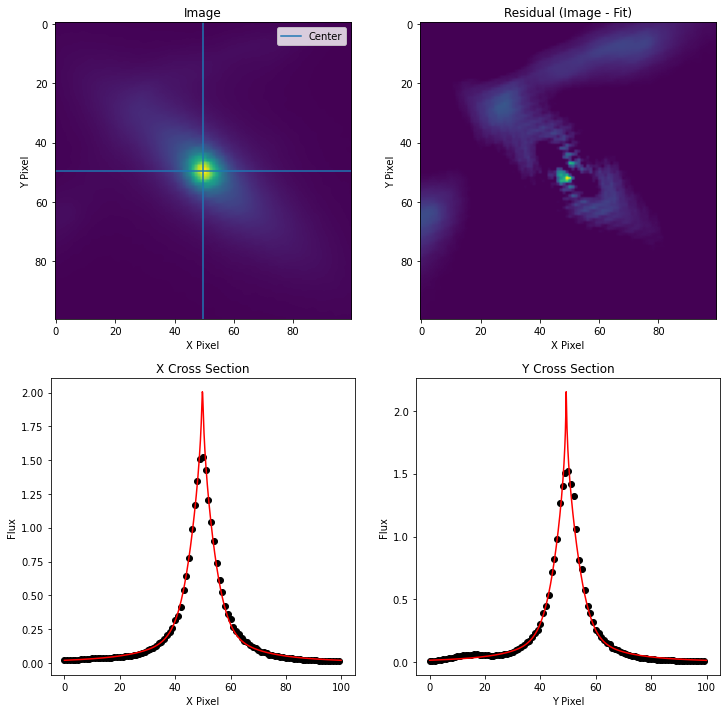

Label: 381


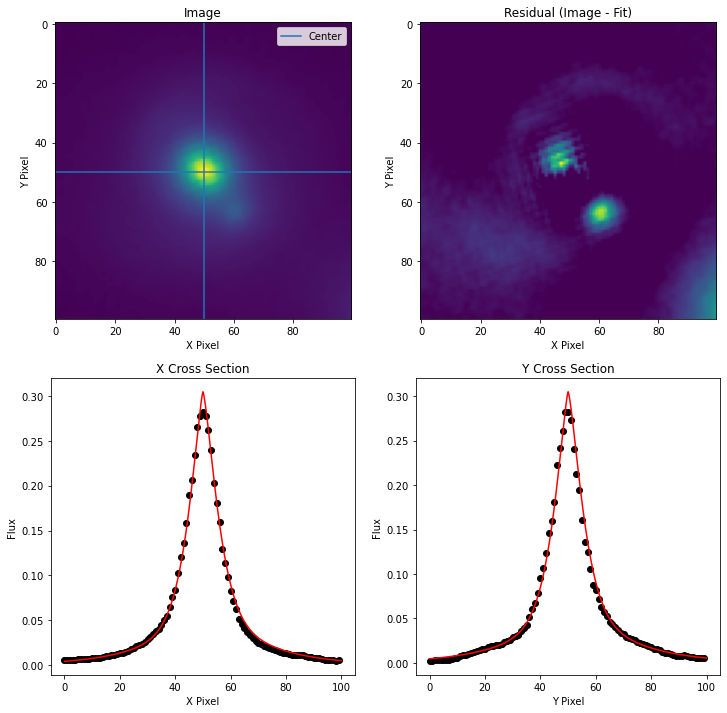

Label: 380


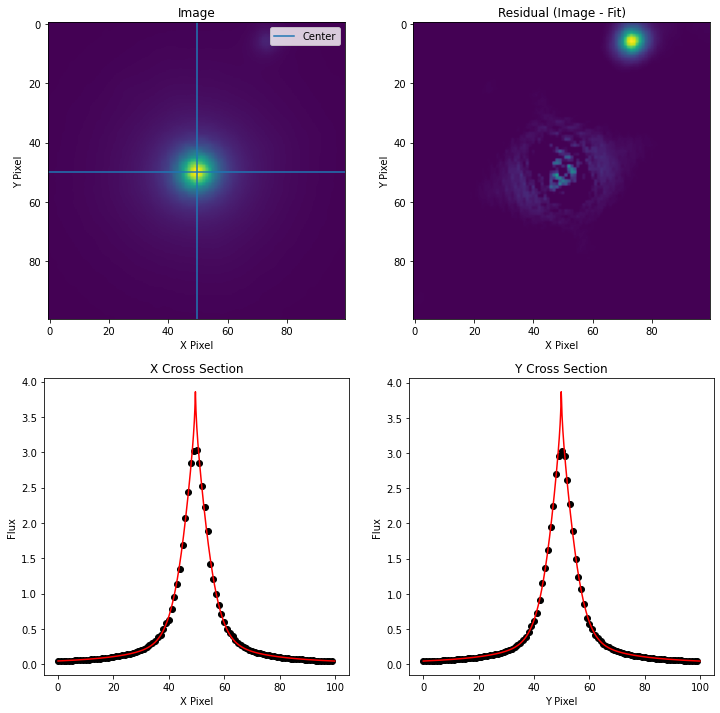

Label: 378


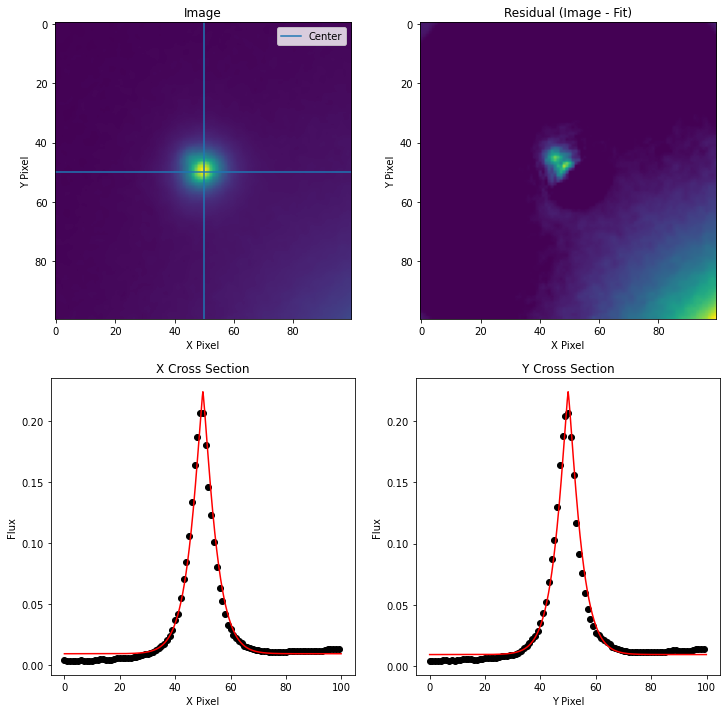

Label: 377


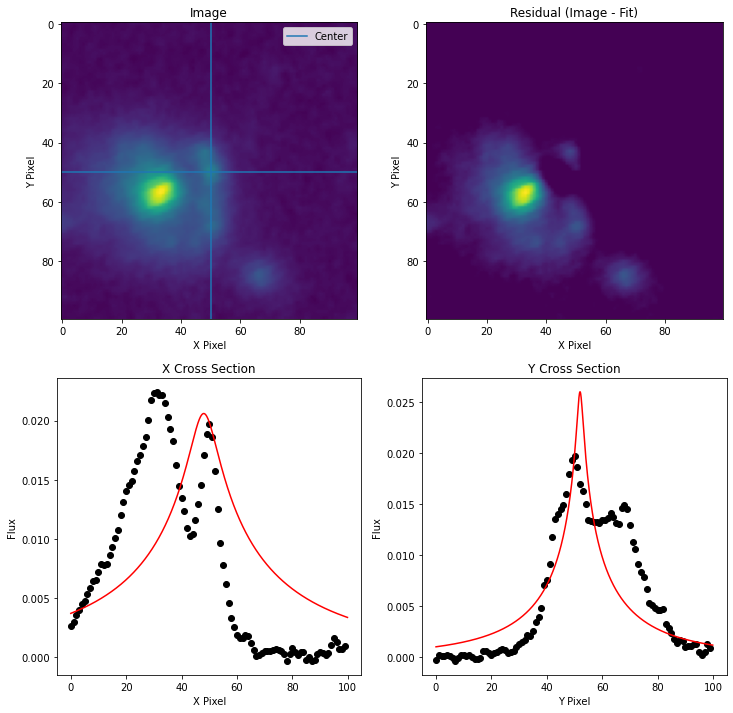

Label: 373


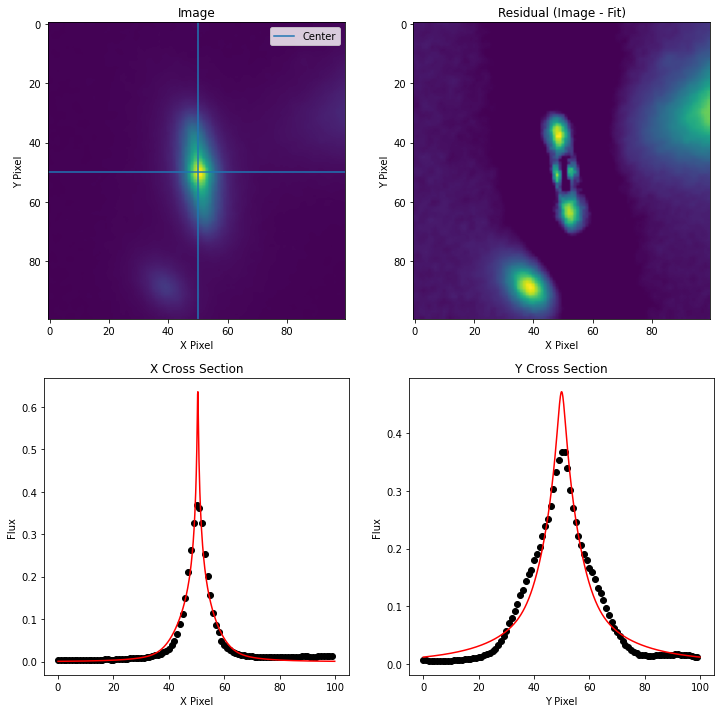

Label: 372


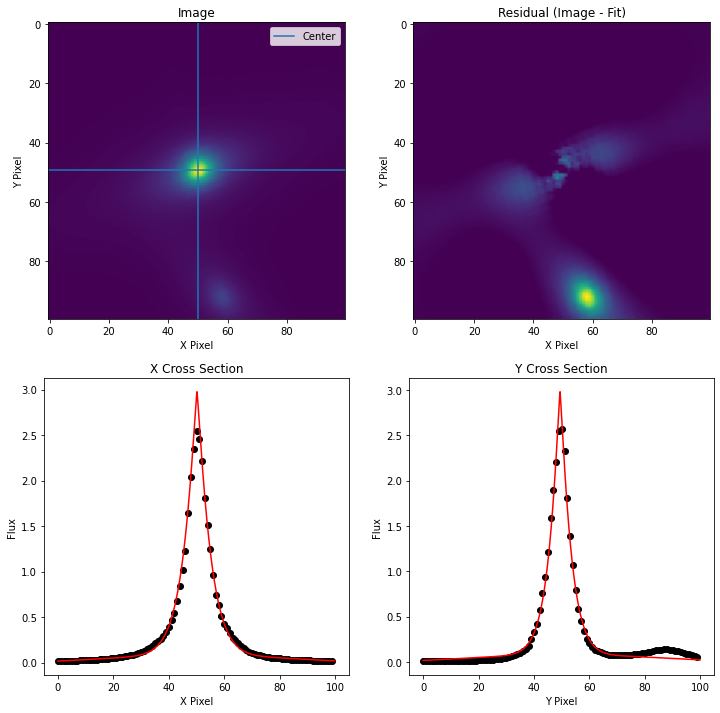

Label: 371


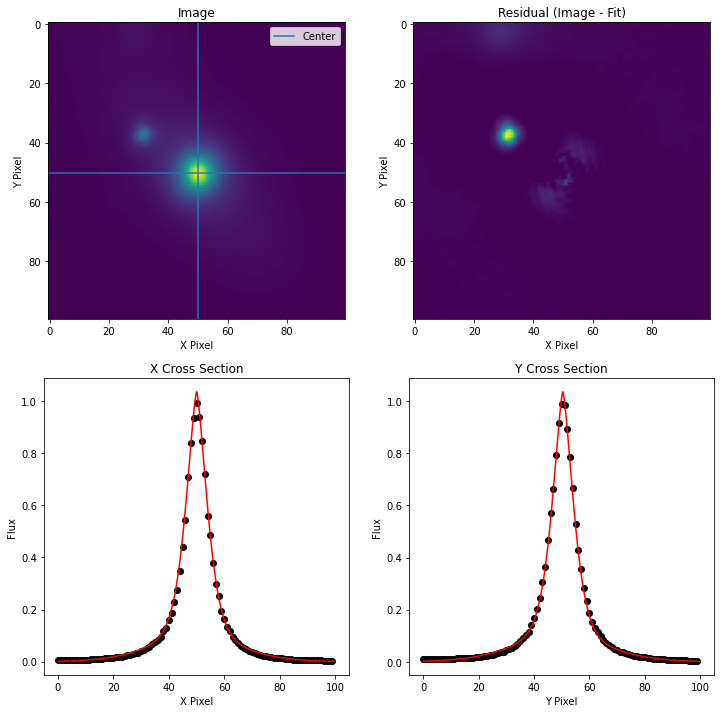

Label: 367


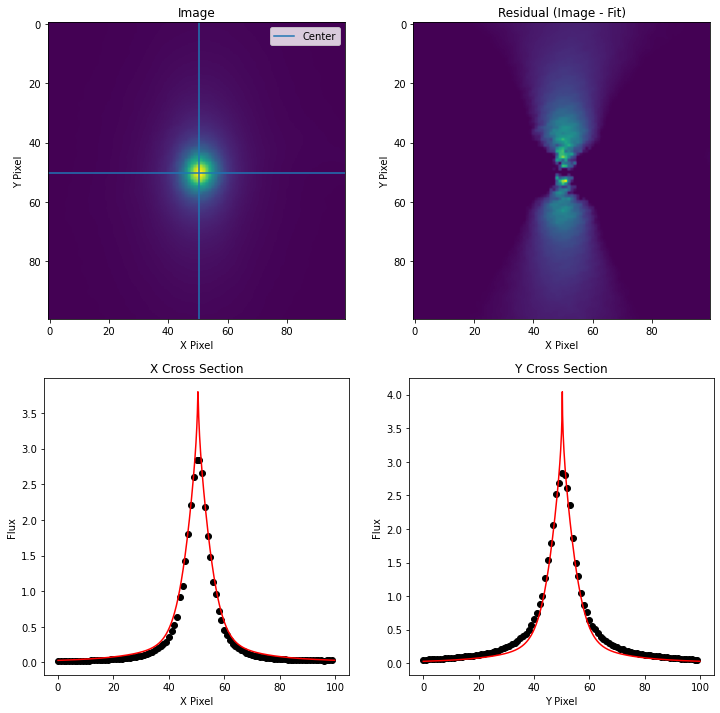

Label: 366


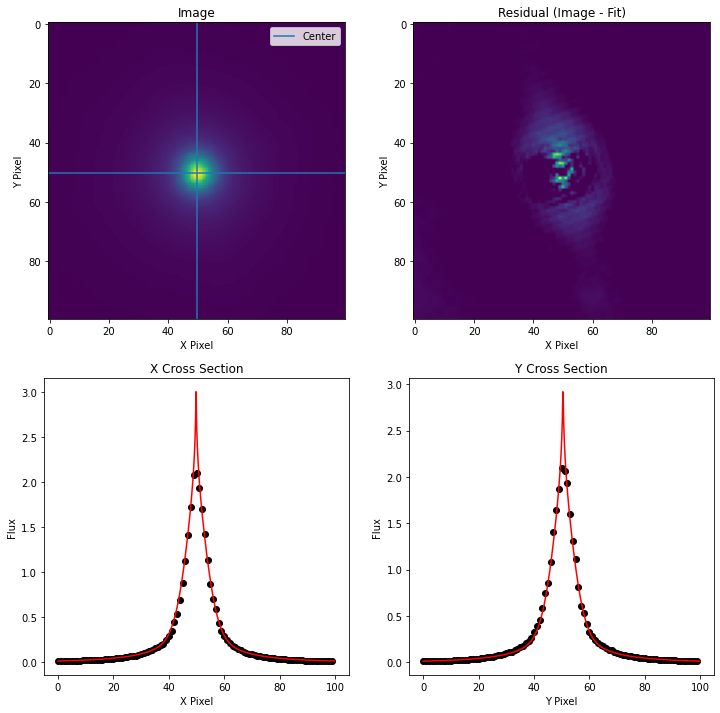

Label: 365


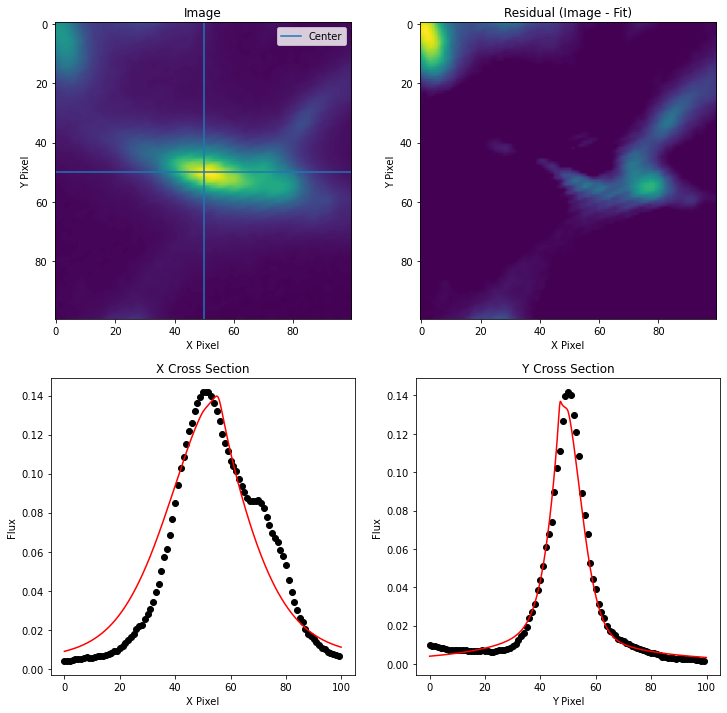

Label: 363


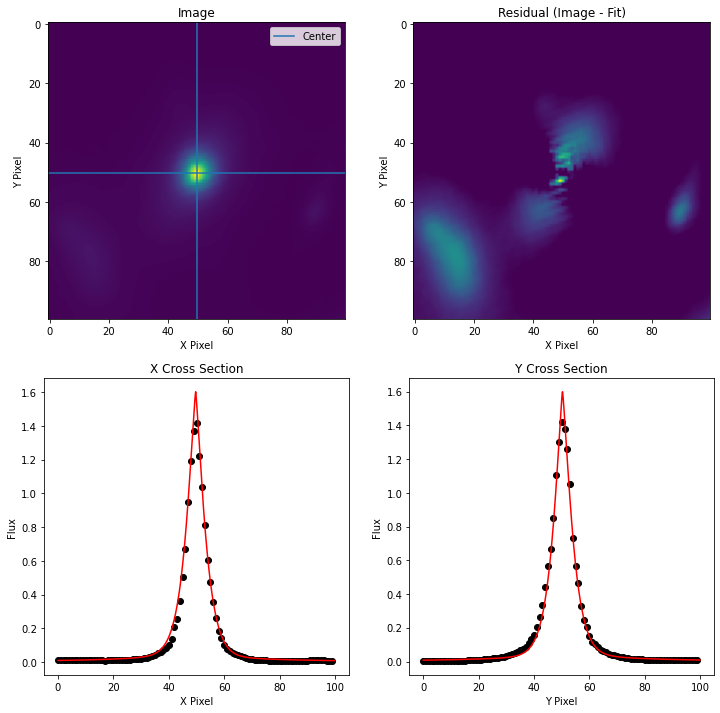

Label: 361


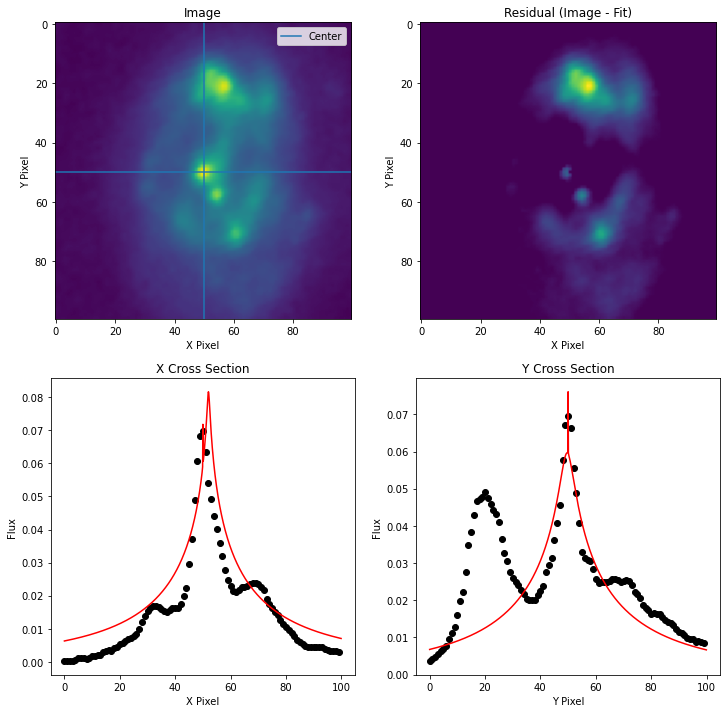

Label: 357


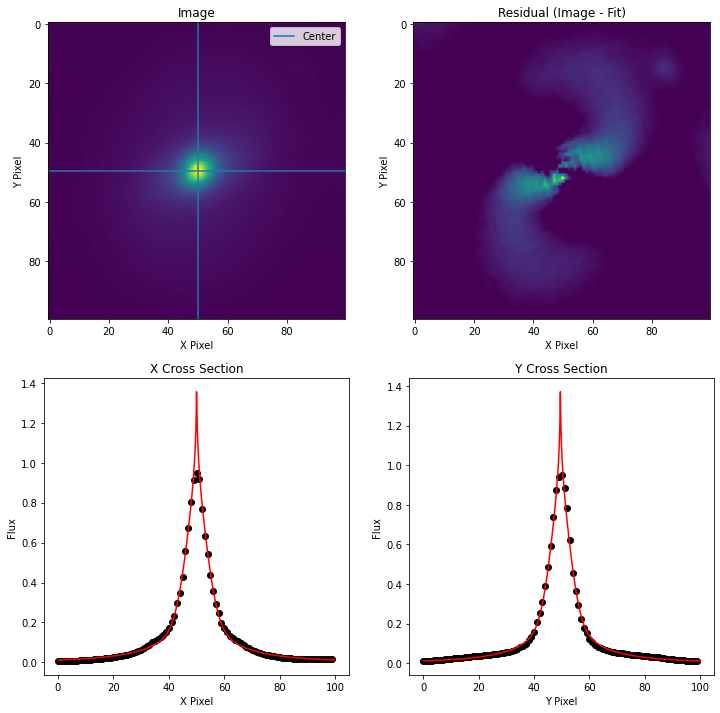

Label: 356


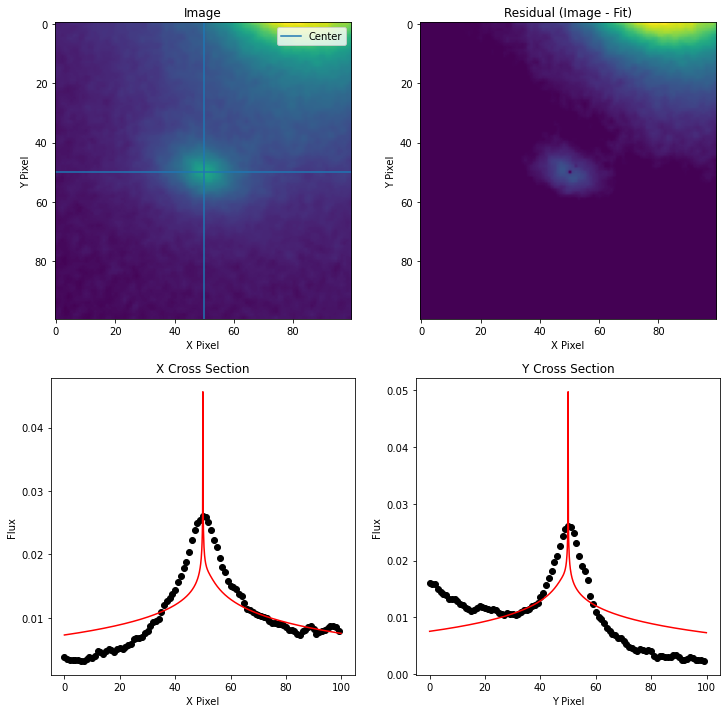

Label: 355


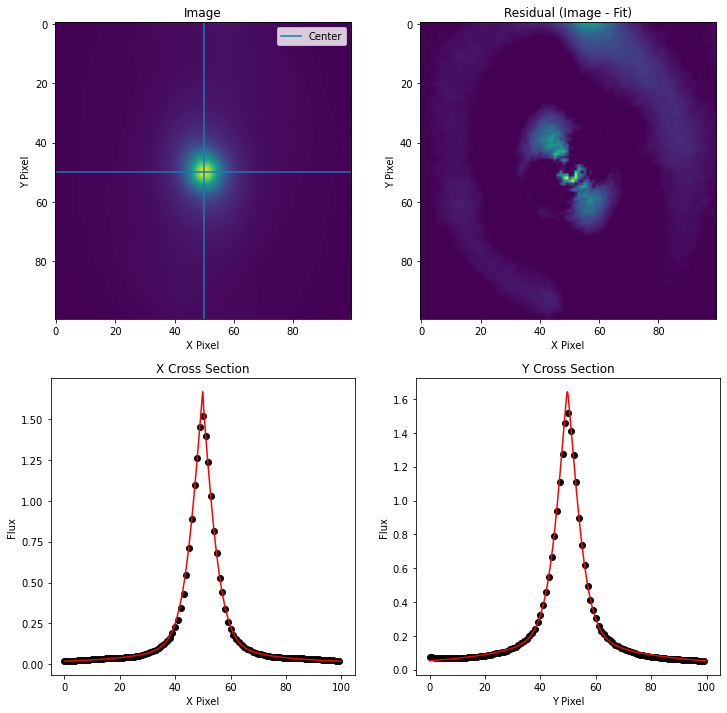

Label: 354


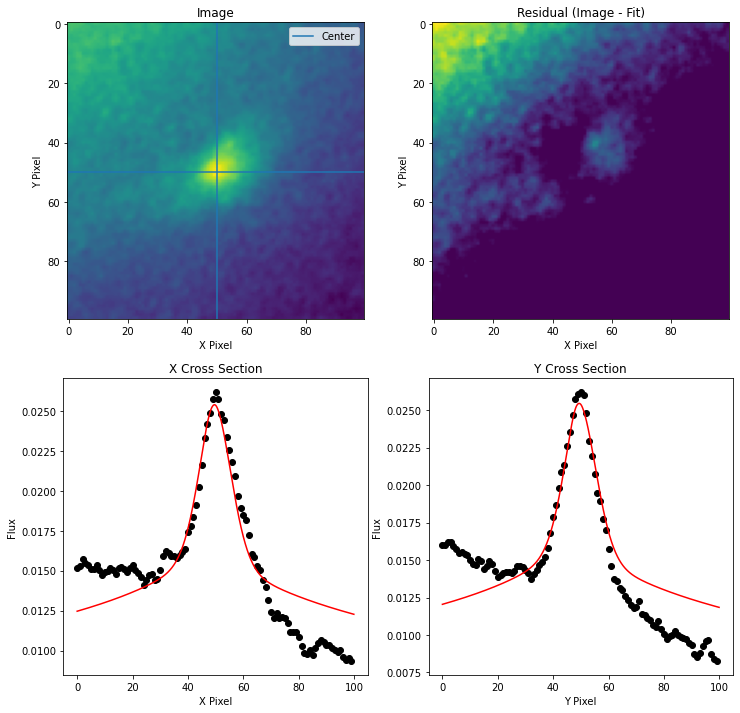

Label: 353


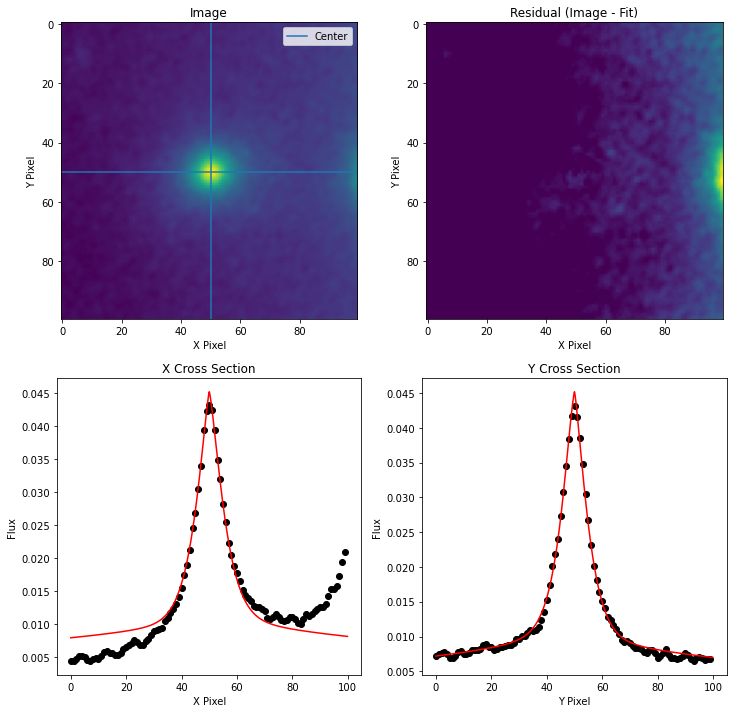

Label: 352


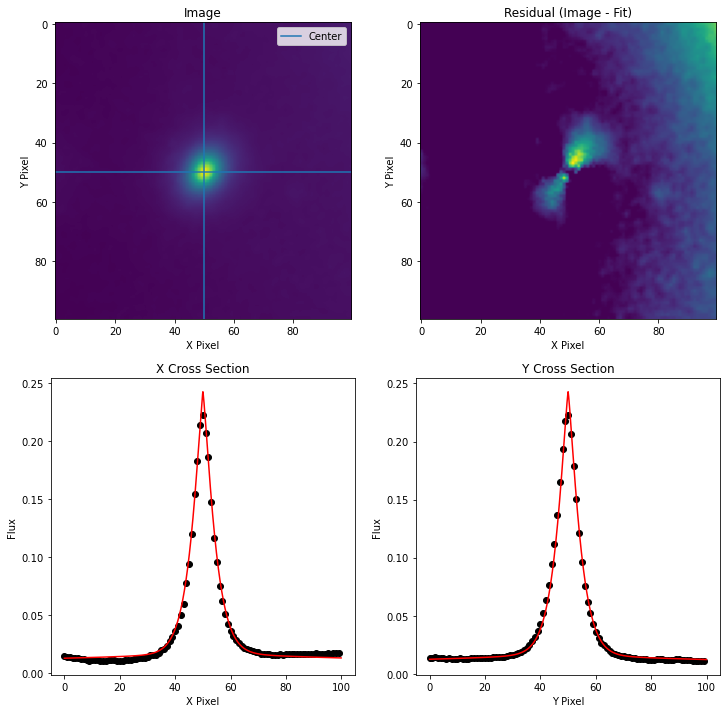

Label: 351


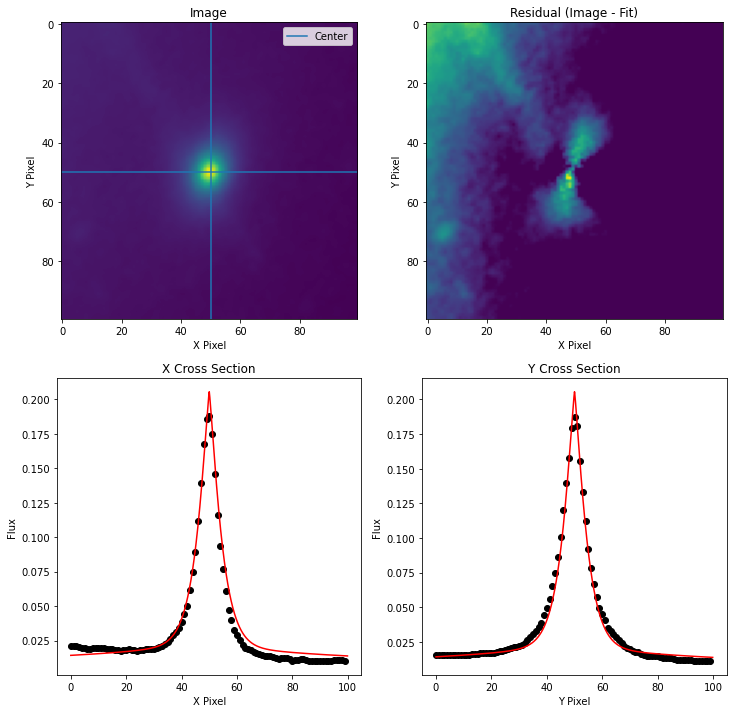

Label: 350


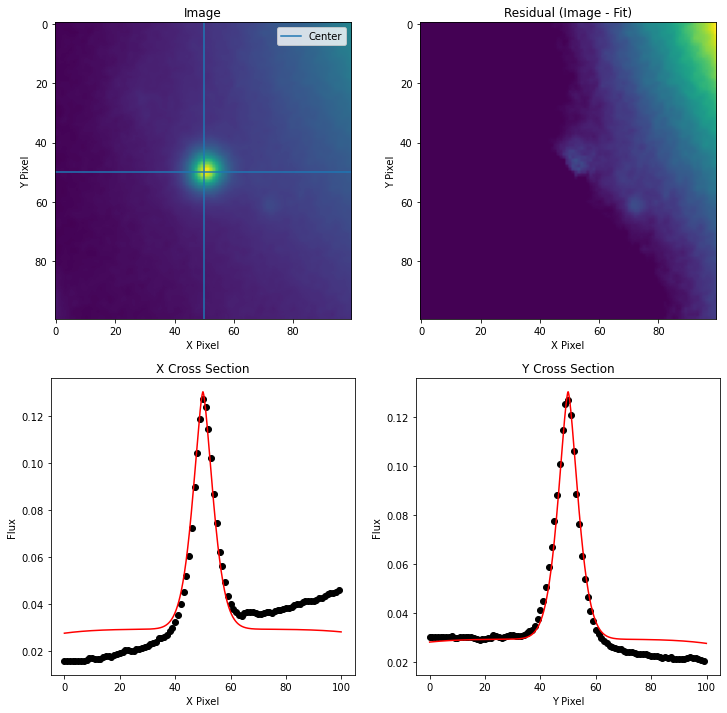

Label: 349


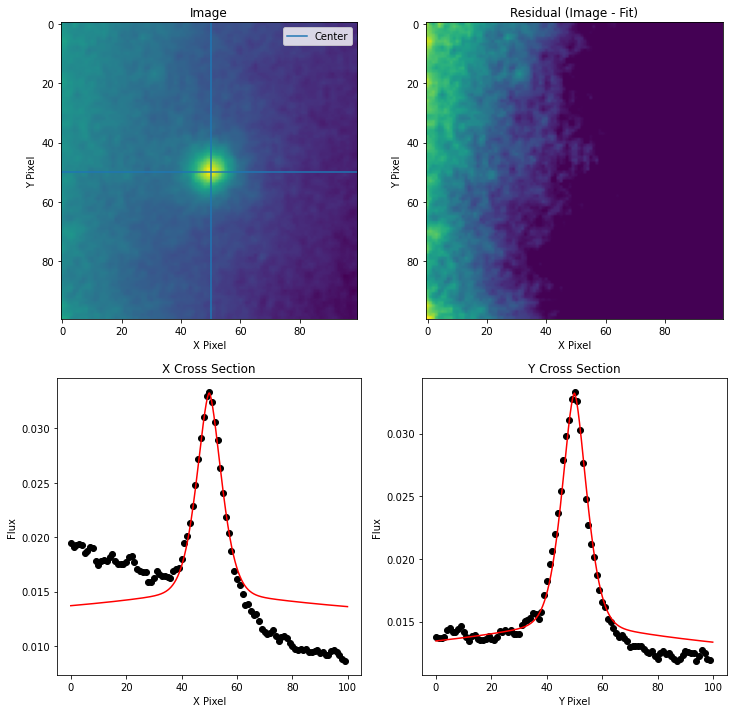

Label: 348


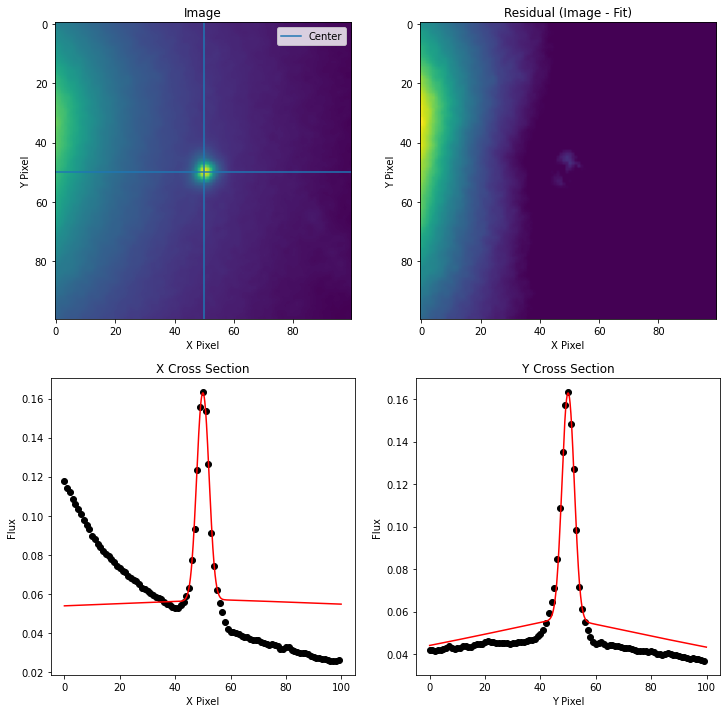

Label: 347


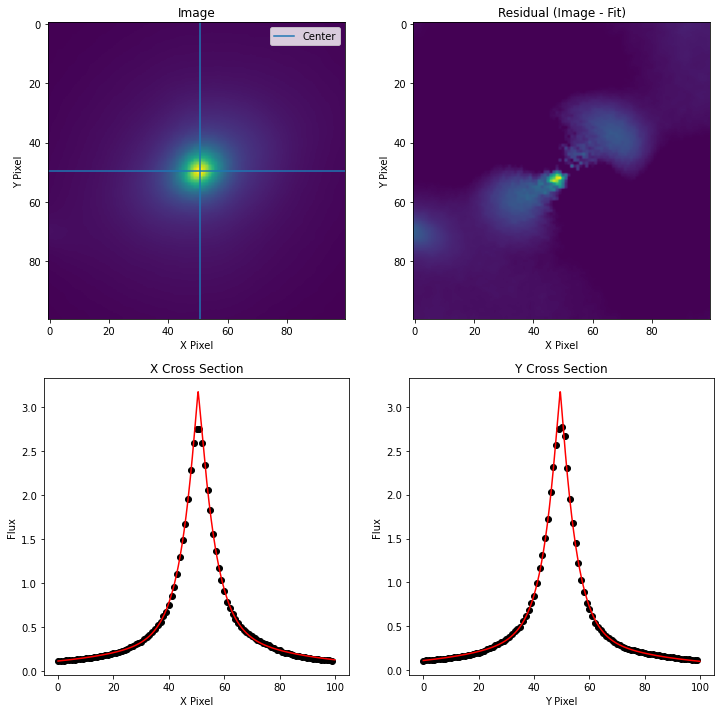

Label: 346


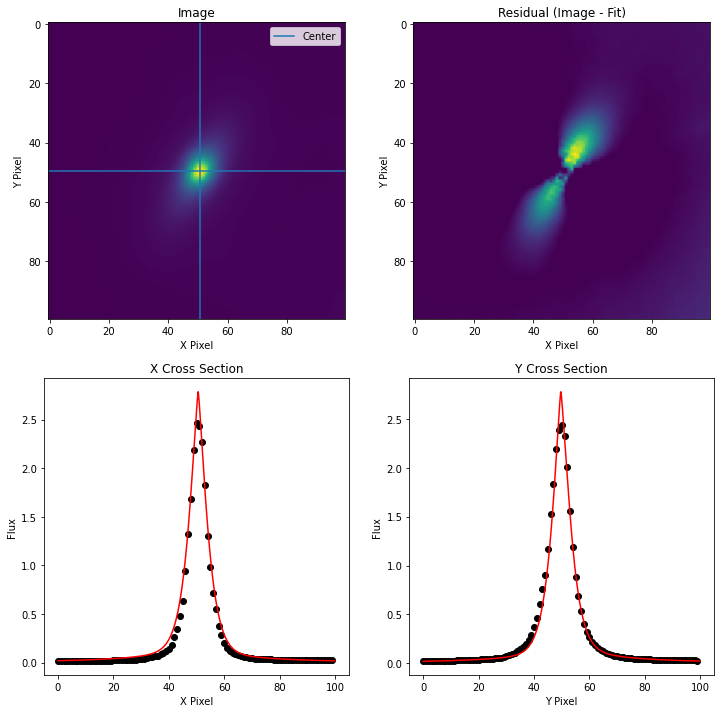

Label: 344


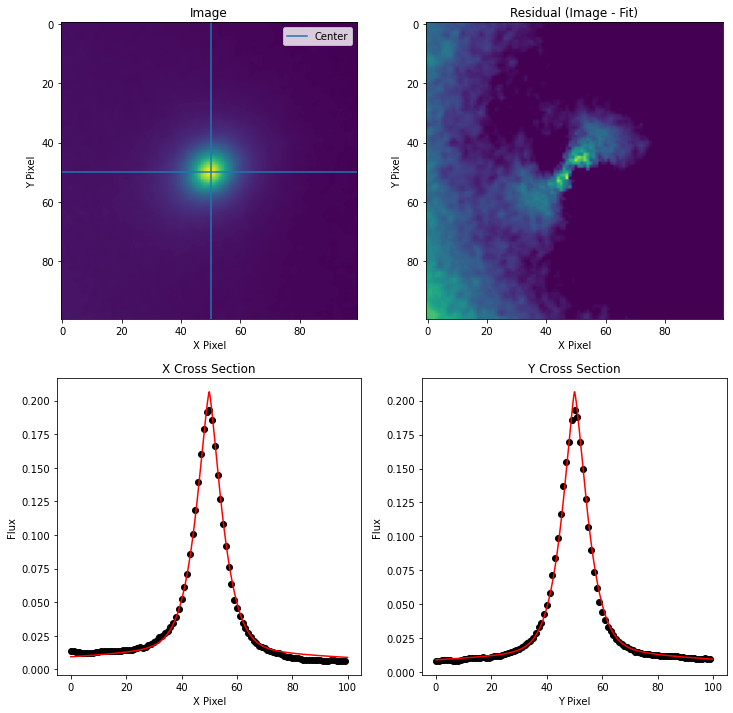

Label: 340


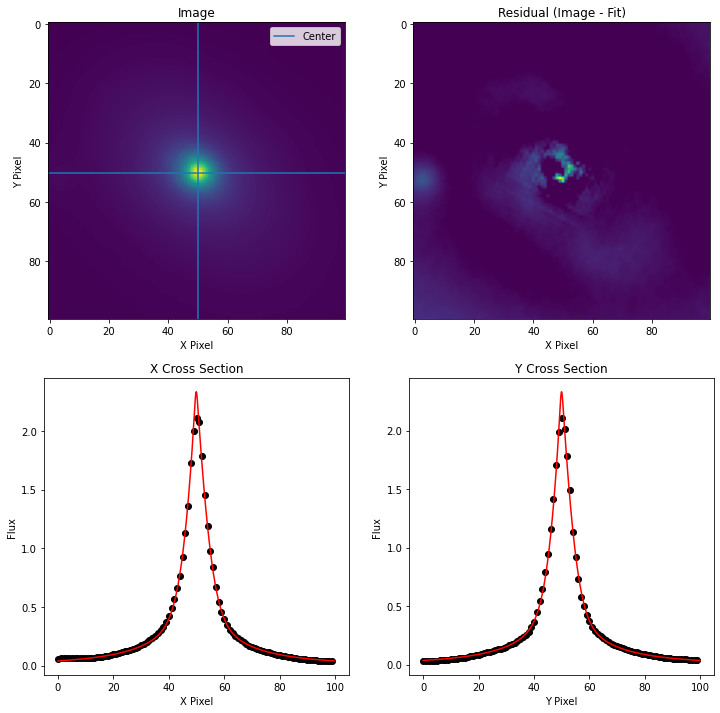

Label: 339


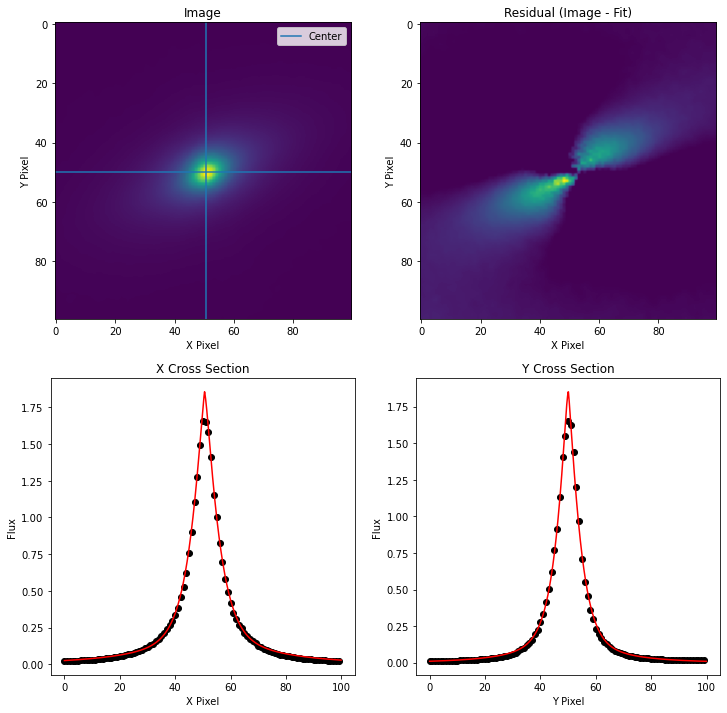

Label: 338


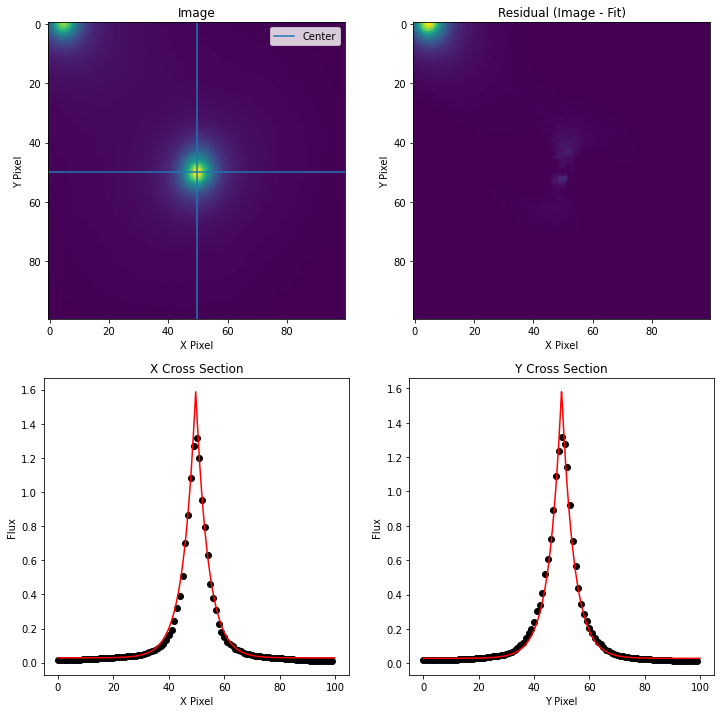

Label: 337


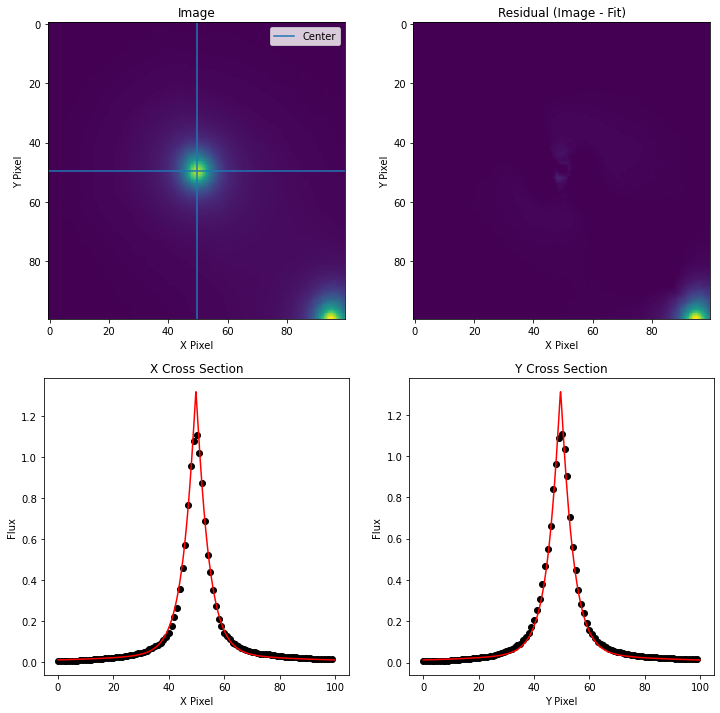

Label: 335


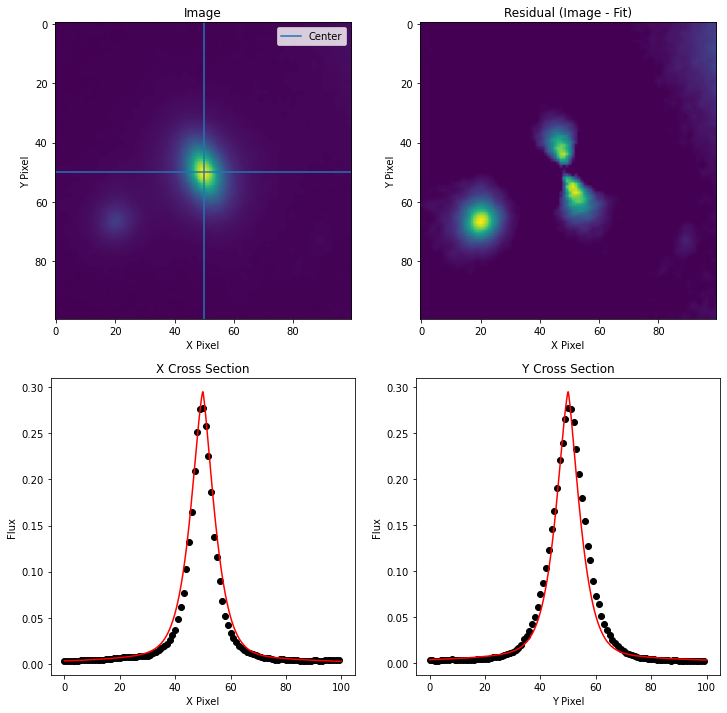

Label: 332


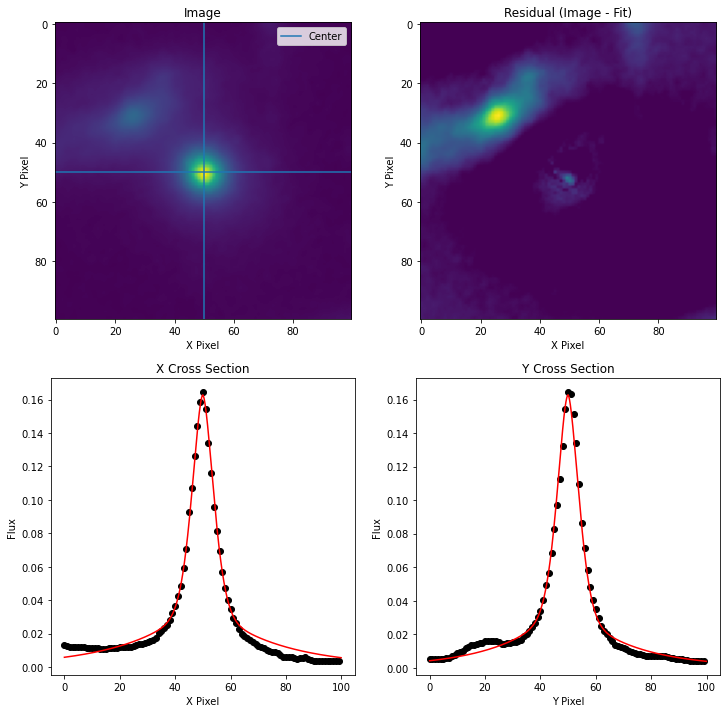

Label: 329


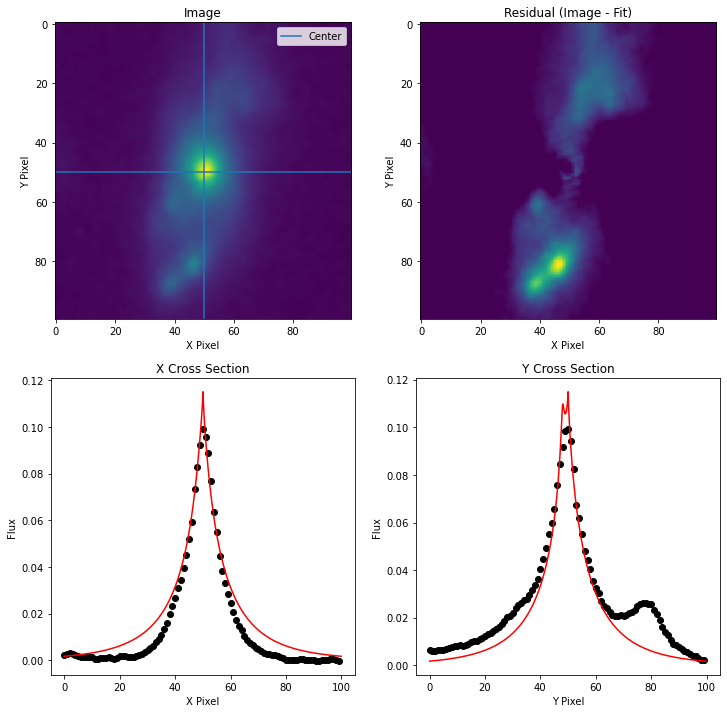

Label: 328


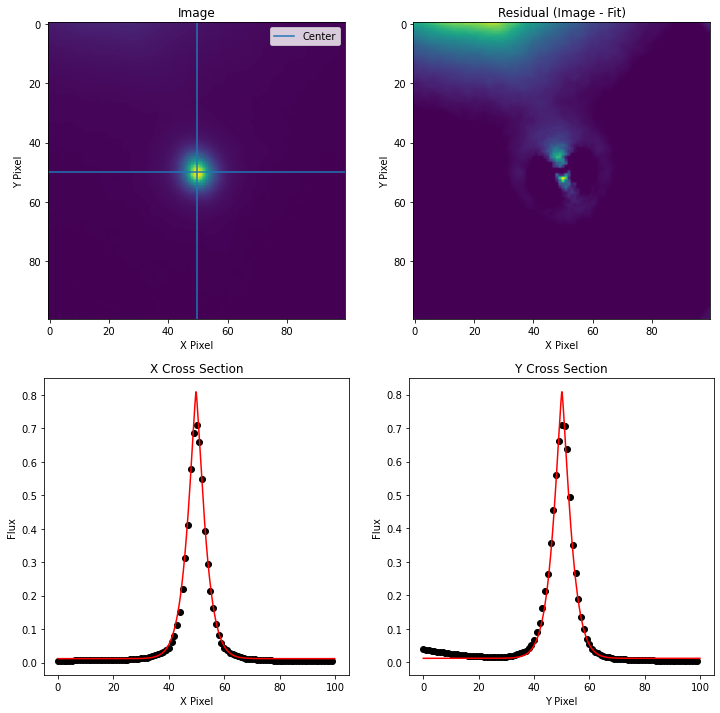

Label: 327


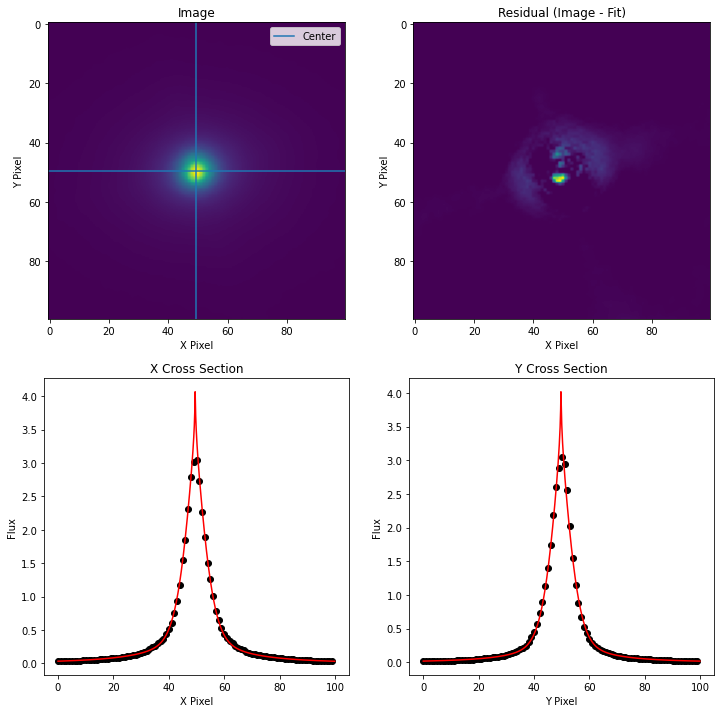

Label: 326


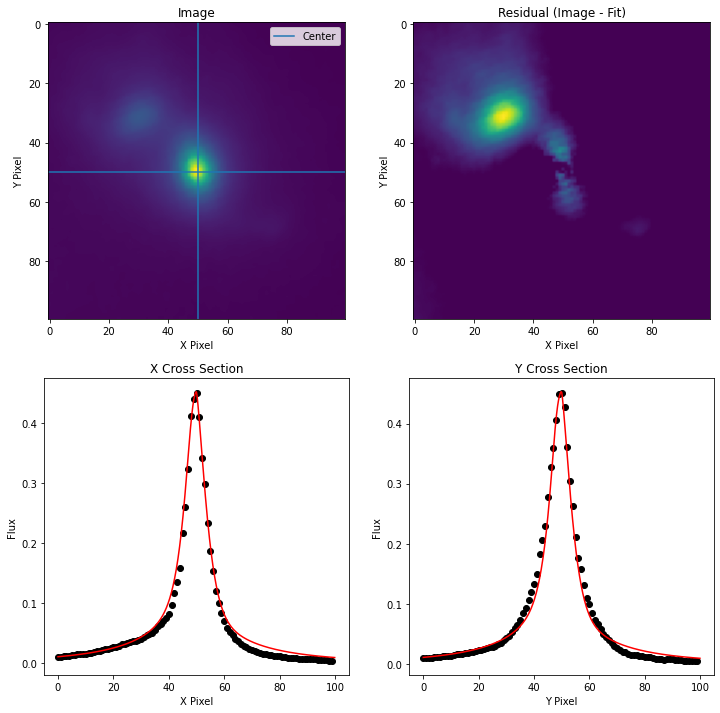

Label: 323


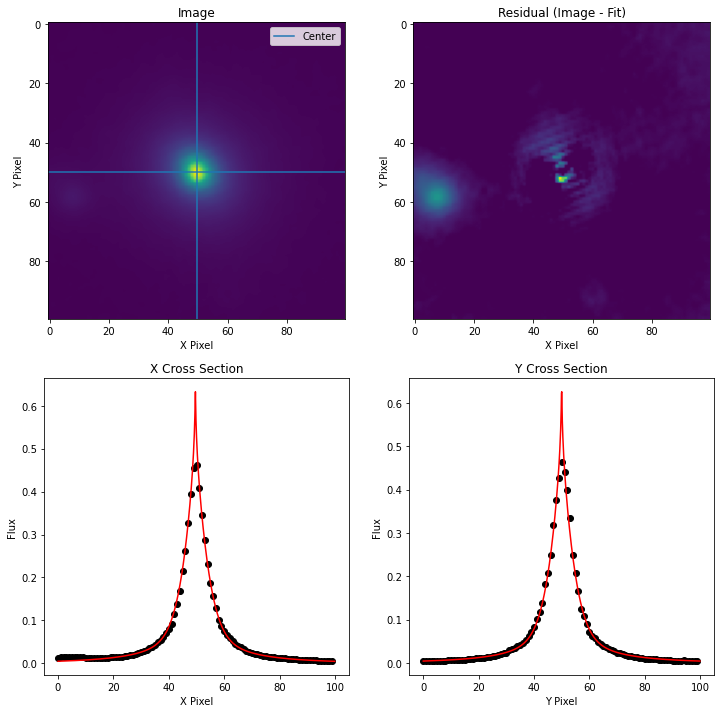

Label: 321


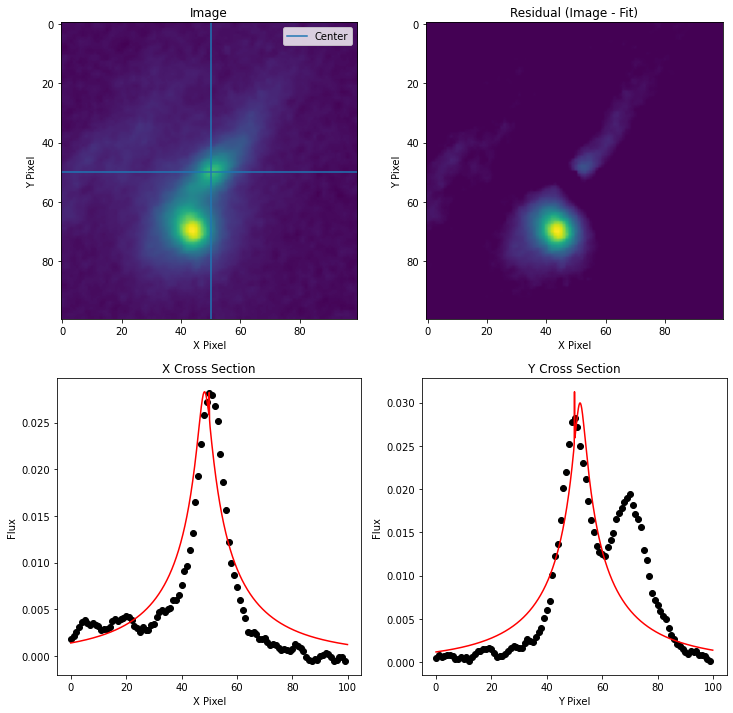

Label: 319


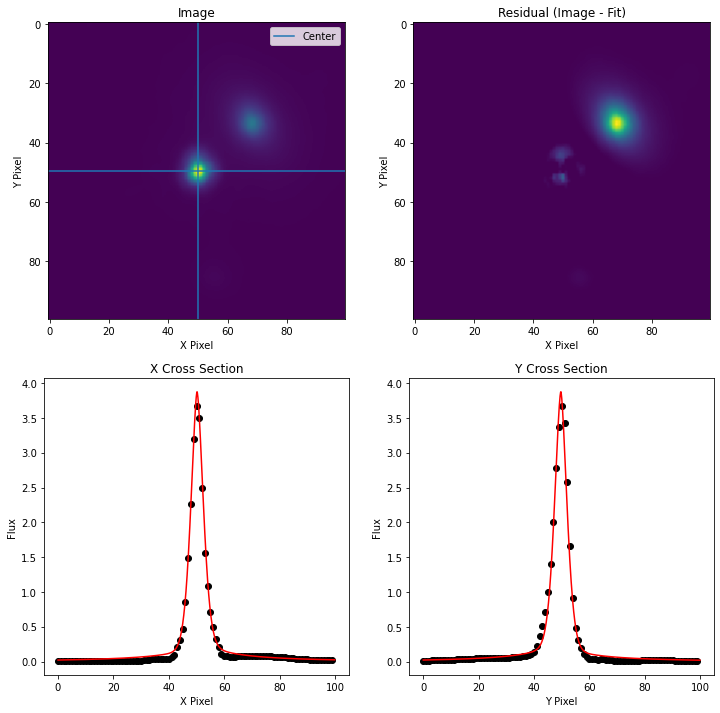

Label: 317


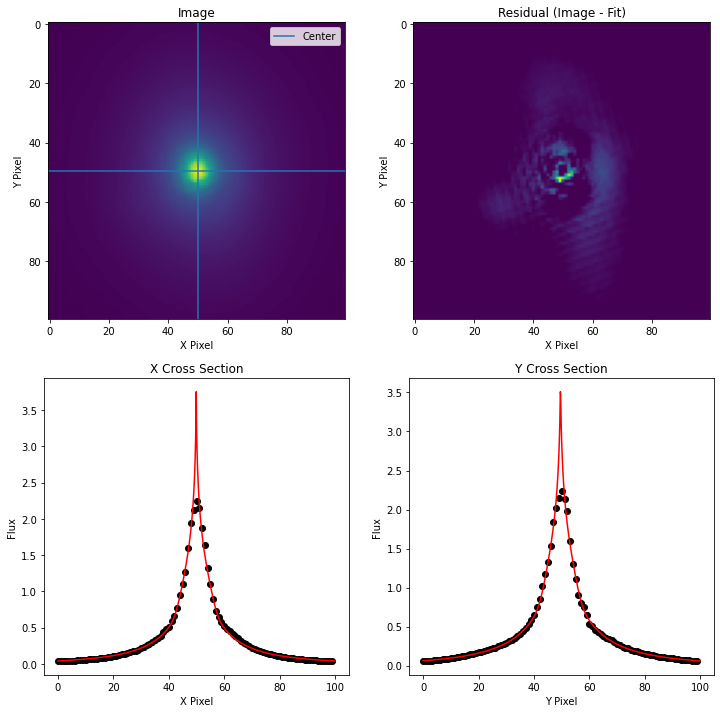

Label: 315


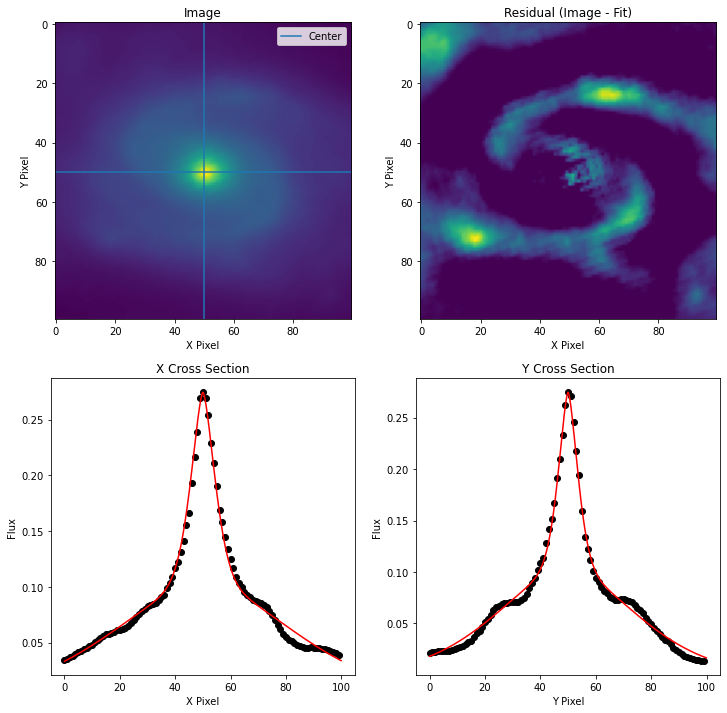

Label: 314


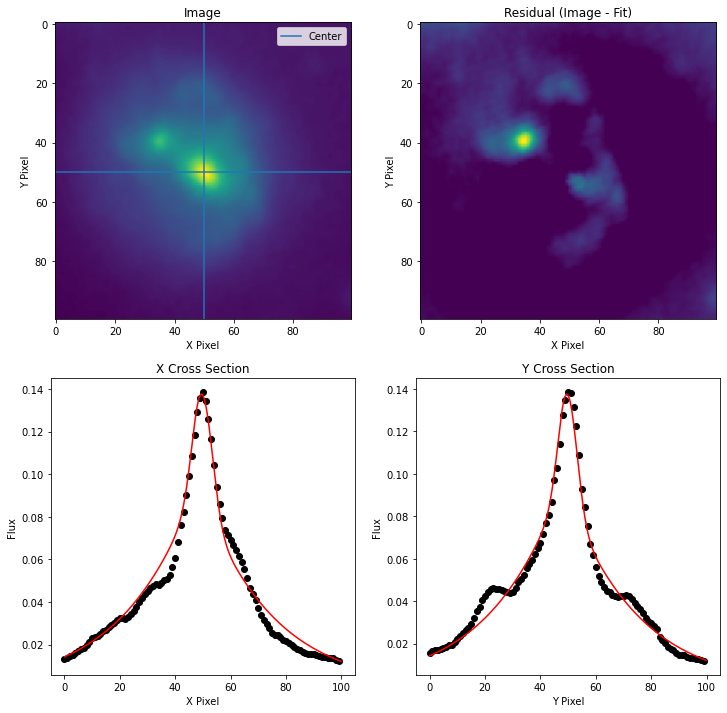

Label: 312


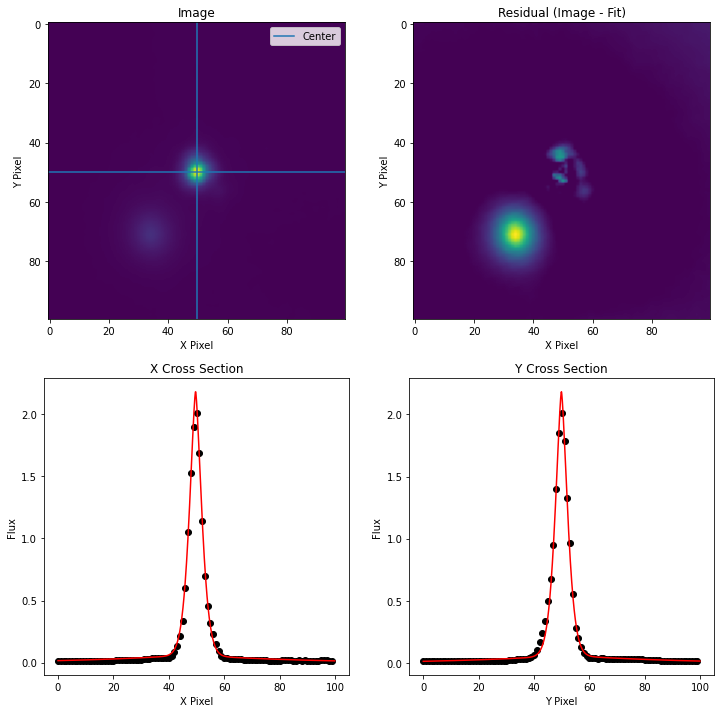

Label: 310


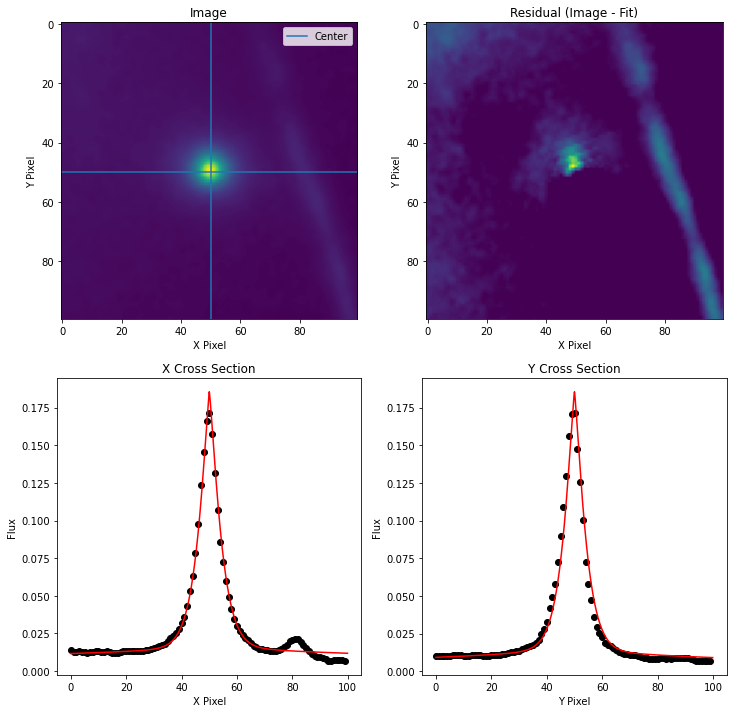

Label: 309


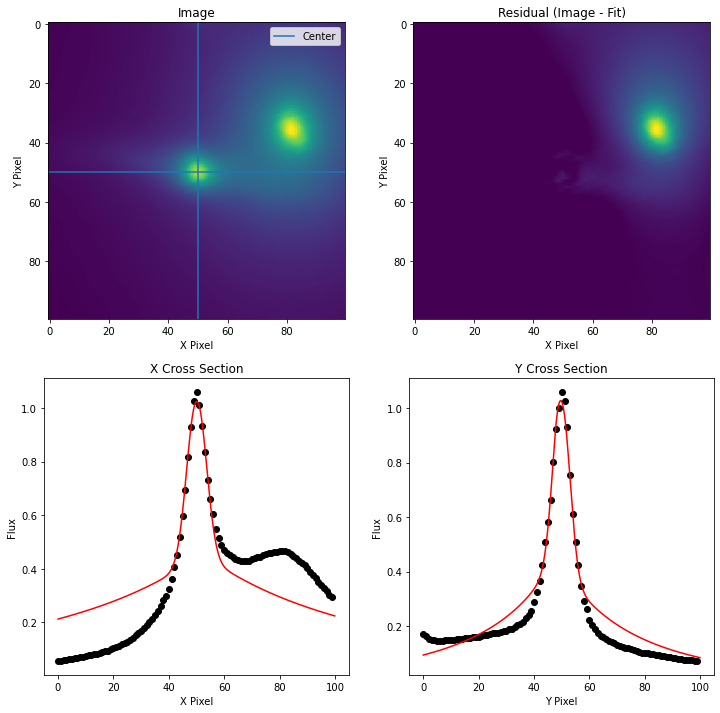

Label: 307


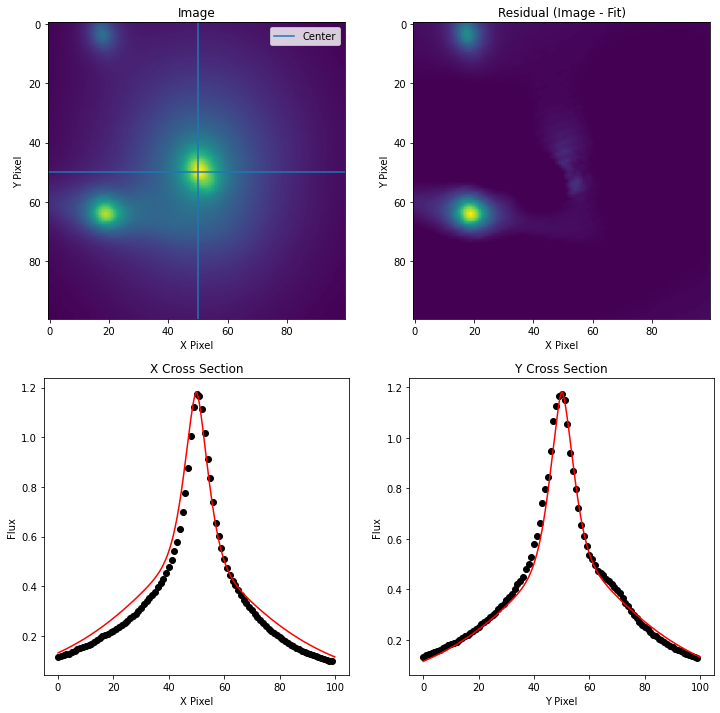

Label: 304


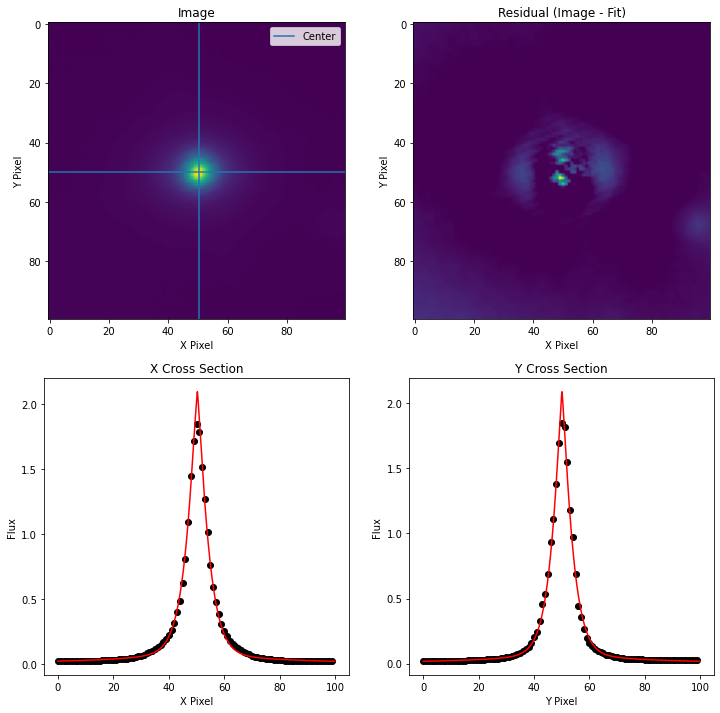

Label: 302


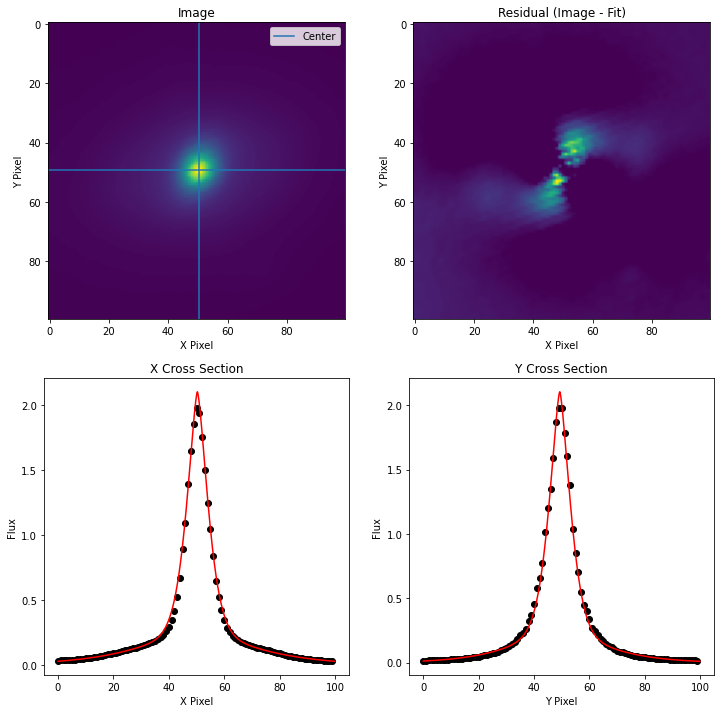

Label: 297


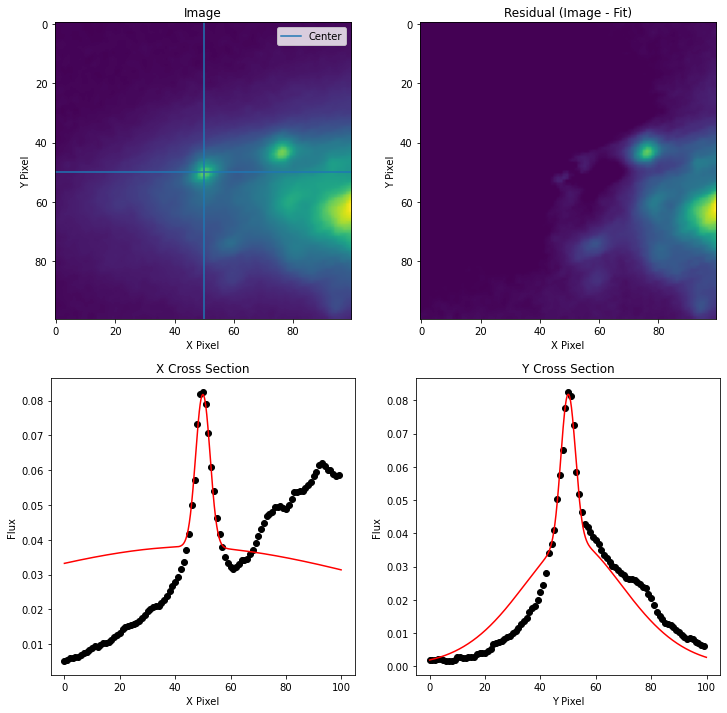

Label: 296


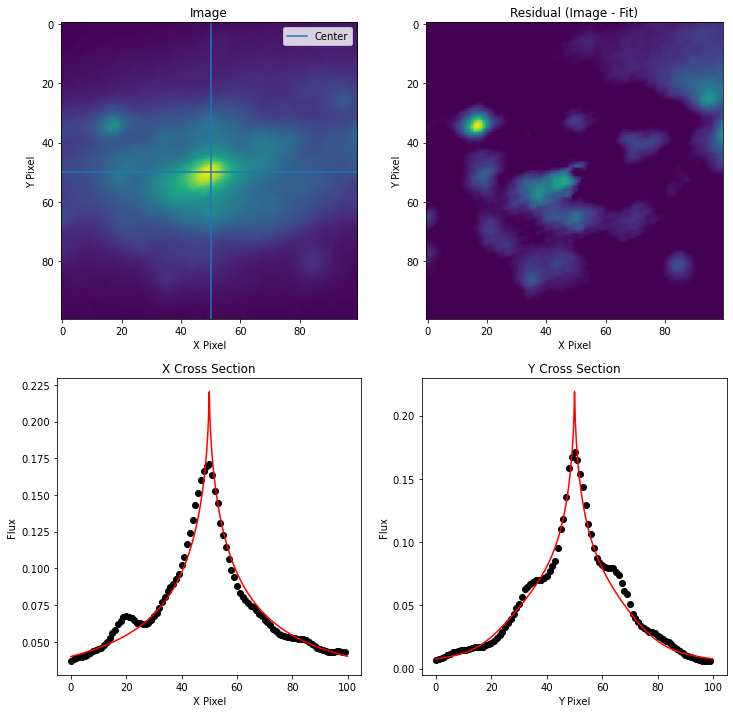

Label: 292


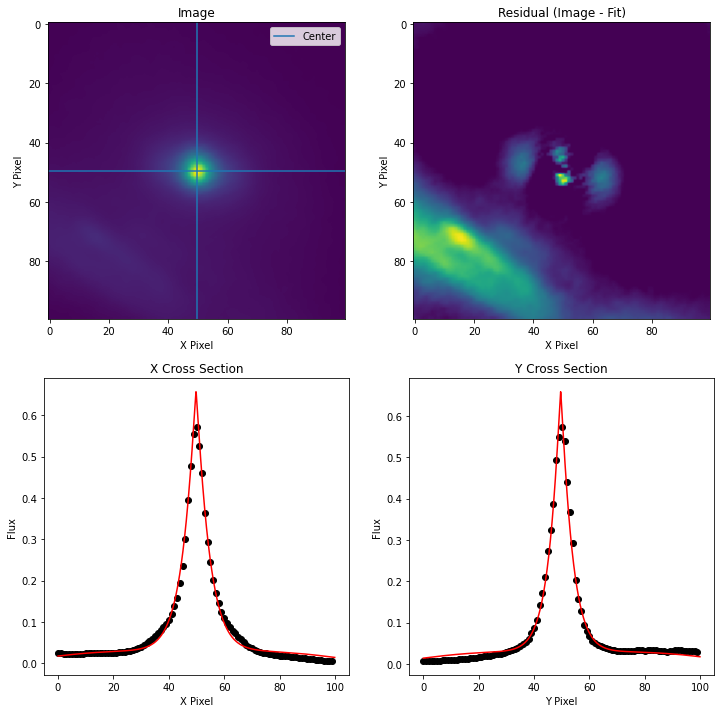

Label: 288


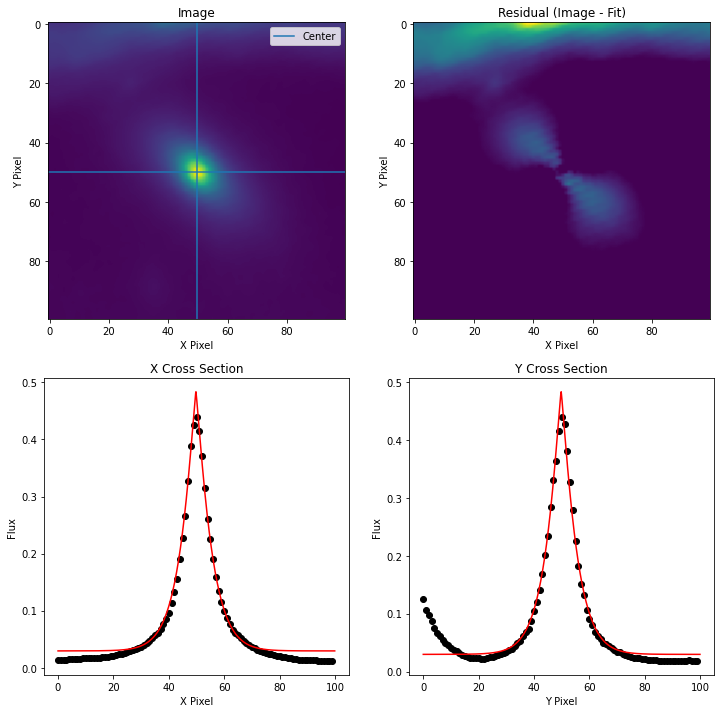

Label: 285


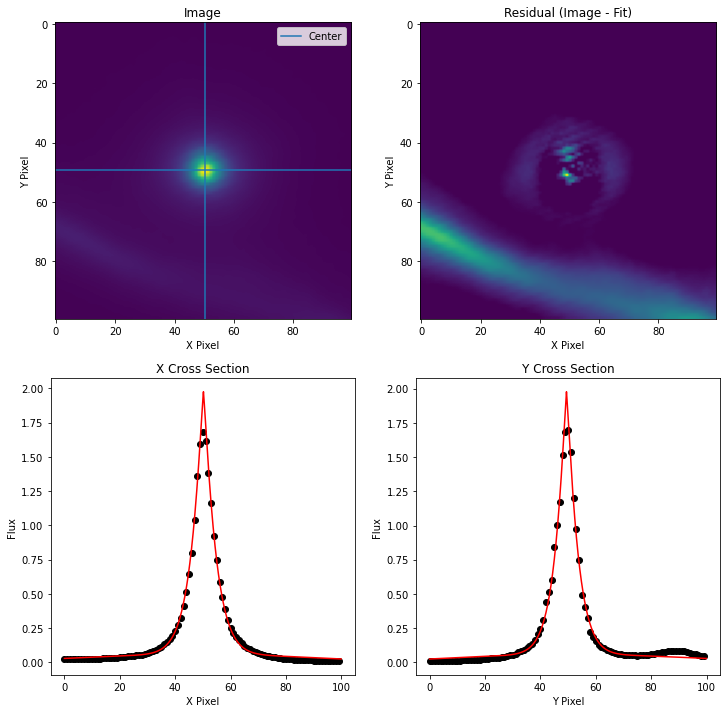

Label: 284


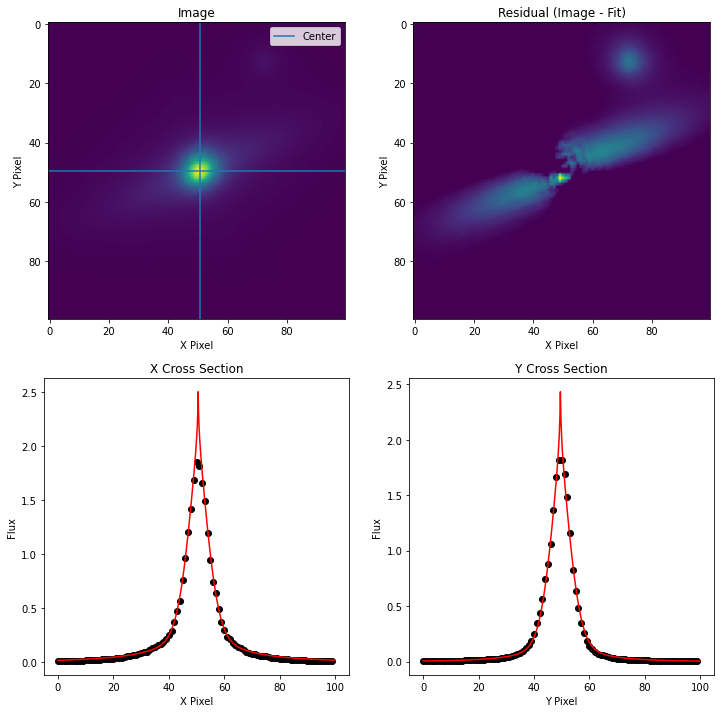

Label: 281


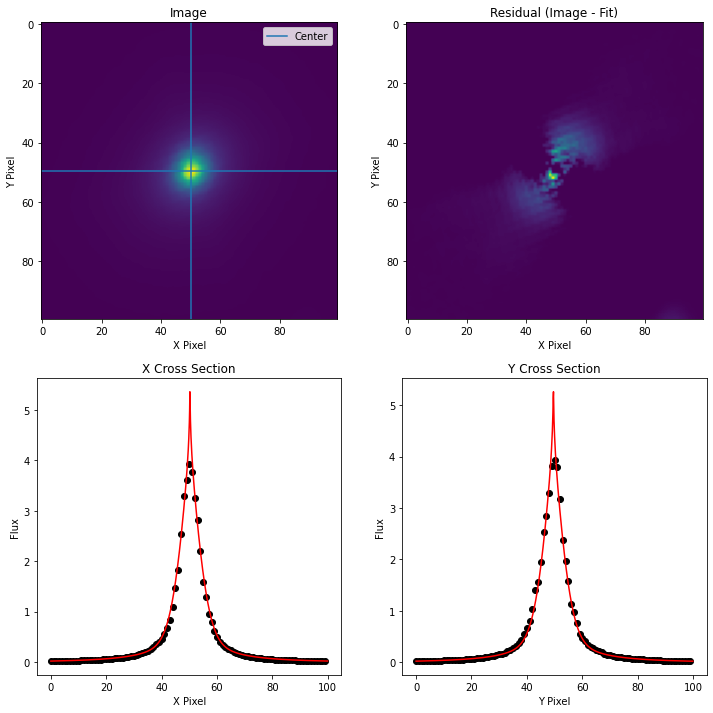

Label: 279


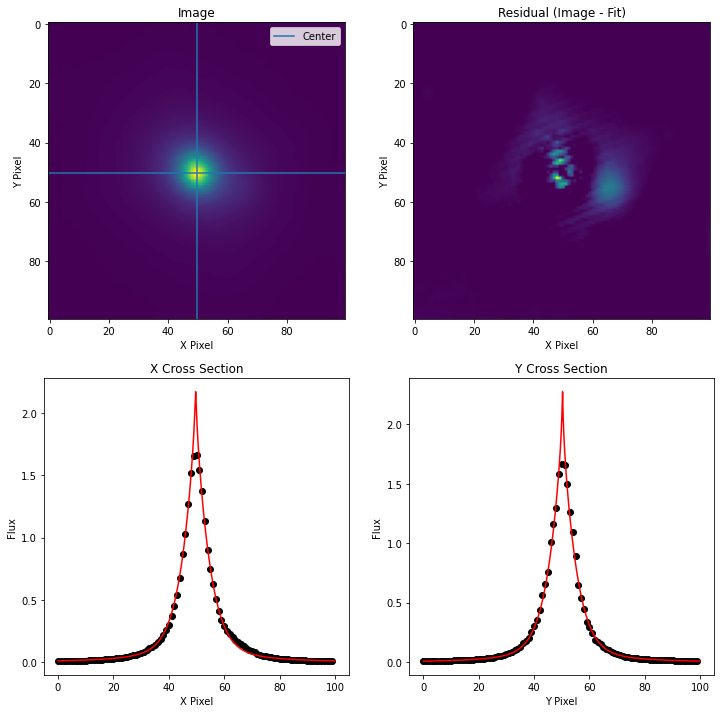

Label: 278


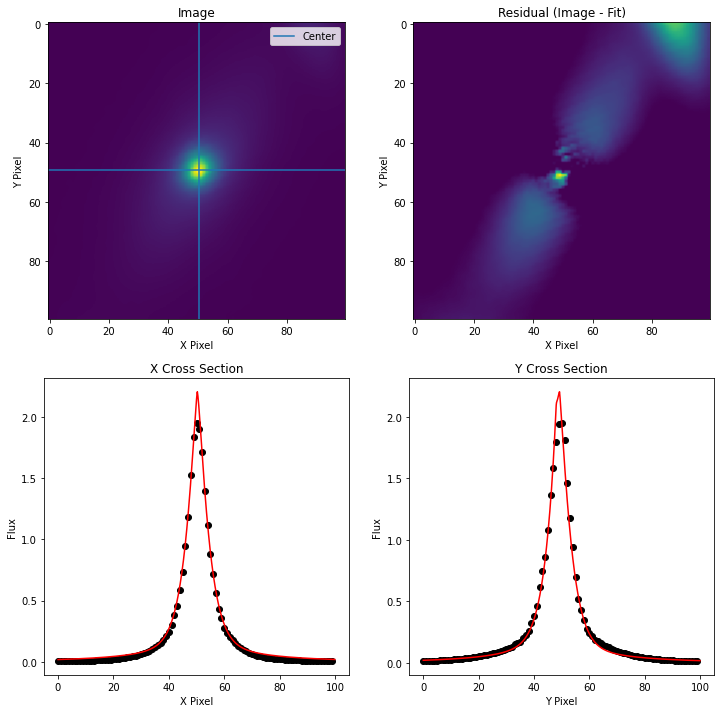

Label: 277


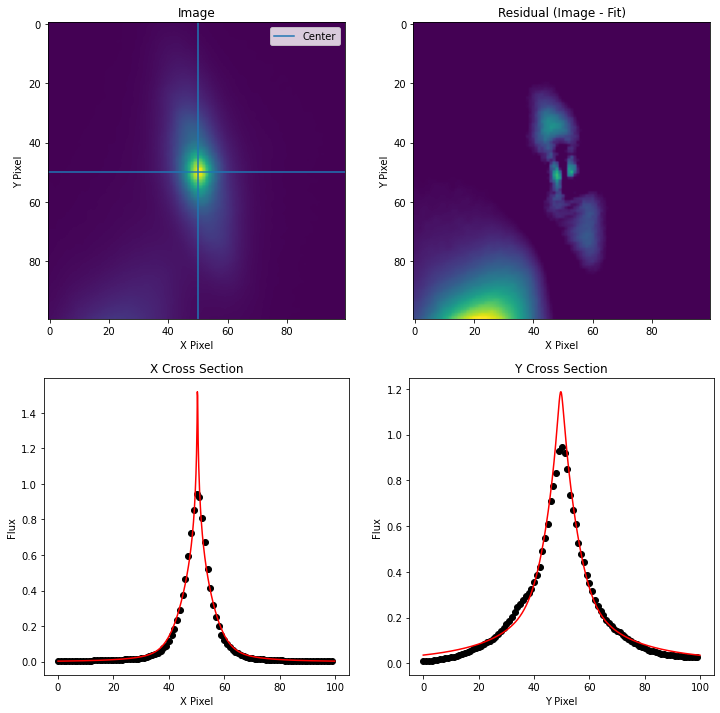

Label: 272


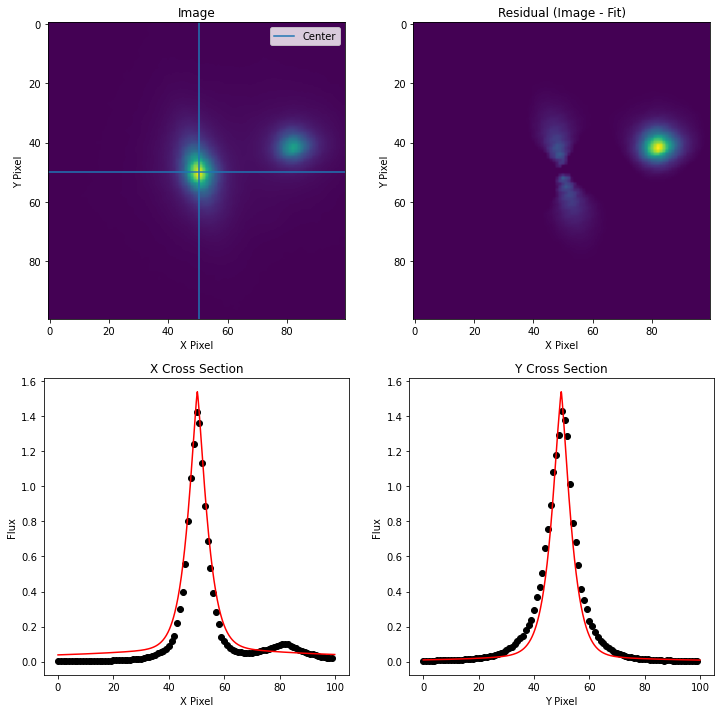

Label: 263


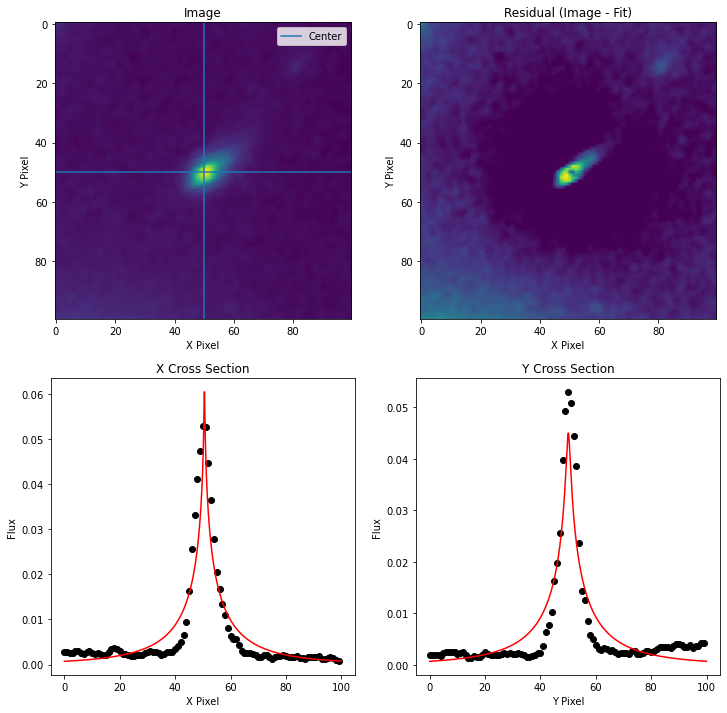

Label: 258


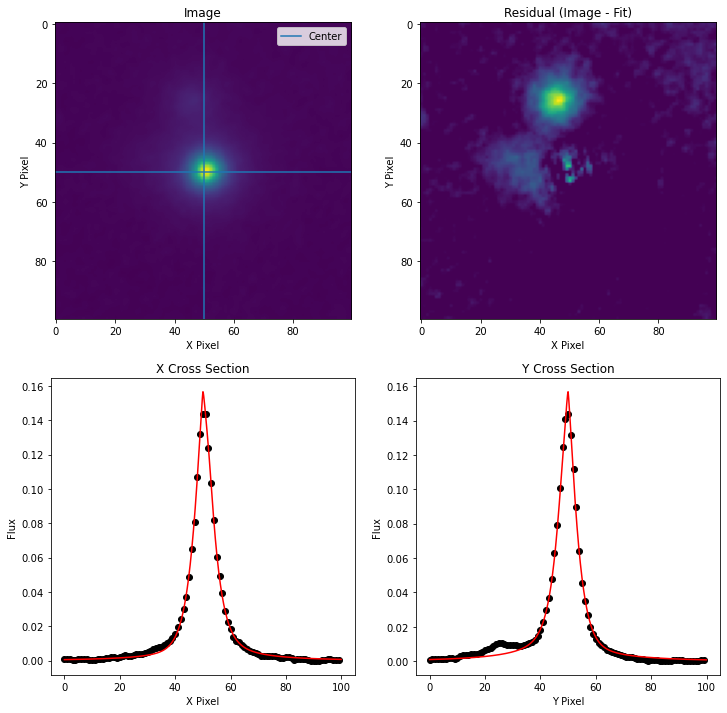

Label: 257


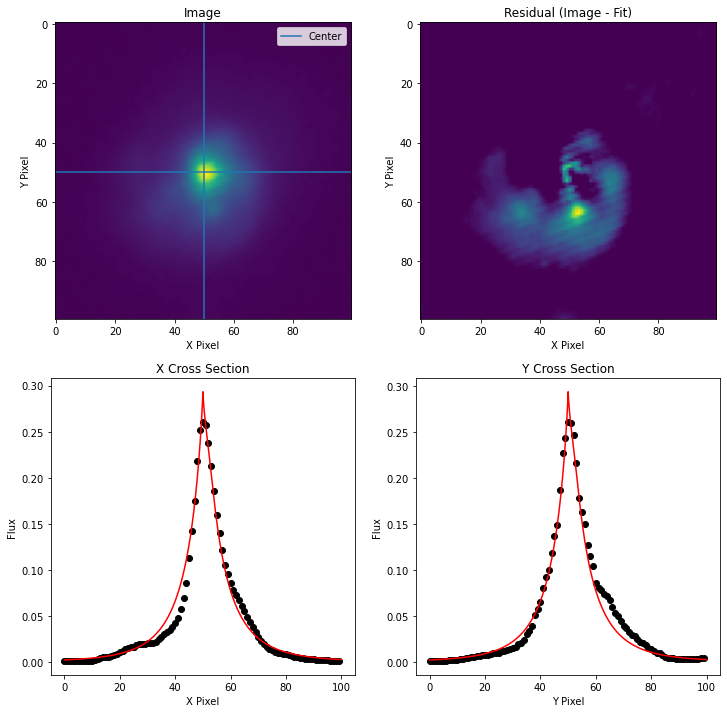

Label: 256


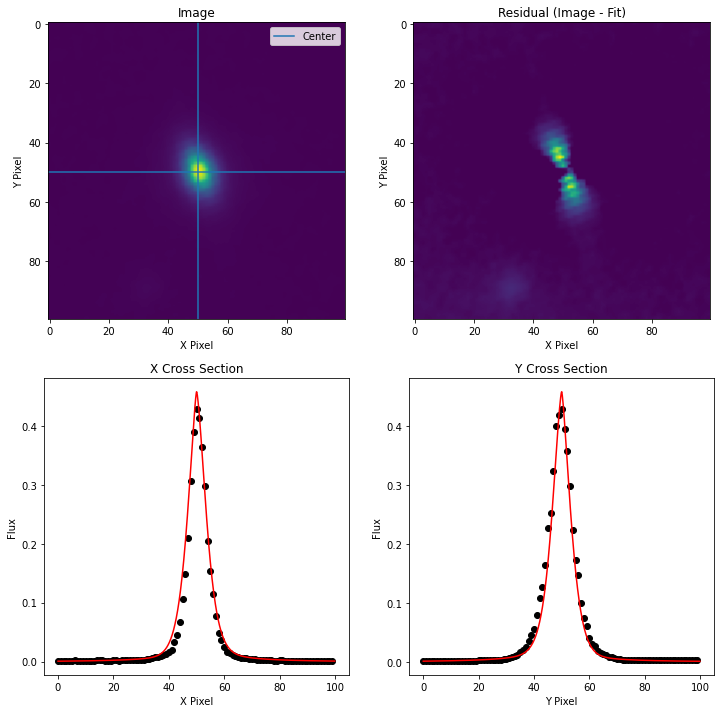

Label: 253


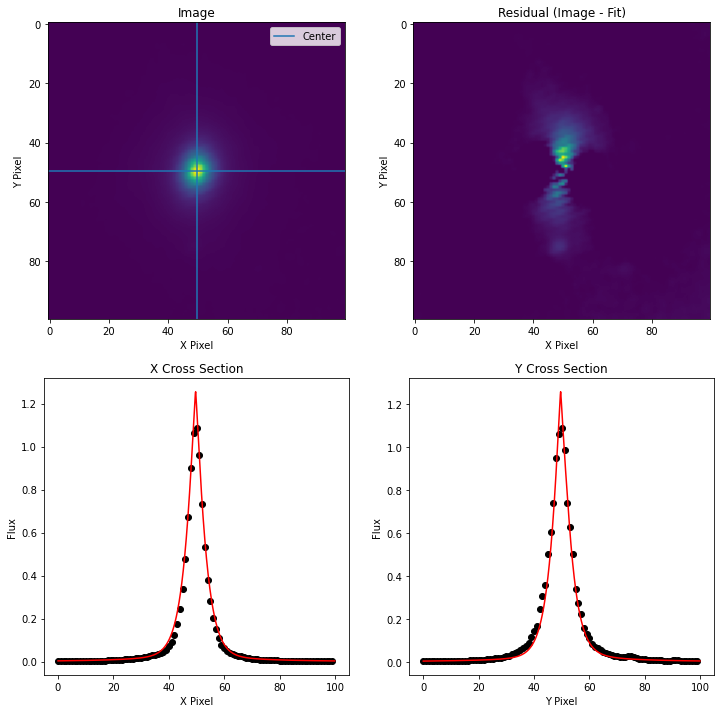

Label: 252


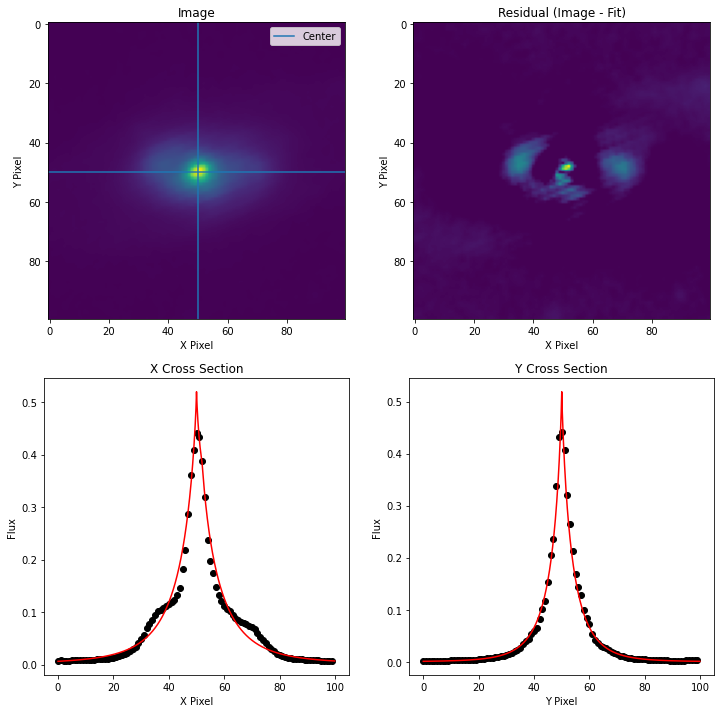

Label: 251


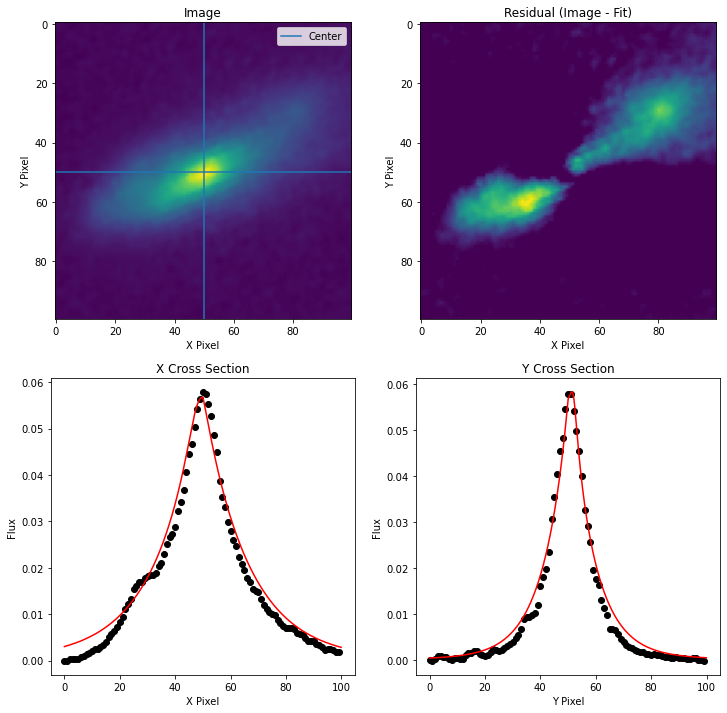

Label: 250


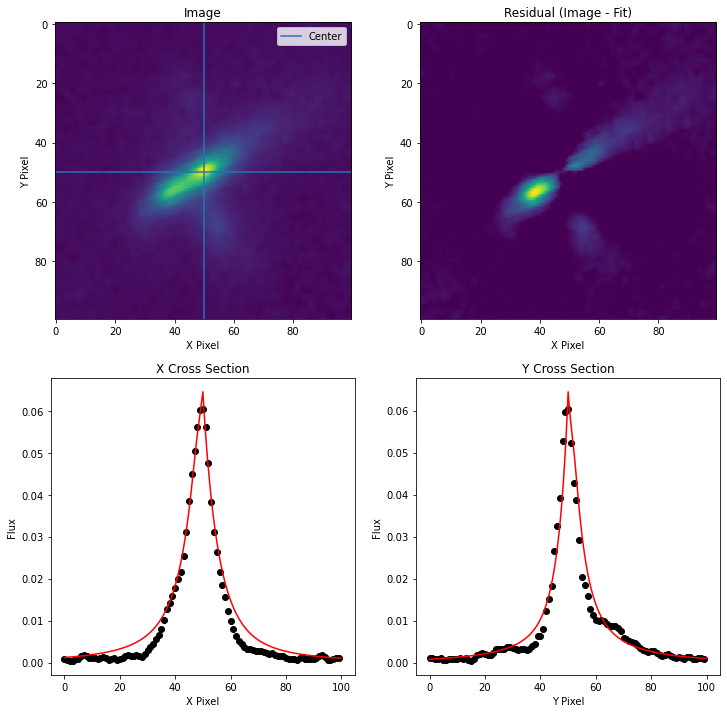

Label: 249


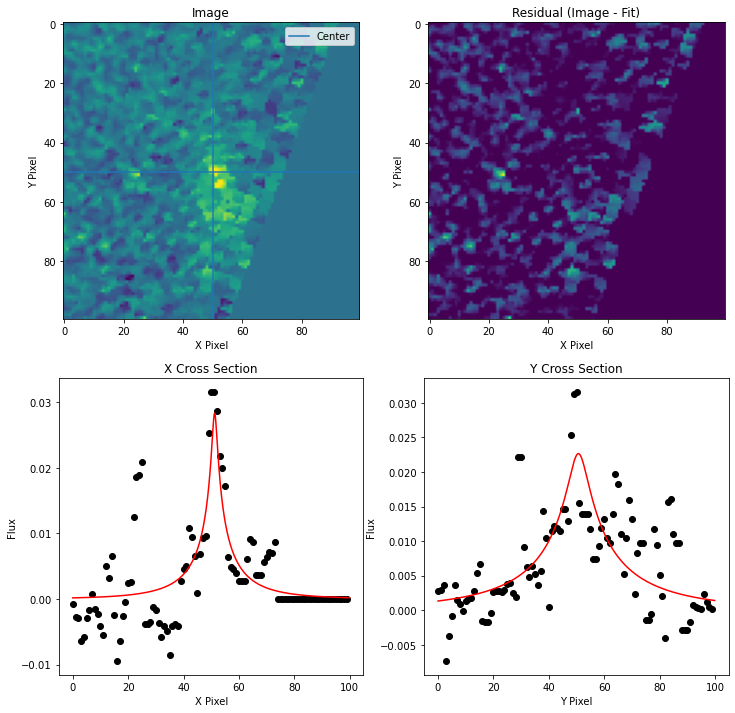

Label: 246


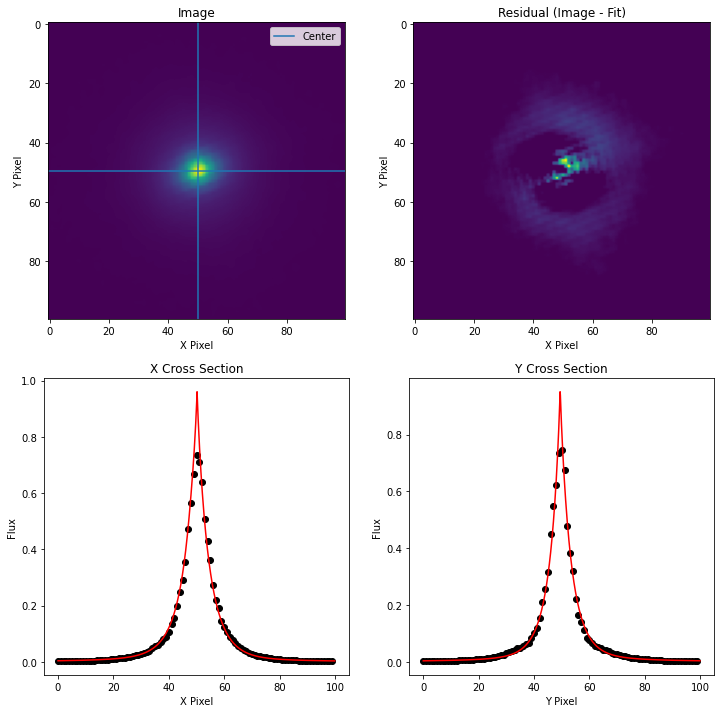

Label: 245


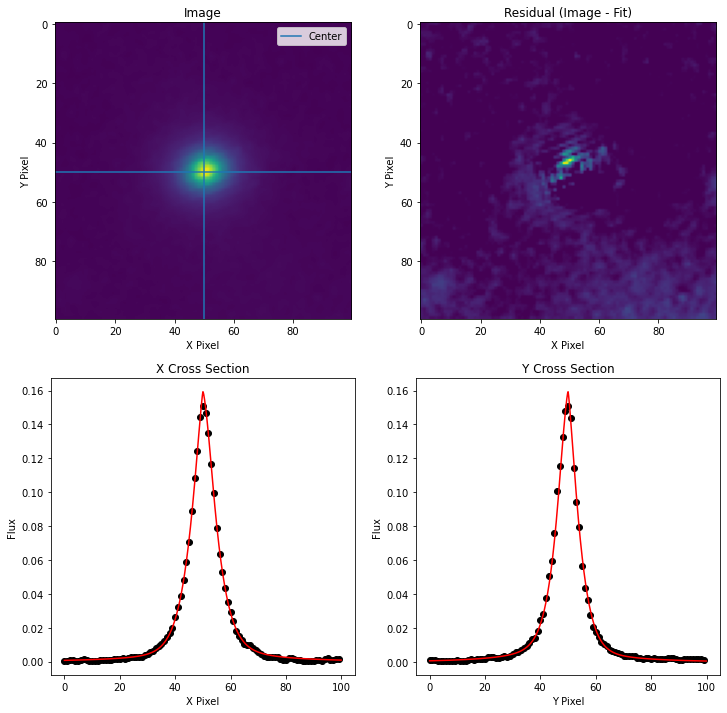

Label: 243


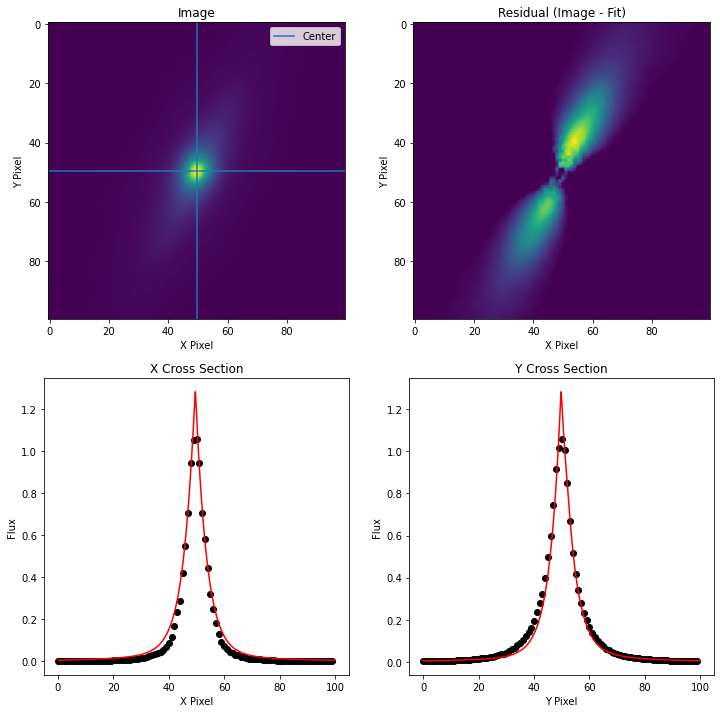

Label: 242


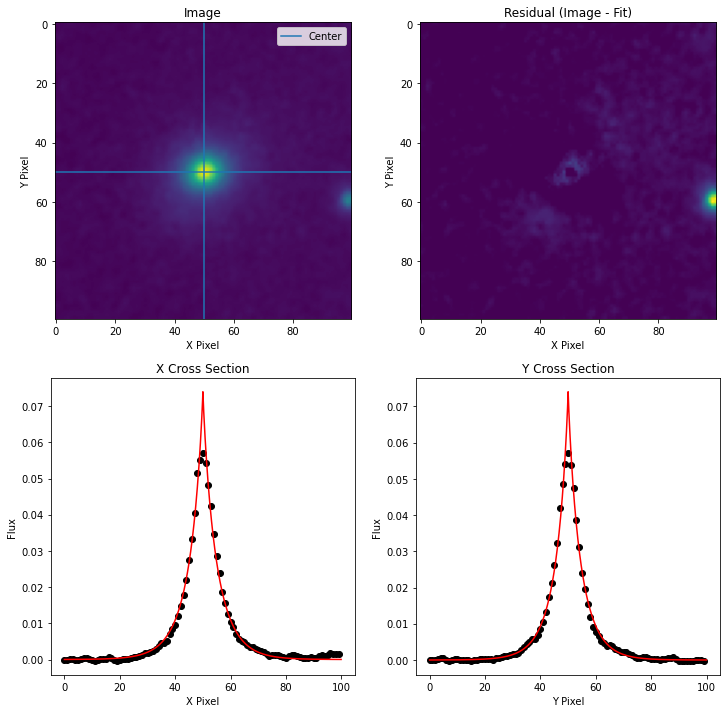

Label: 241


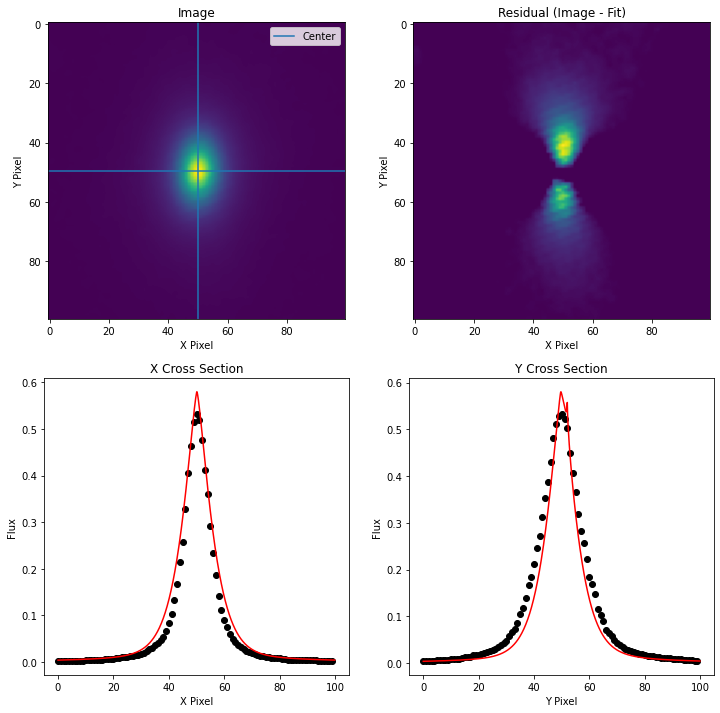

Label: 239


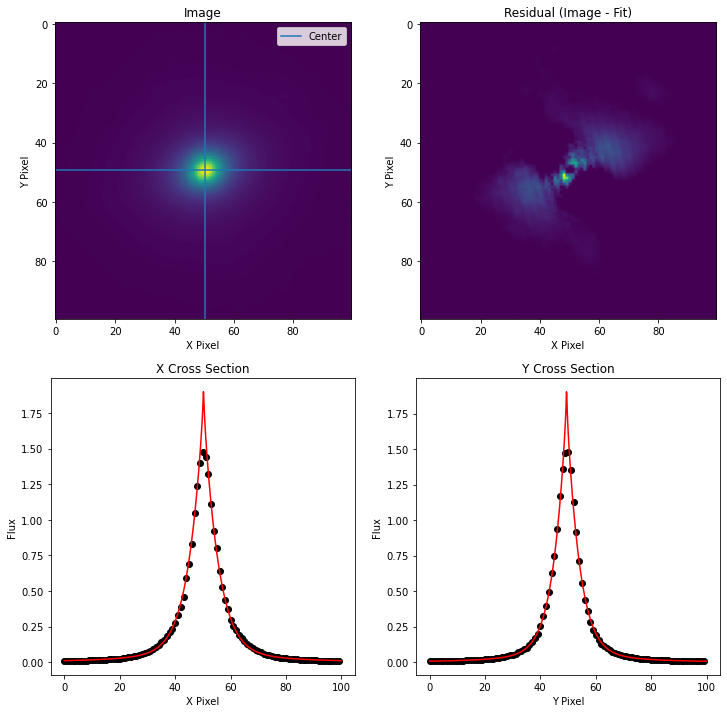

Label: 238


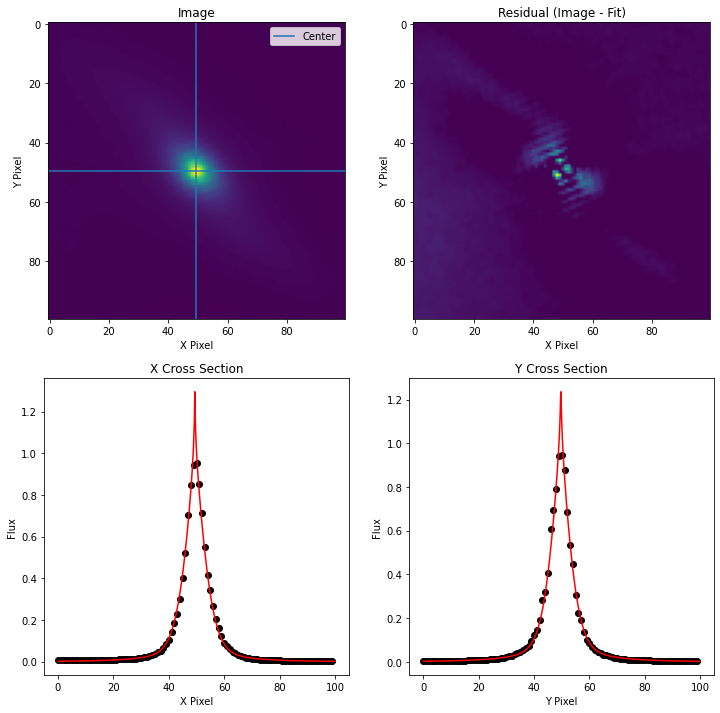

Label: 232


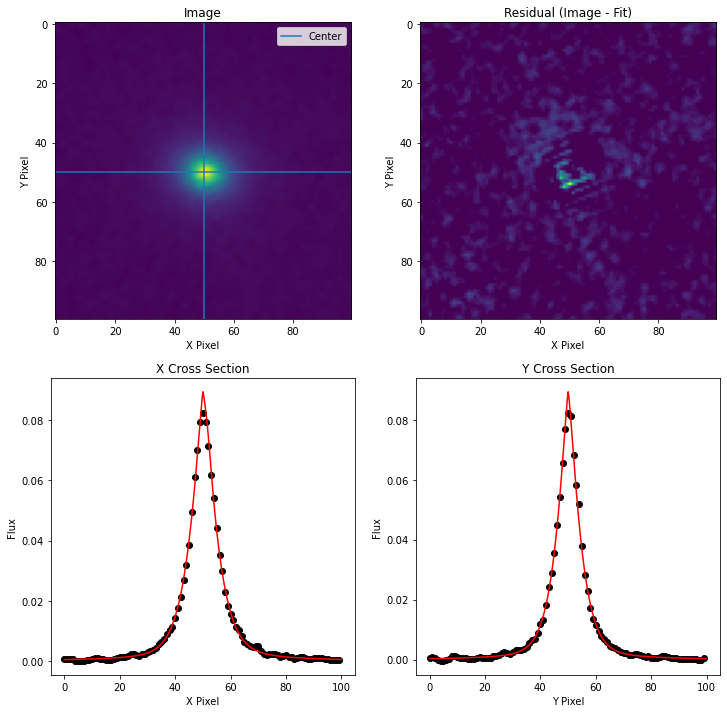

Label: 231


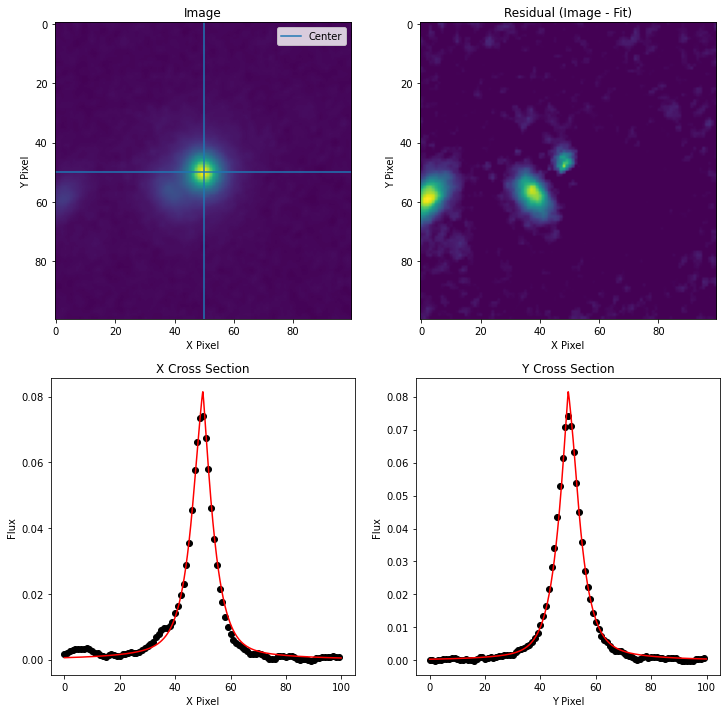

Label: 230


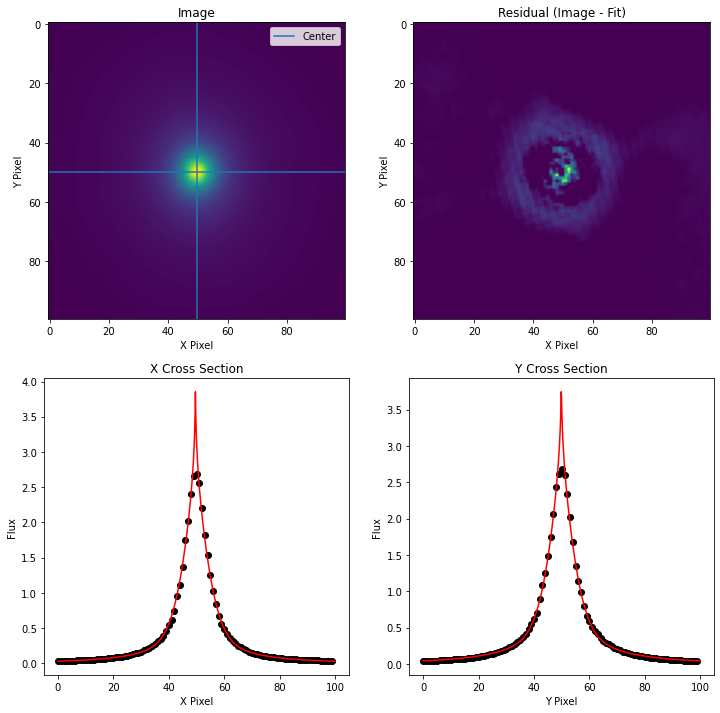

Label: 228


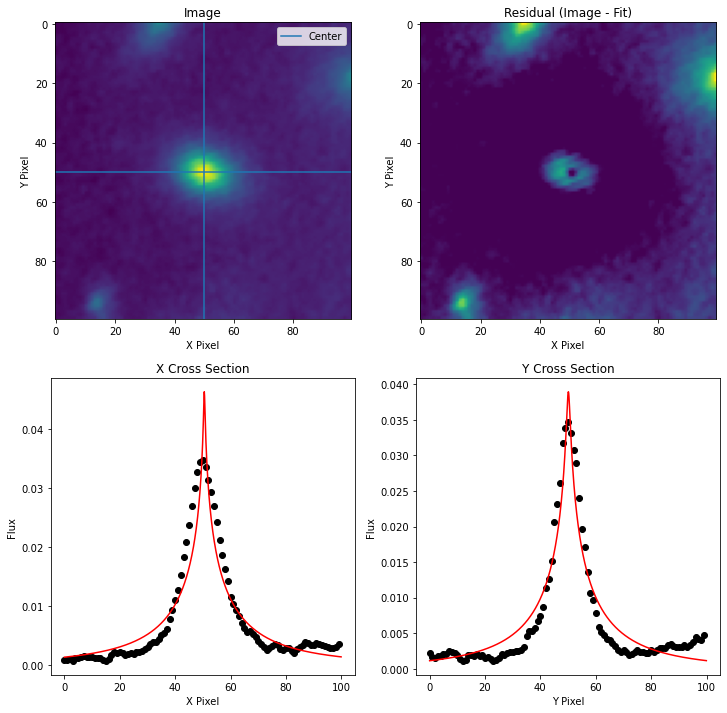

Label: 226


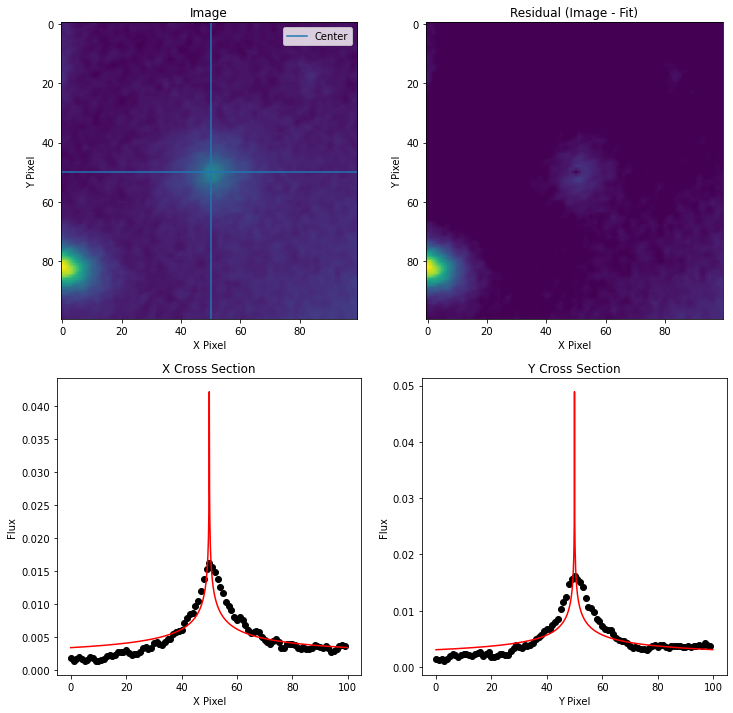

Label: 225


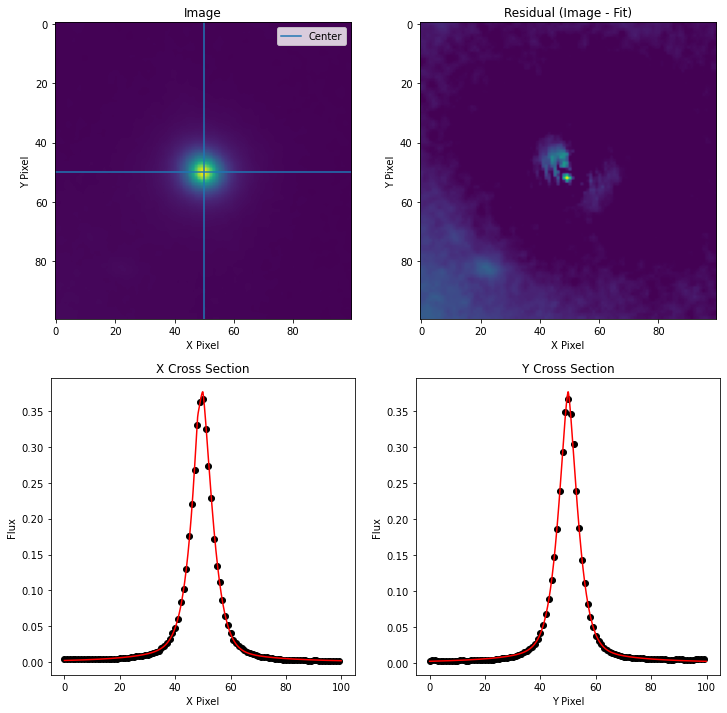

Label: 224


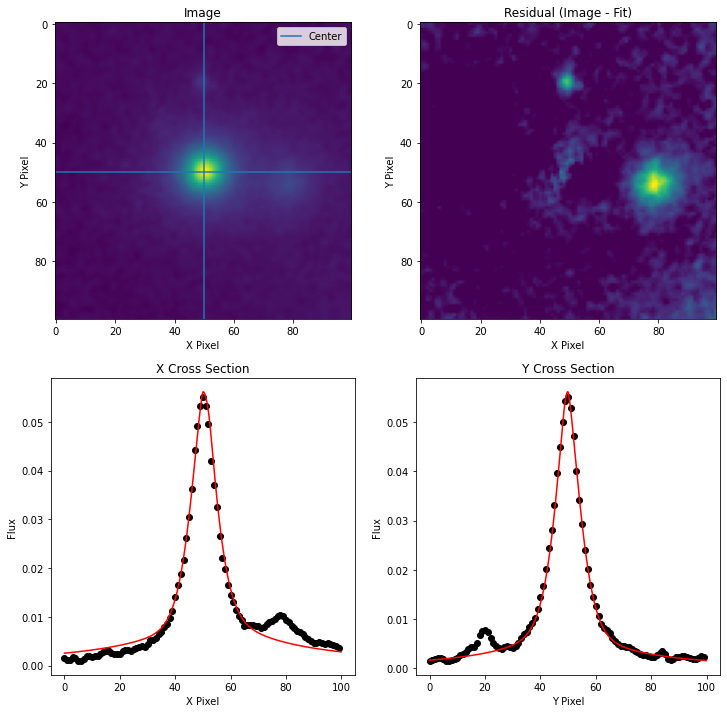

Label: 220


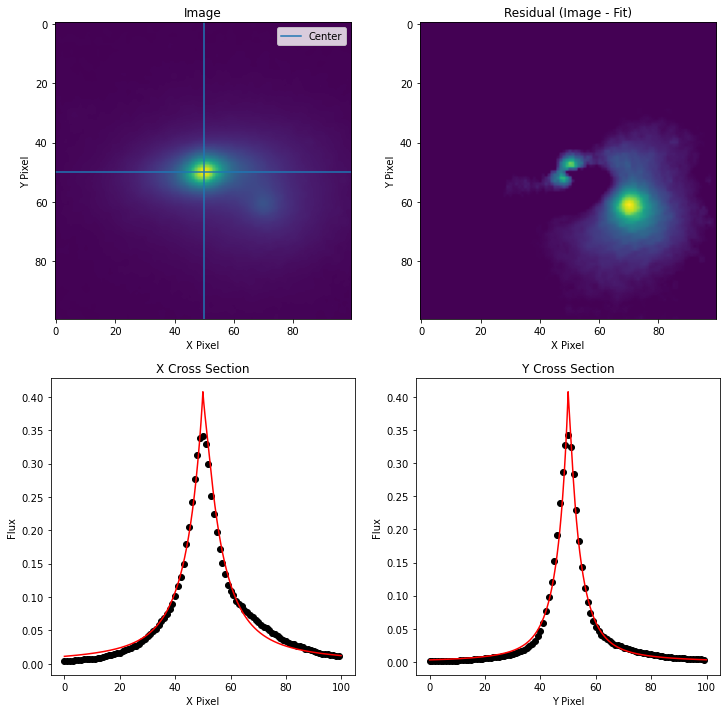

Label: 219


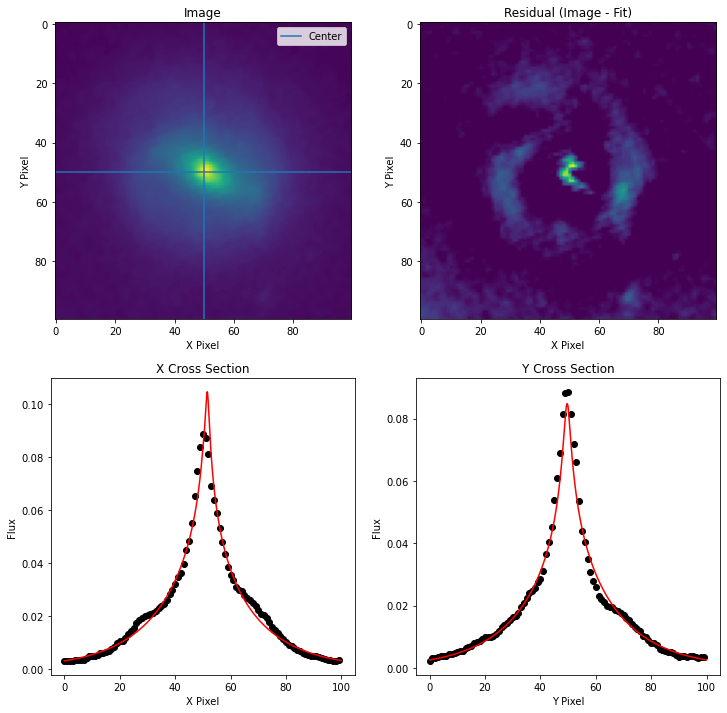

Label: 218


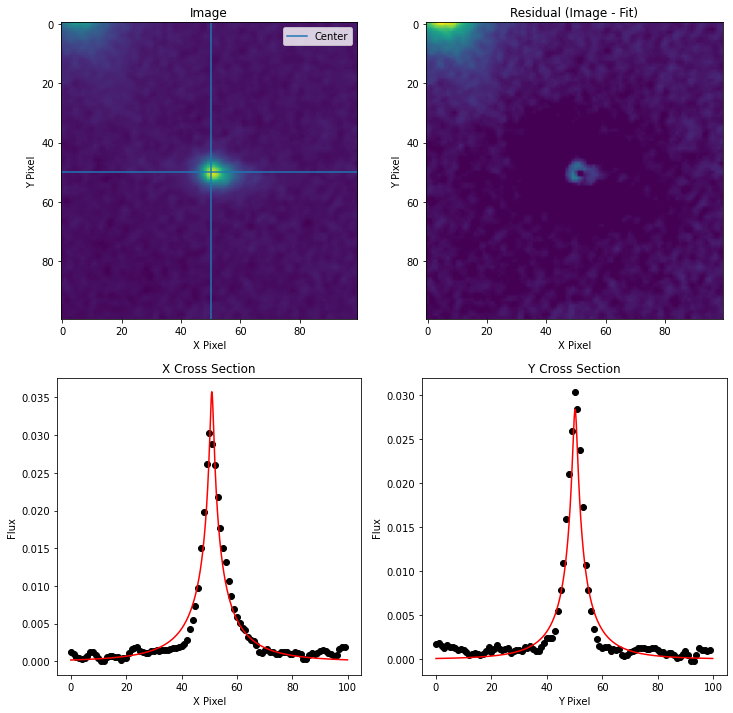

Label: 217


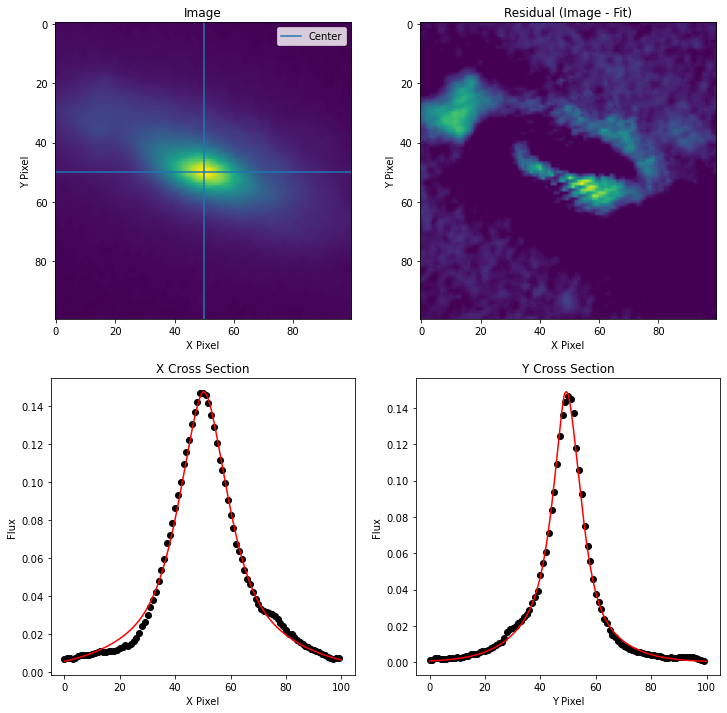

Label: 213


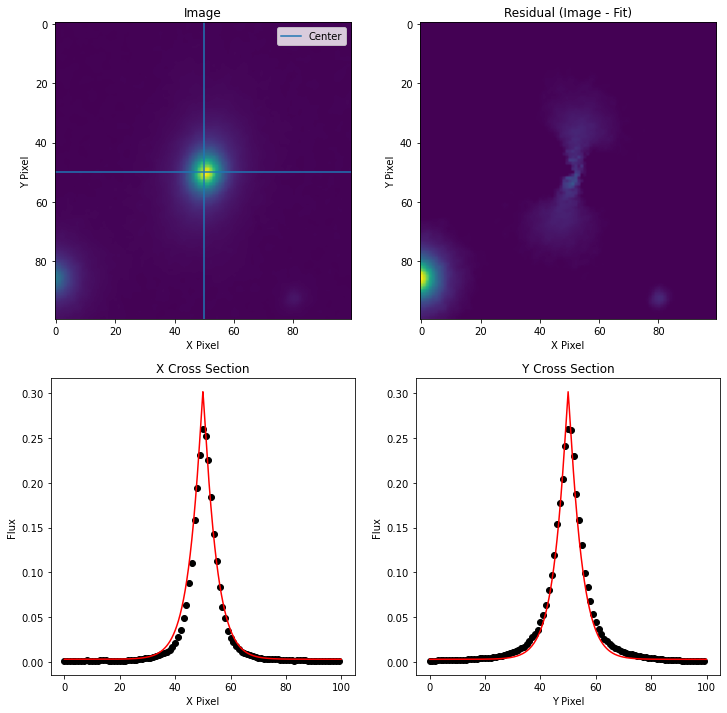

Label: 212


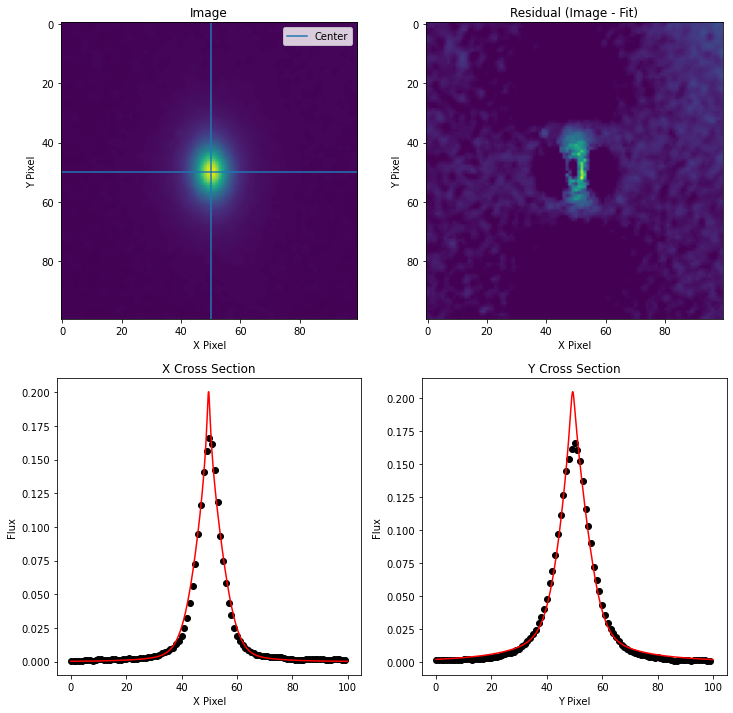

Label: 211


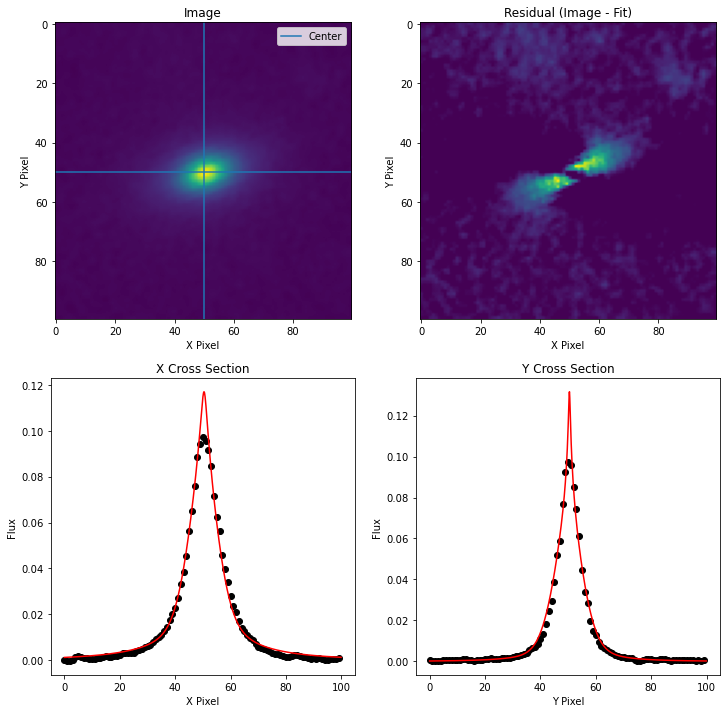

Label: 209


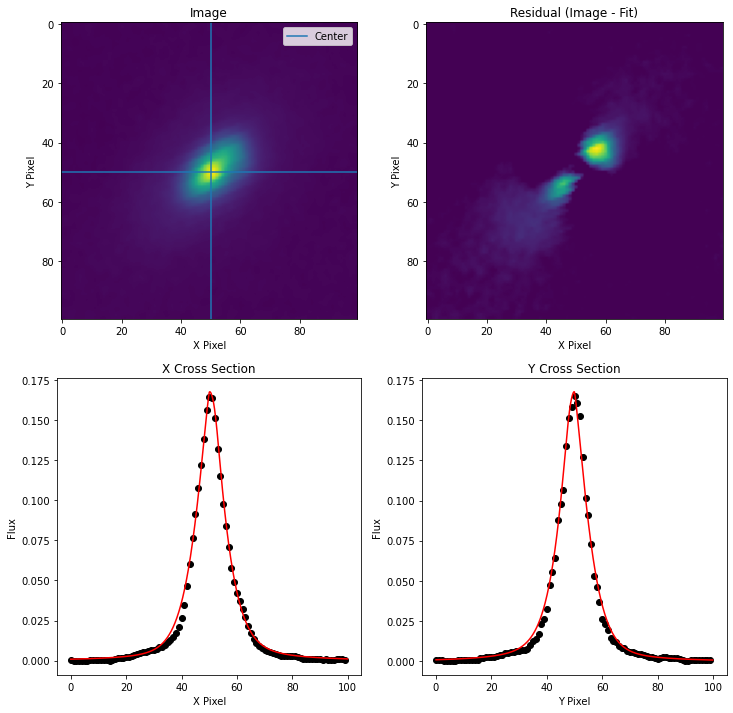

Label: 207


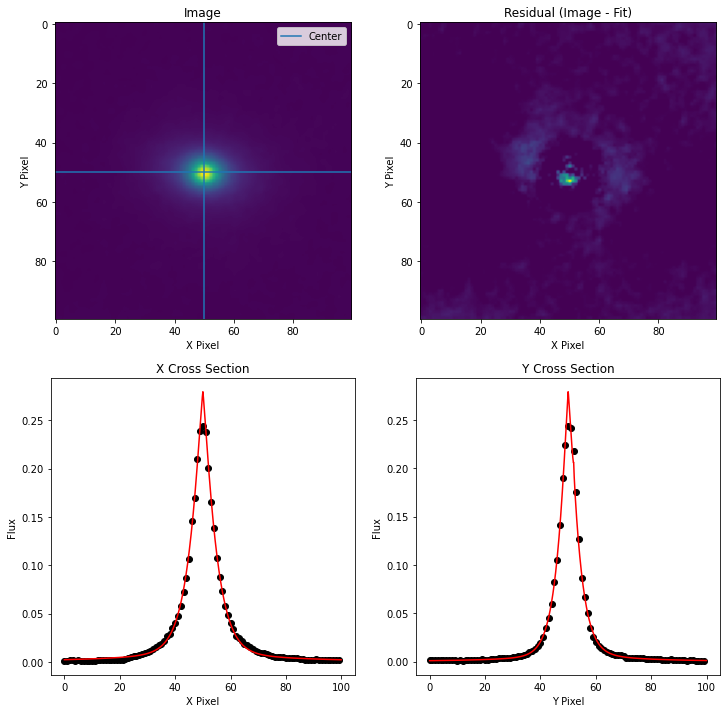

Label: 205


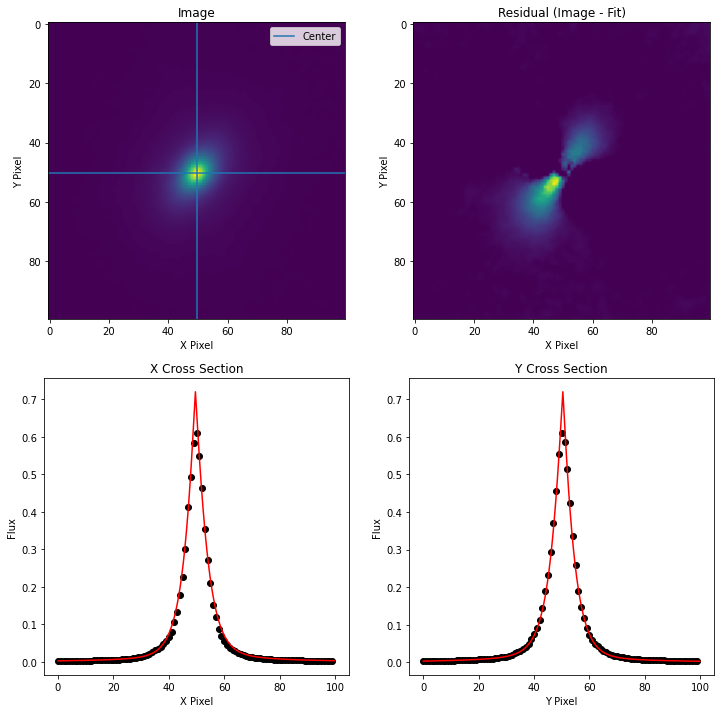

Label: 204


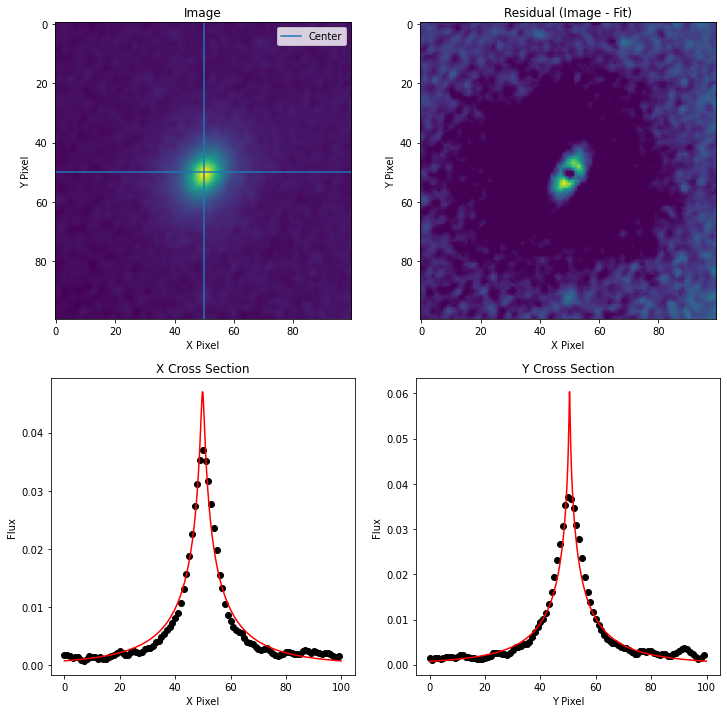

Label: 200


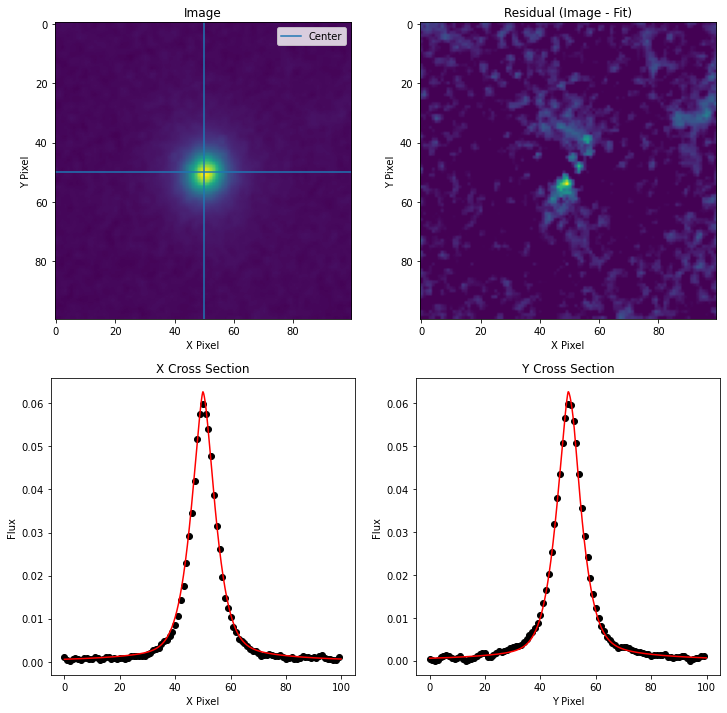

Label: 199


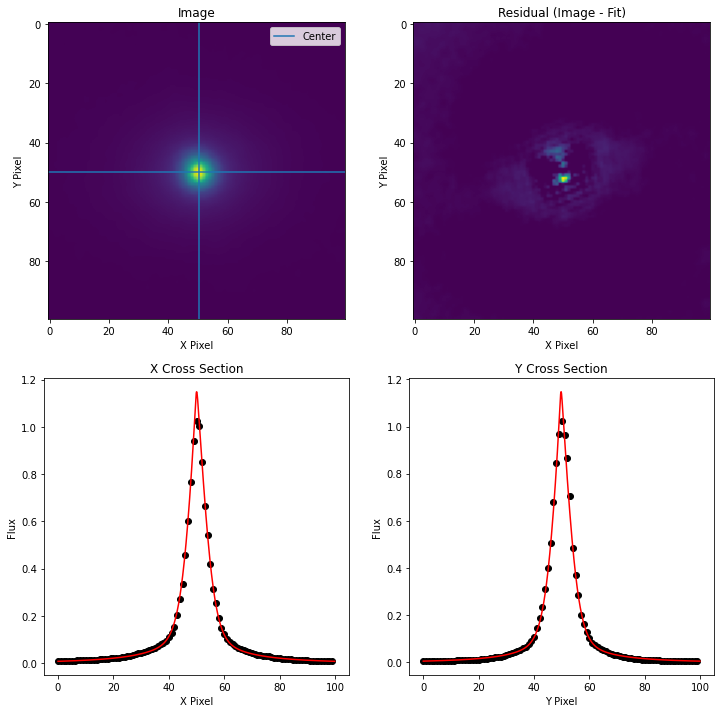

Label: 197


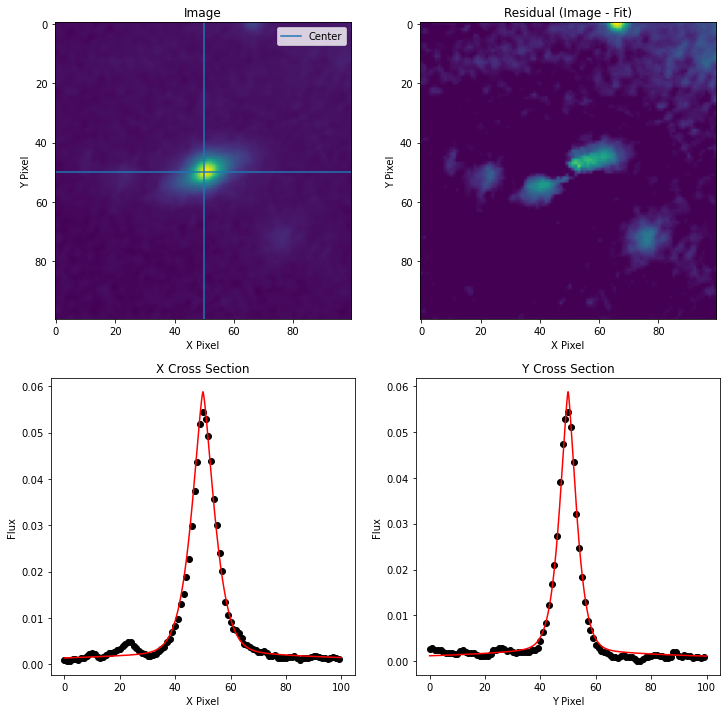

Label: 196


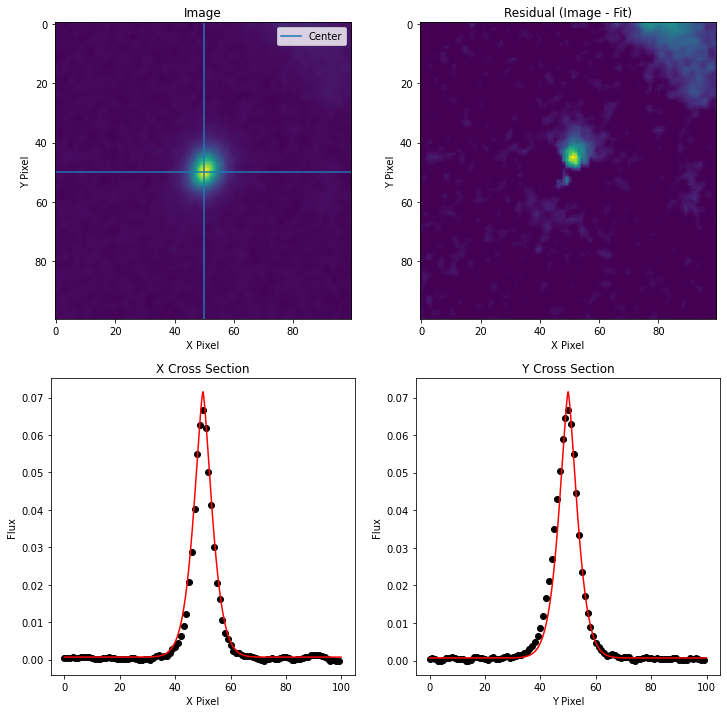

Label: 193


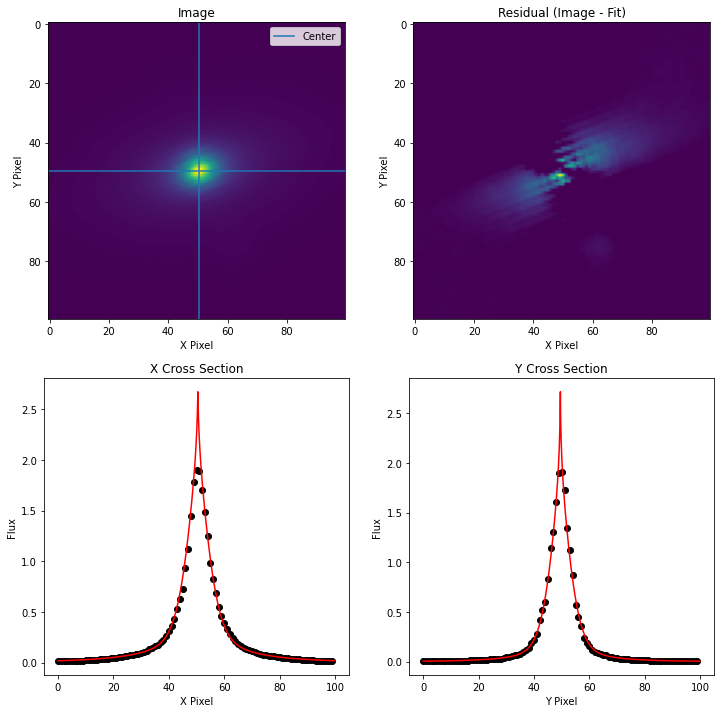

Label: 192


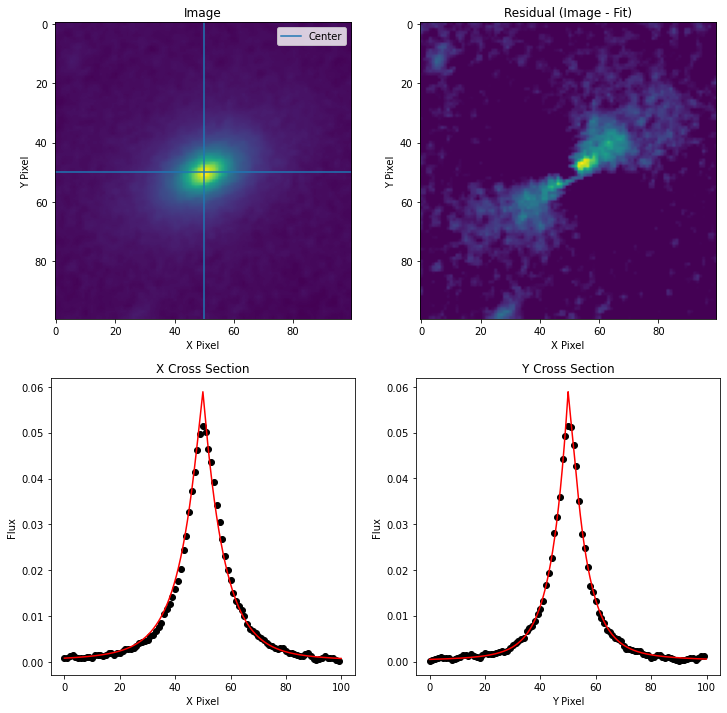

Label: 191


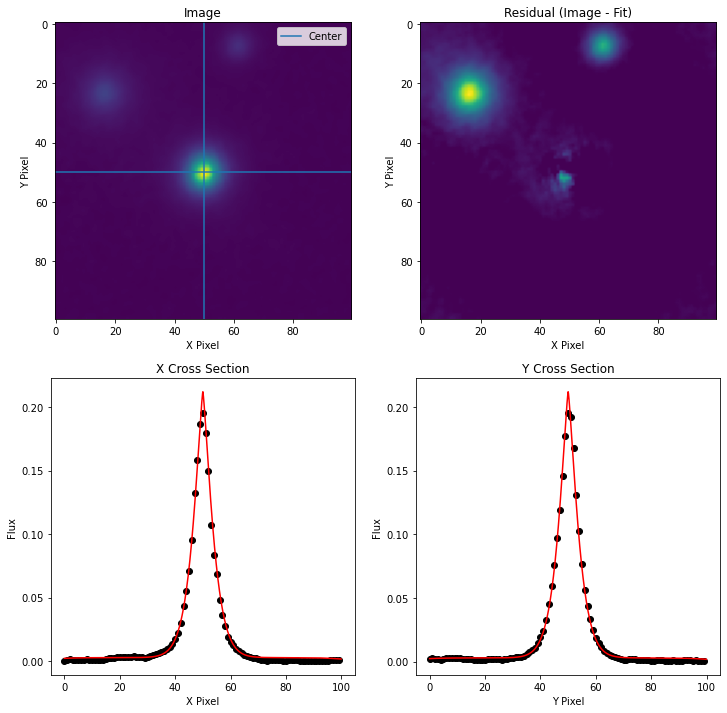

Label: 185


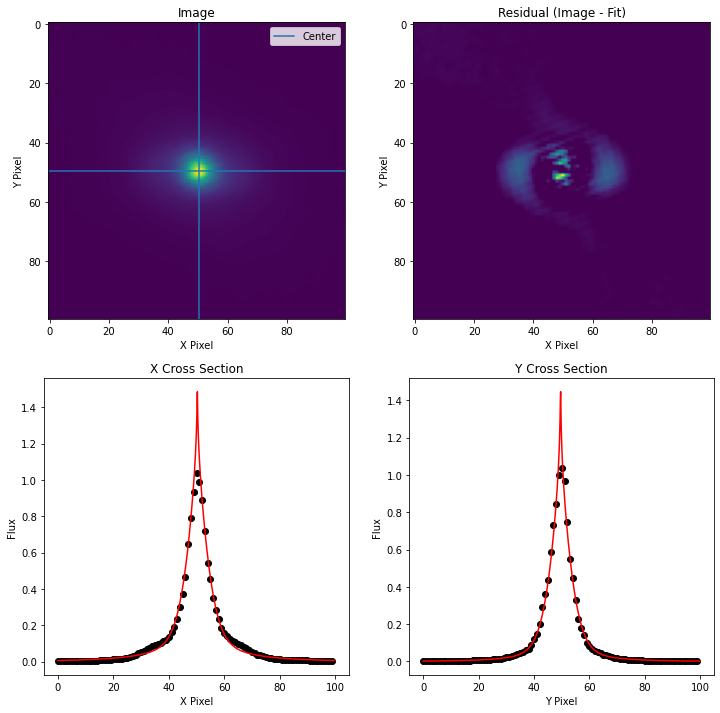

Label: 184


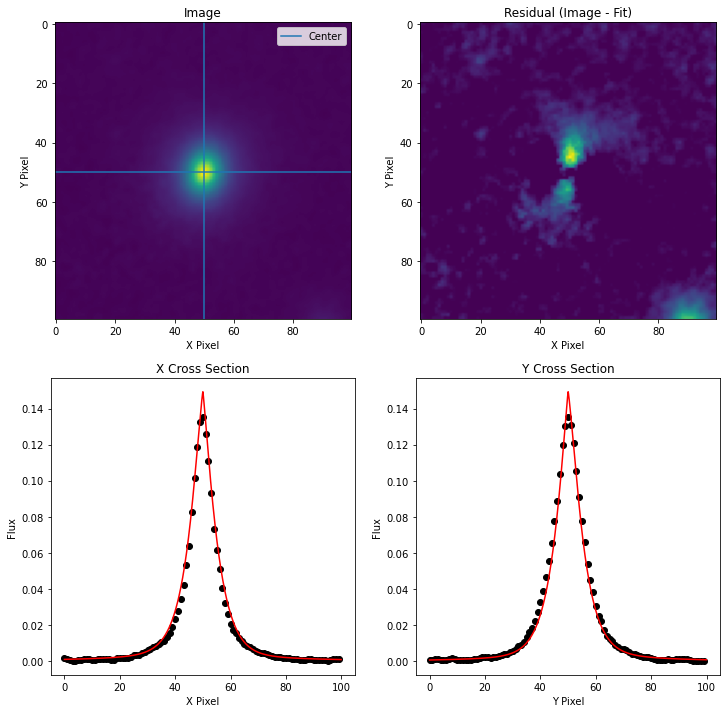

Label: 183


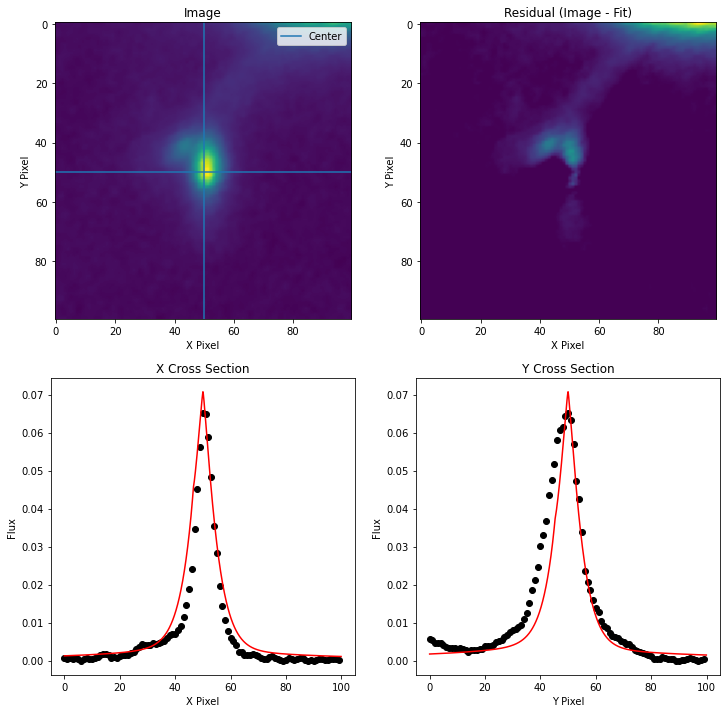

Label: 182


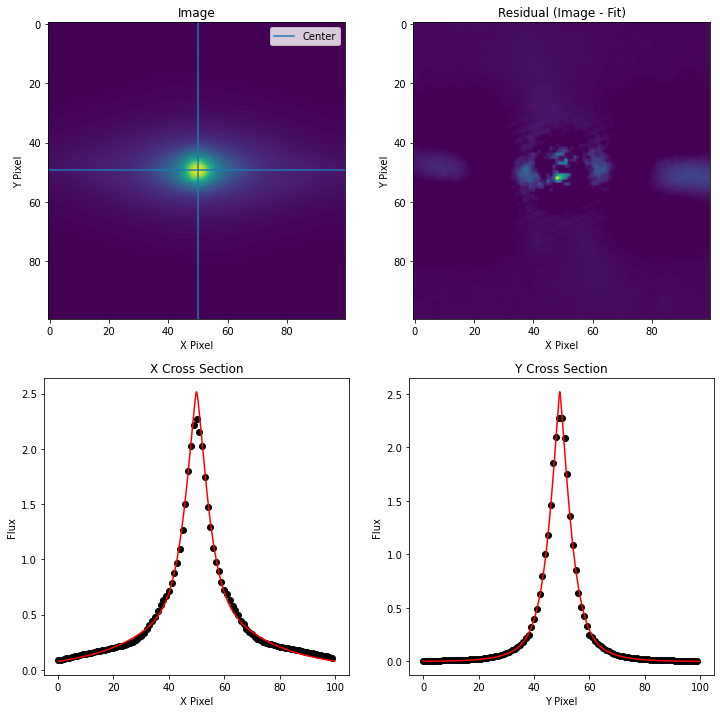

Label: 180


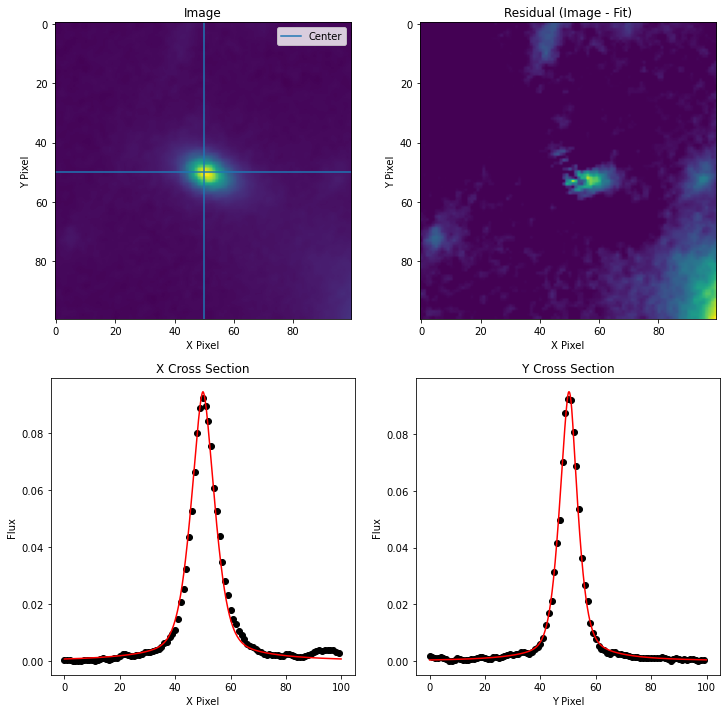

Label: 178


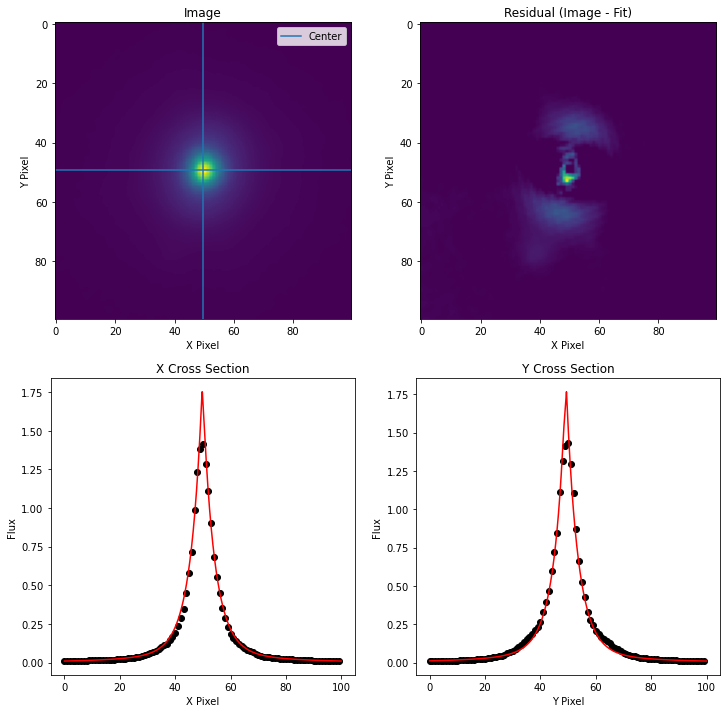

Label: 175


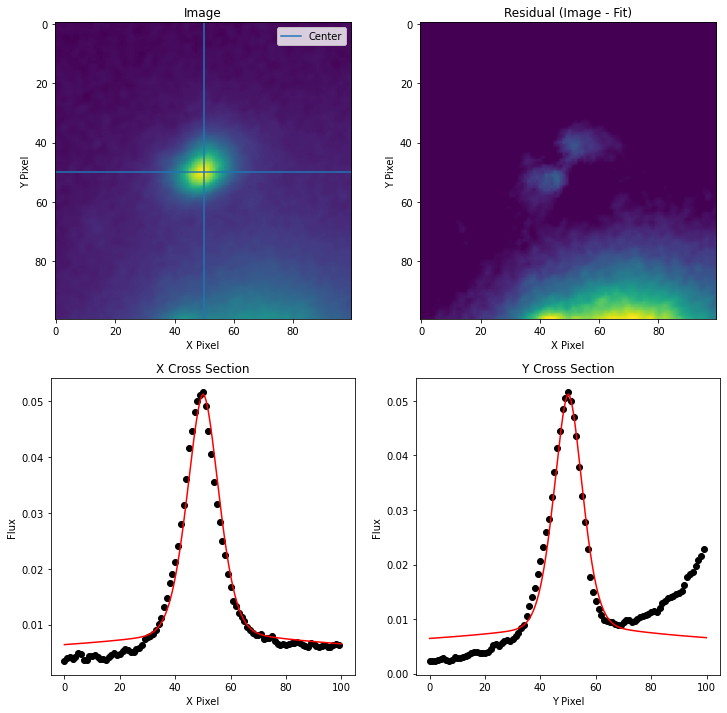

Label: 174


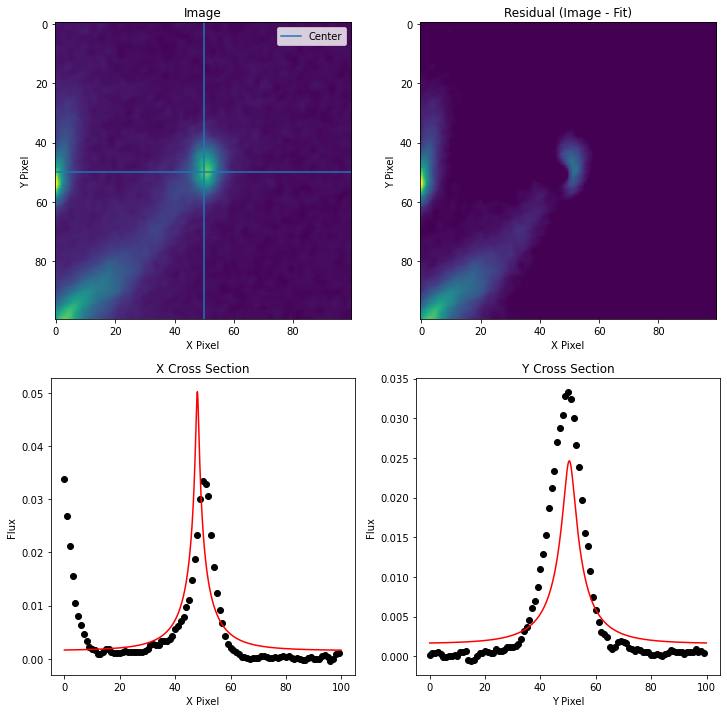

Label: 172


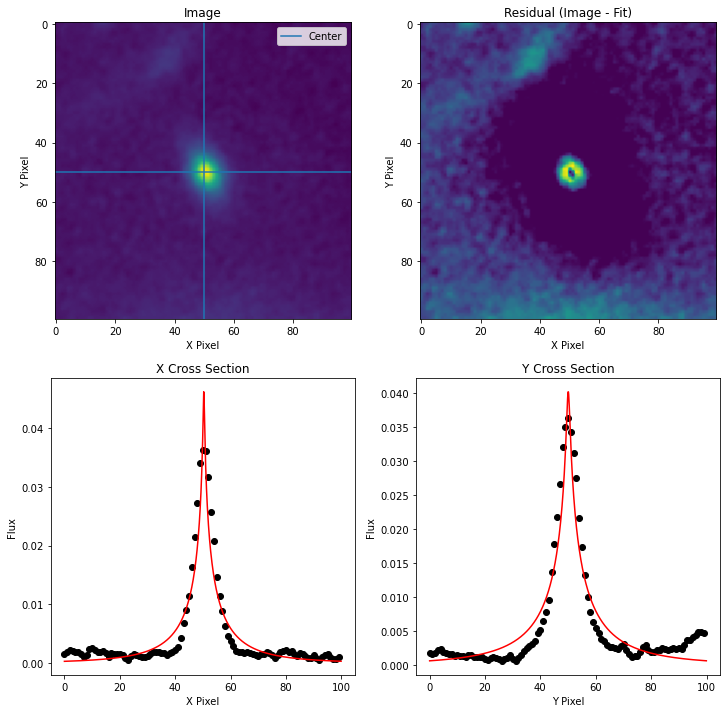

Label: 171


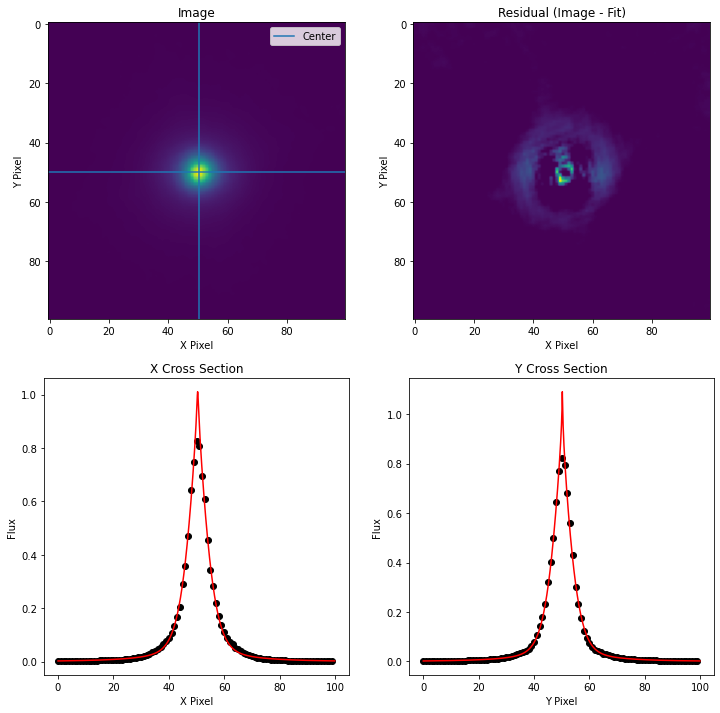

Label: 170


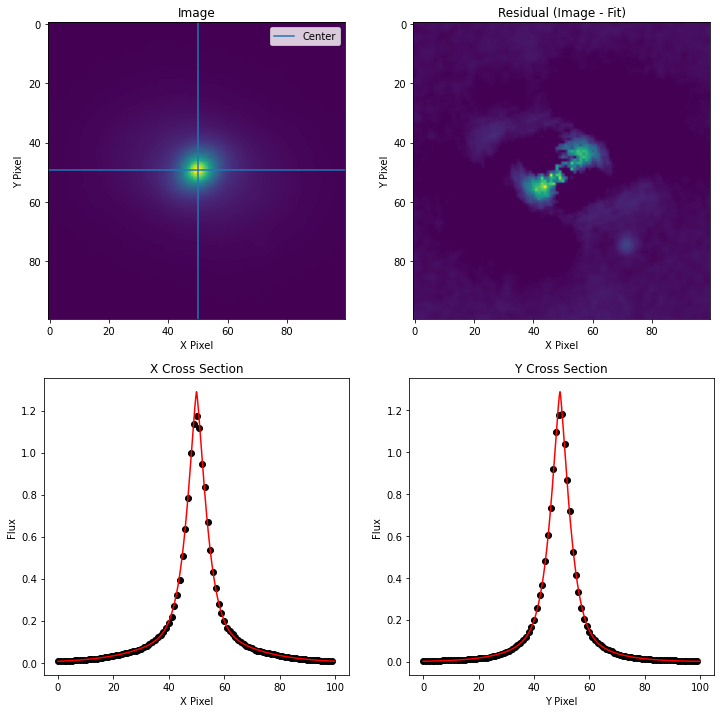

Label: 167


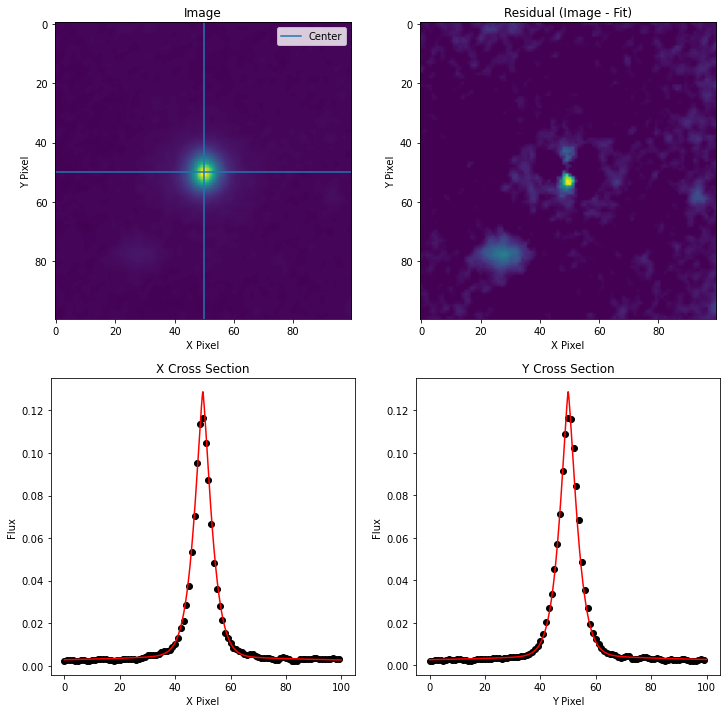

Label: 164


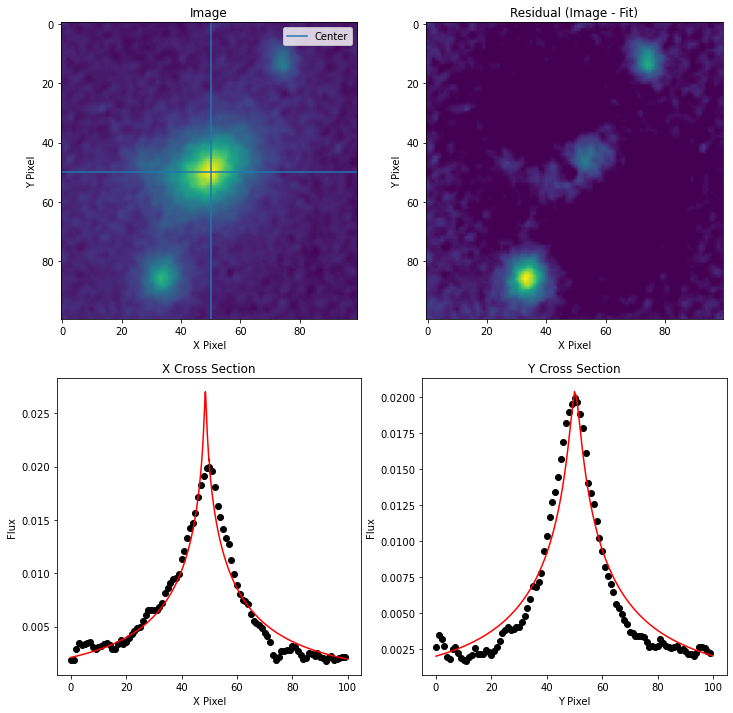

Label: 163


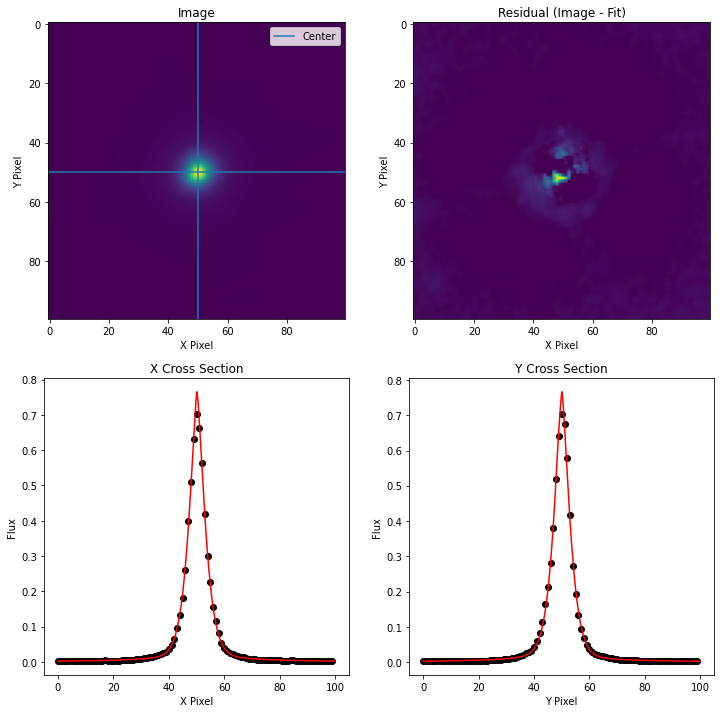

Label: 161


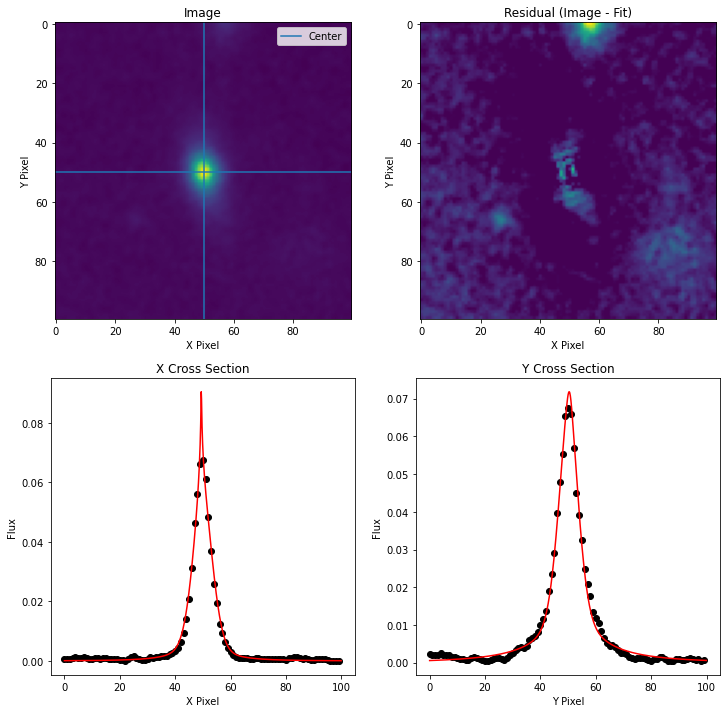

Label: 159


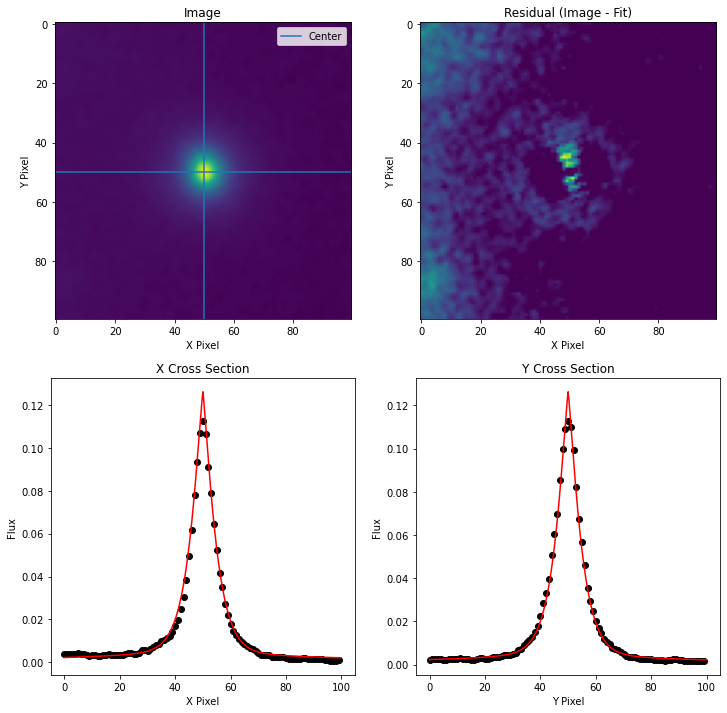

Label: 158


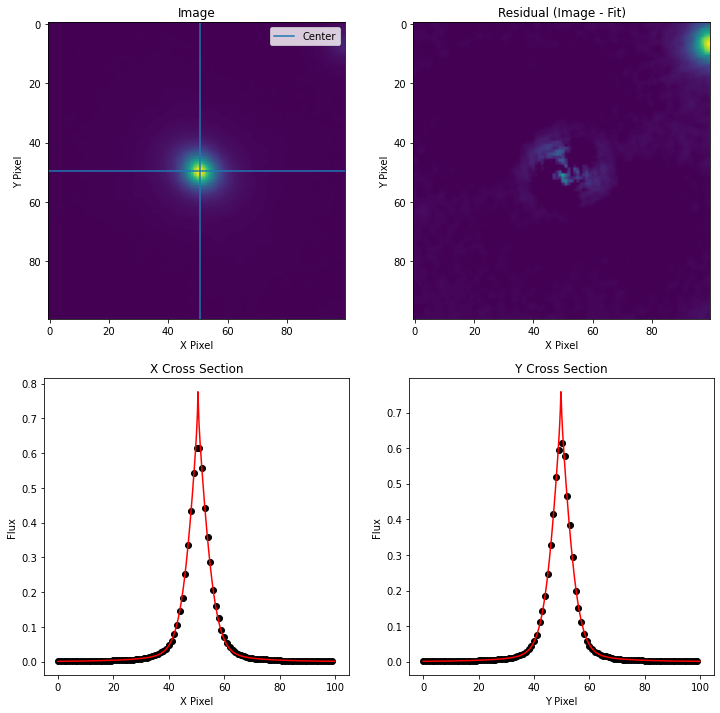

Label: 157


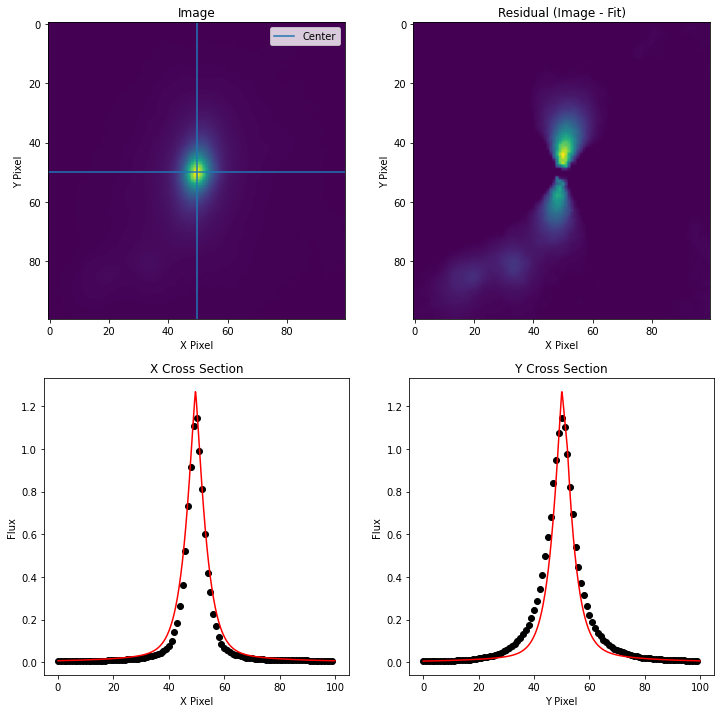

Label: 156


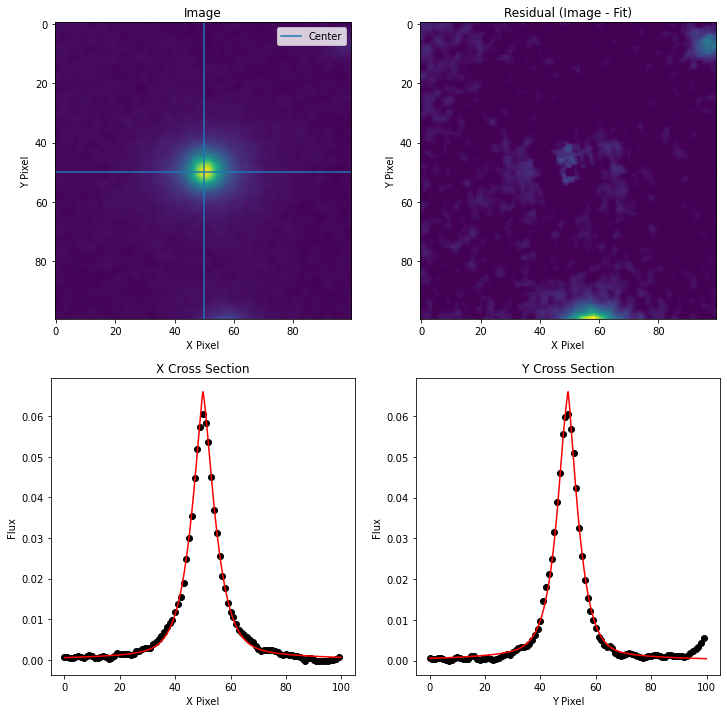

Label: 155


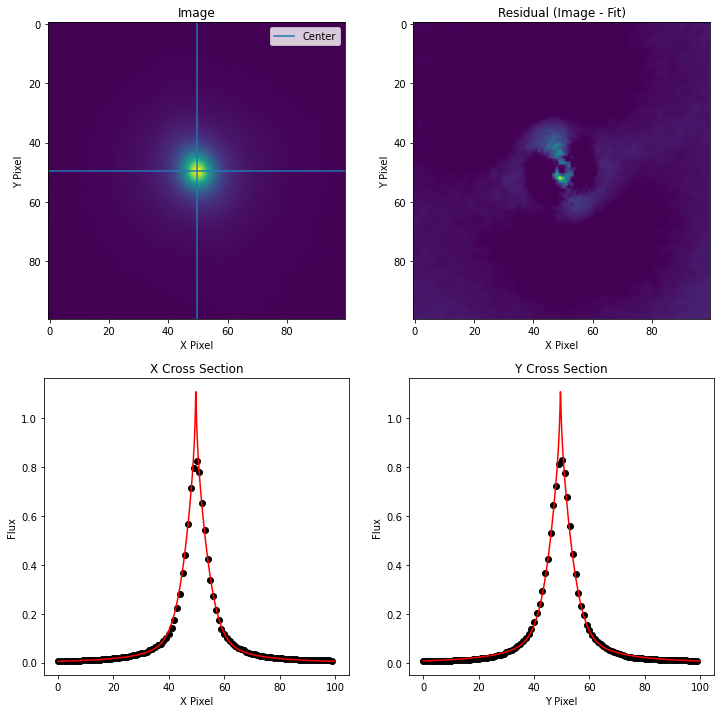

Label: 154


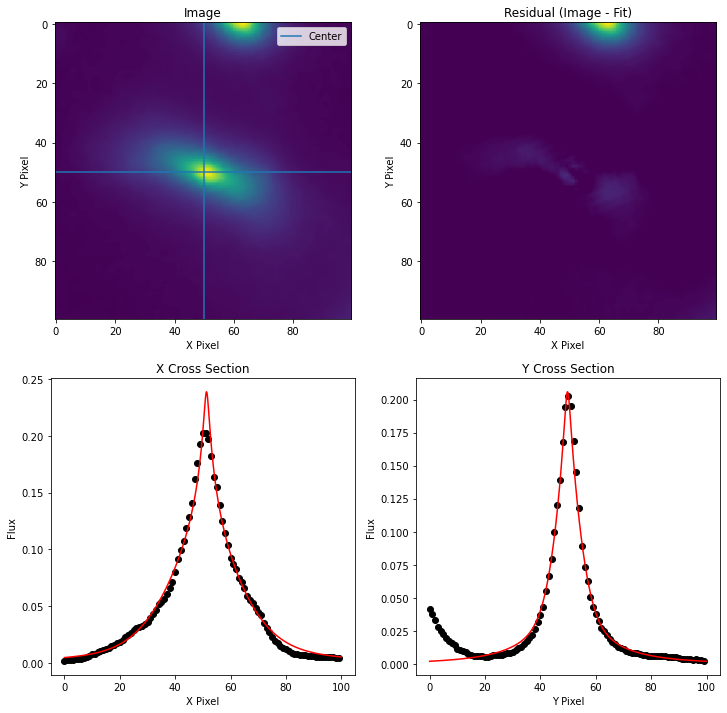

Label: 151


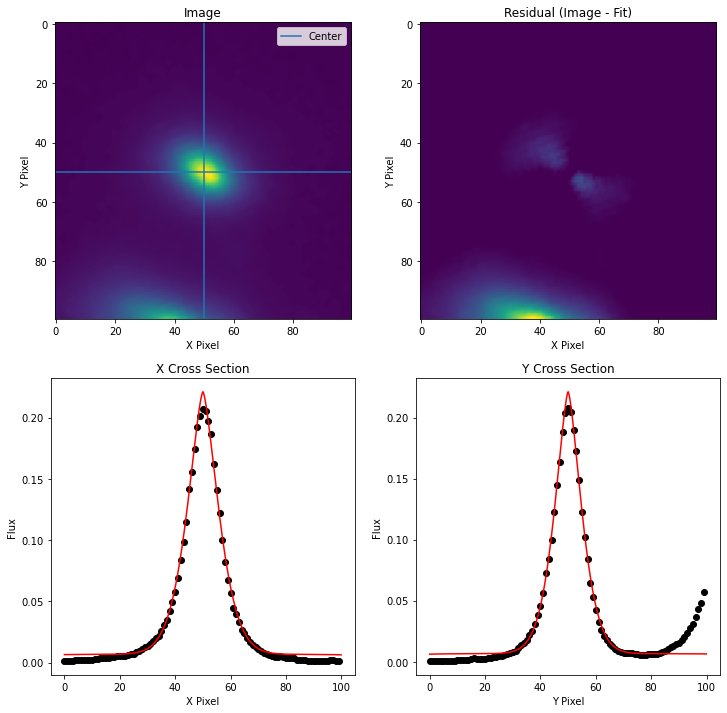

Label: 148


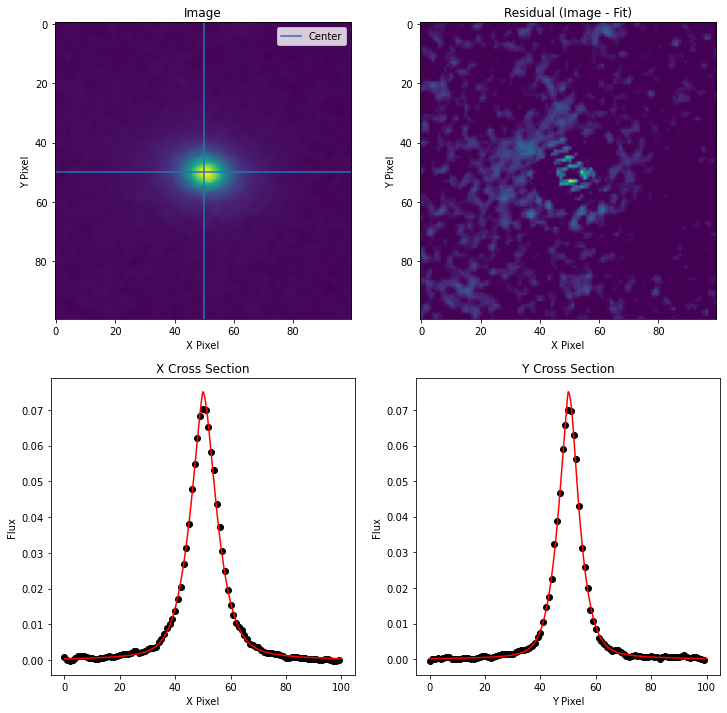

Label: 147


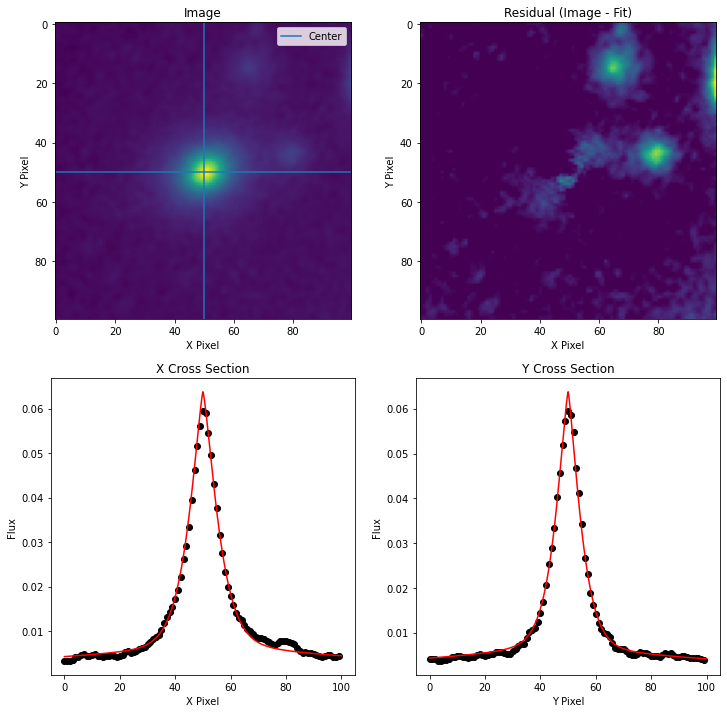

Label: 146


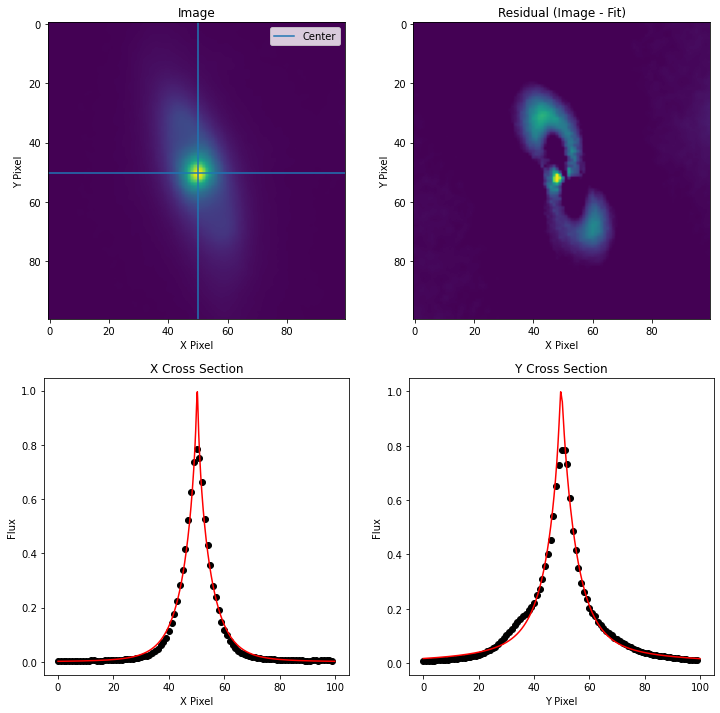

Label: 143


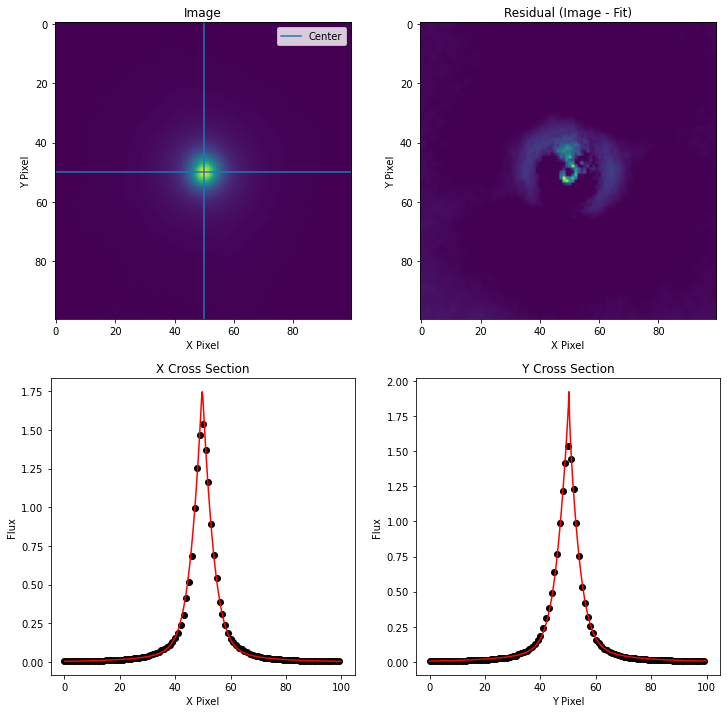

Label: 139


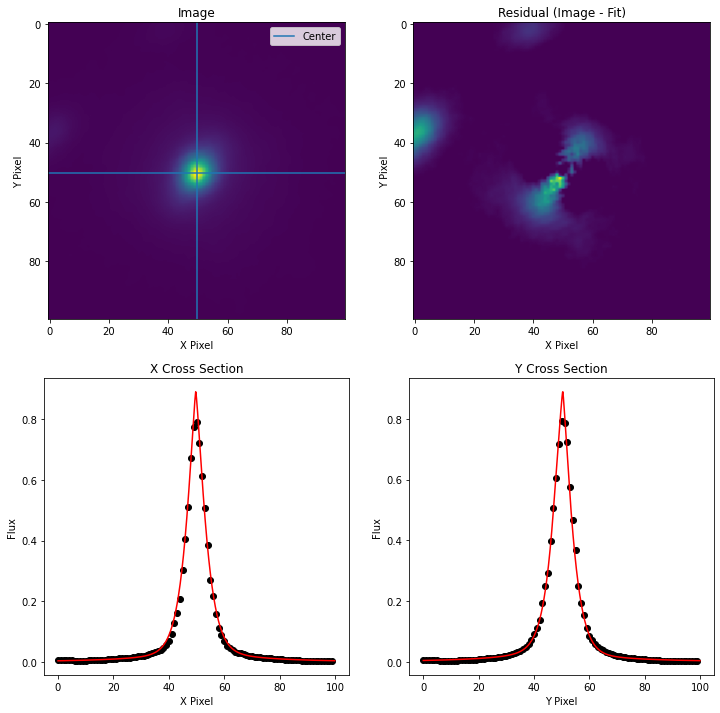

Label: 134


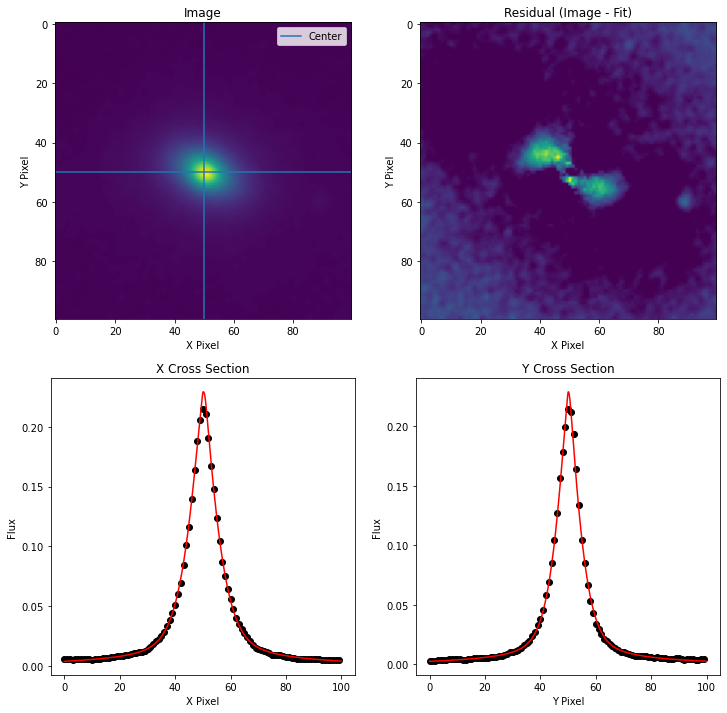

Label: 128


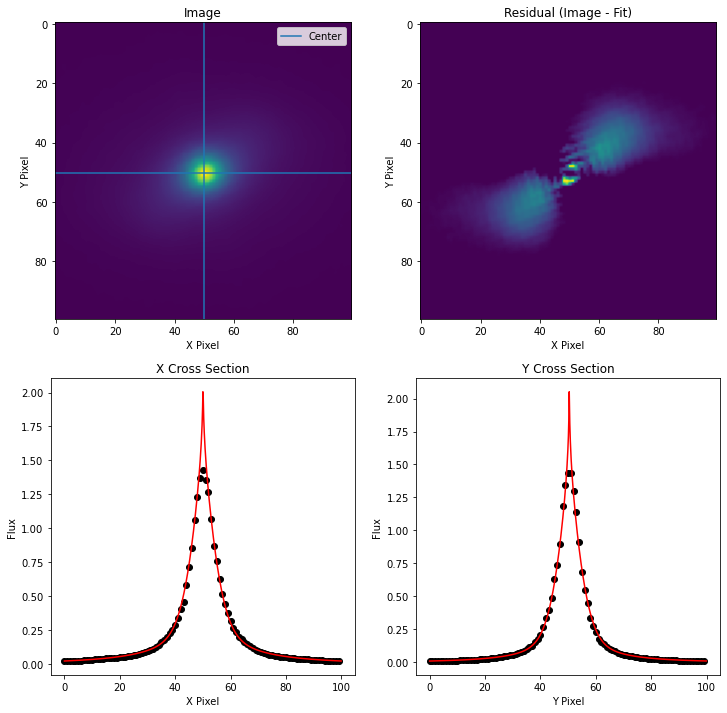

Label: 126


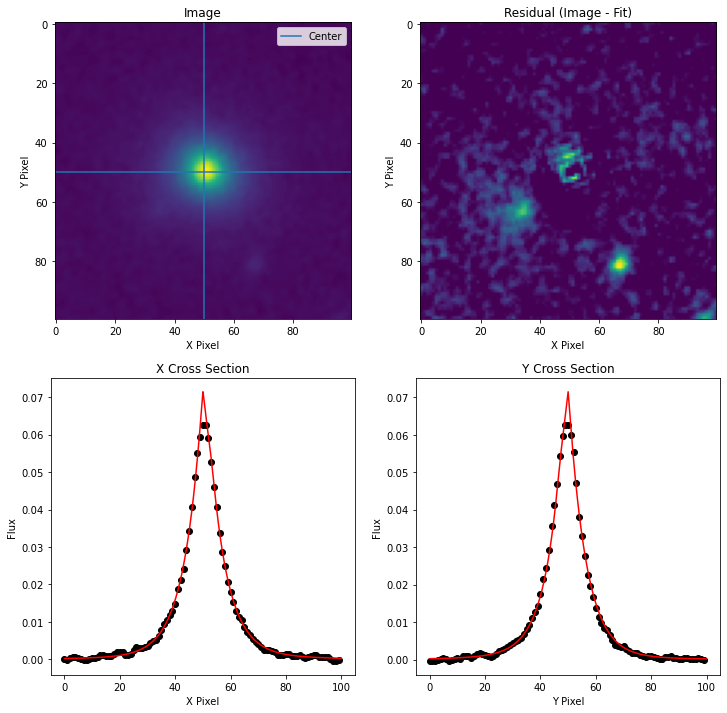

Label: 122


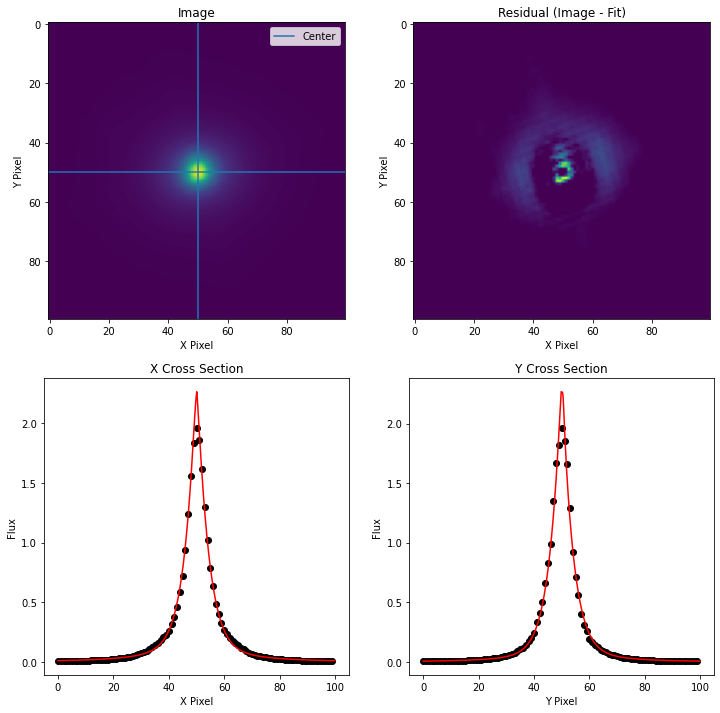

Label: 121


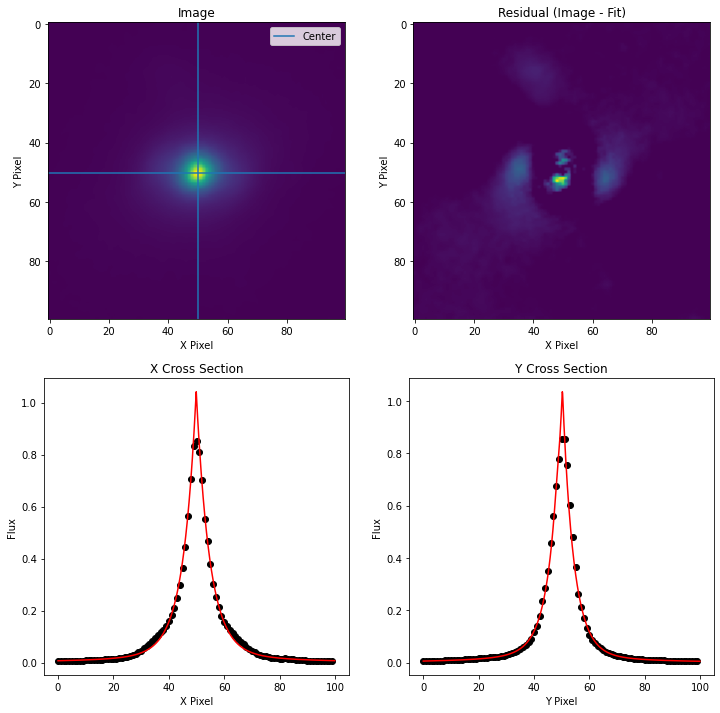

Label: 120


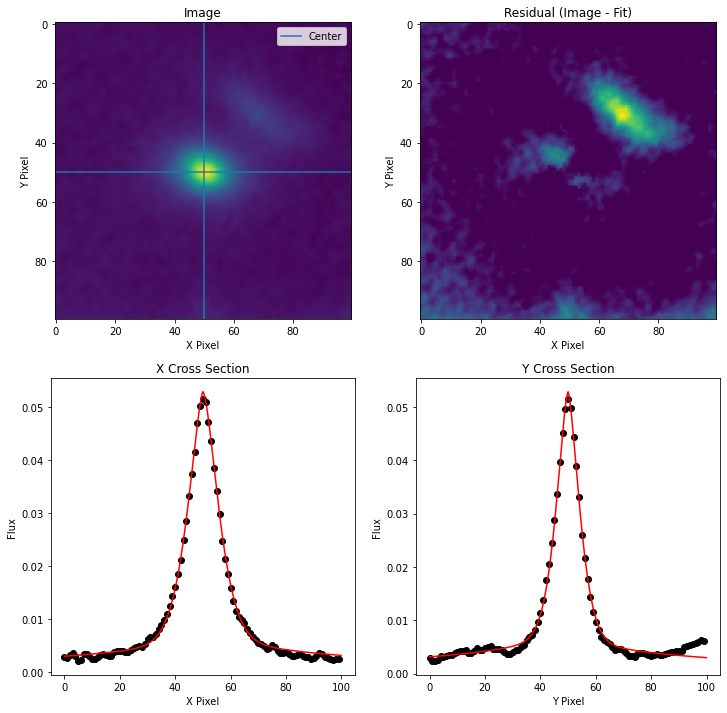

In [ ]:
temp_cat = list(reversed(cat[:])) #[21:22]

pb = widgets.IntProgress(
        value=0,
        min=0,
        max=len(temp_cat),
        step=1,
        description='Loading:',
        bar_style='', # 'success', 'info', 'warning', 'danger' or ''
        orientation='horizontal'
)

display(pb)

image_copy = image.copy()
pb.description = "{}/{}".format(0, len(temp_cat))
for i, obj in enumerate(temp_cat):
    pb.value = i + 1
    pb.description = "{}/{}".format(pb.value, len(temp_cat))

    #x, y = np.transpose((obj.xcentroid.value, obj.ycentroid.value)).astype(int)
    cut = obj.segment.make_cutout(image, masked_array=True)
    cy, cx = np.unravel_index(cut.argmax(), cut.shape)
    #cy, cx = np.round(obj.centroid.value).astype(int)
    amp = cut.data.max() #cutout(temp, temp.shape[1]//2, temp.shape[0]//2, 6).mean()
    x = obj.segment.bbox.ixmin + cx
    y = obj.segment.bbox.iymin + cy
    
    size = int(max(obj.bbox_xmax - obj.bbox_xmin, obj.bbox_ymax - obj.bbox_ymin).value)
    size = int(obj.equivalent_radius.value)
    size = 40#int(obj.equivalent_radius.value)
    
    plt.show()
    
    if size > 100:
        continue
  
    temp_zoom = cutout(image, x, y, 60)
    
    #size = int(2 * np.mean(measure_fwhm(temp_zoom, plot=False)))
    size = int(np.clip(size, 40, 200))
    size = 50
    
    temp_zoom = cutout(image, x, y, int(size))
    
    try:
        with warnings.catch_warnings():
            warnings.simplefilter('ignore', AstropyWarning)    
            
            y_mean, x_mean = np.array(temp_zoom.shape) // 2
            
            """
            model, fit = fit_sersic2d(
                                      temp_zoom,
                                      amplitude=amp,
                                      n=2,
                                      r_eff=obj.equivalent_radius.value/4,
                                      ellip=0.0,
                                      theta=0.0, #)
                                      #fixed = {'amplitude':True},
                                      bounds={
                                          'amplitude':(0, None),
                                          'r_eff':(0, None),
                                          'x_0': (x_mean-5, x_mean+5),
                                          'y_0': (y_mean-5, y_mean+5),
                                             })

            model = models.Sersic2D(
                amplitude=amp,
                n=2,
                r_eff=obj.equivalent_radius.value/4,
                ellip=0.0,
                theta=0.0,
                x_0 = x_mean,
                y_0 = y_mean,
                bounds={
                      'amplitude':(0, None),
                      'r_eff':(0, None),
                      'x_0': (x_mean-5, x_mean+5),
                      'y_0': (y_mean-5, y_mean+5),
                         })
            """


            model = models.Sersic2D(
                            amplitude=amp,
                            r_eff=obj.equivalent_radius.value/4,
                            n=2,
                            x_0=x_mean,
                            y_0=y_mean,
                            ellip=0,
                            theta=0,
                            bounds={
                                  'amplitude':(0, None),
                                  'r_eff':(0, None),
                                  'n':(0, 6),
                                  'ellip':(0, 1),
                                  'theta':(0, 2*np.pi),
                                  'x_0': (x_mean-25, x_mean+25),
                                  'y_0': (y_mean-25, y_mean+25),
                                     }
                            )
            
            model, fit = fit_model(temp_zoom, model)
            
            err = fit.fit_info['param_cov']
            err = err.mean() if err is not None else 1e10
            err = find_chi2(temp_zoom, model)
            #plot_fit(temp_zoom, model)
            #plt.show()


            if err > 100 or model.r_eff < 1:
                #break
                pass
                #continue
            
            #amp = temp_zoom[int(model.y_0.value), int(model.x_0.value)] 
            #model.amplitude=amp
            model.fixed['x_0'] = True 
            model.fixed['y_0'] = True 
            #for pn in model.param_names:
            #    model.fixed[pn] = True 
           
            
            size = 100 
            #size = 2*size#int(4 * np.mean(measure_fwhm(temp, plot=False)))
            #size = int(np.clip(size, 40, 200))
            #size = int(np.clip(size*3, 0, 200))
            temp = cutout(image, x, y, size)

            model.x_0 -= x_mean
            model.y_0 -= y_mean
            
            y_mean, x_mean = np.array(temp.shape) // 2
            
            model.x_0 += x_mean
            model.y_0 += y_mean
            
            
            # Second fit ---------------------------
            
            model, fit = fit_double_sersic2d(
                  temp,
                  amplitude=0.,
                  n=1,
                  r_eff=size,
                  ellip=model.ellip,
                  theta=obj.orientation.to('rad').value, #)
                  #fixed = {'x_0':True, 'y_0':True},
                  bounds={
                      'amplitude':(0, None),
                      'r_eff':(0, None),
                      'n':(0, 2),
                      'ellip':(0, 1),
                      'theta':(0, 2*np.pi),
                      'x_0': (x_mean-2, x_mean+2),
                      'y_0': (y_mean-2, y_mean+2),
                         },
                 model1=model
            )

            
            model, fit = fit_model(temp, model)
            """

            model, fit = fit_gaussian2d(temp, fixed = {'amplitude':True})
            model.x_0 = model.x_mean
            model.y_0 = model.y_mean
            """
            
            ierr = fit.fit_info['ierr']
            #err = fit.fit_info['param_cov']
            #err = err.mean() if err is not None else 1e10
            #err = find_chi2(temp, model_image)
            err = find_chi2(temp, model)
            #print(err, "\n"*2)
            
            if err < 30:
                """
                y_arange, x_arange = np.mgrid[
                    model.y_0-temp.shape[1]//2:model.y_0+temp.shape[1]//2,
                    model.x_0-temp.shape[0]//2:model.x_0+temp.shape[0]//2,]
        
                model_image = model(x_arange, y_arange)
                

                # Make x and y grid to plot to
                y_arange, x_arange = np.mgrid[
                    model.y_0-temp.shape[1]*2:model.y_0+temp.shape[1]*2,
                    model.x_0-temp.shape[0]*2:model.x_0+temp.shape[0]*2, 
                                              ]
                """
                size = 100#int(np.clip(np.ceil(model.r_eff_1*8), 0, 500))
                y_arange, x_arange = np.mgrid[
                    int(model.y_0.value)-size:int(model.y_0.value)+size,
                    int(model.x_0.value)-size:int(model.x_0.value)+size, ]
                
                model_image = model(x_arange, y_arange)
                image_copy = model_subtract(image_copy, np.array(model_image), x, y)
                
                image_copy[y-8:y+8, x-8:x+8] = 0. #image_copy[y-80:y+80, x-80:x+80].mean()

                print("Label:", obj.label)
                
                
                plot_fit(temp, model)
                plt.show()
                #print("\n")
                #break
                
                           
    except Exception as e:
        if isinstance(e, KeyboardInterrupt):
            raise e
        print(e)
        plot_fit(temp, model)
        plt.show()
        raise e 
        
   
        
print("Done")

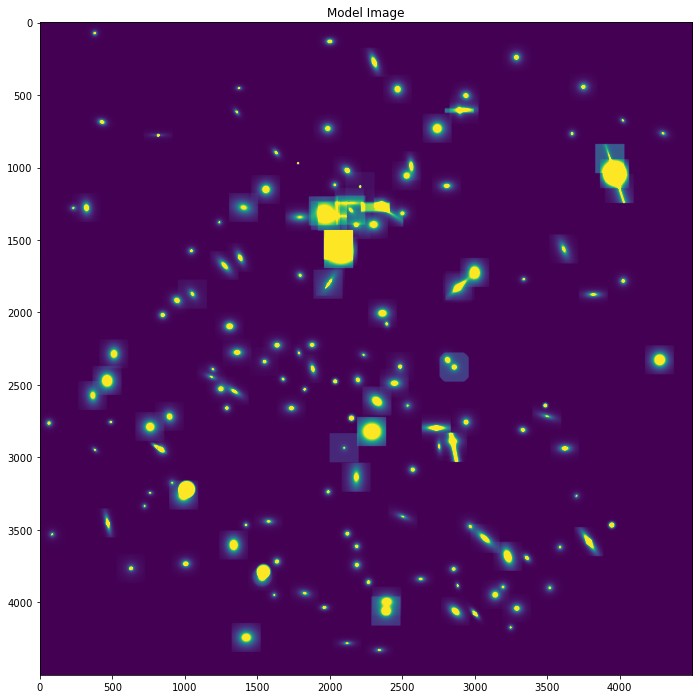

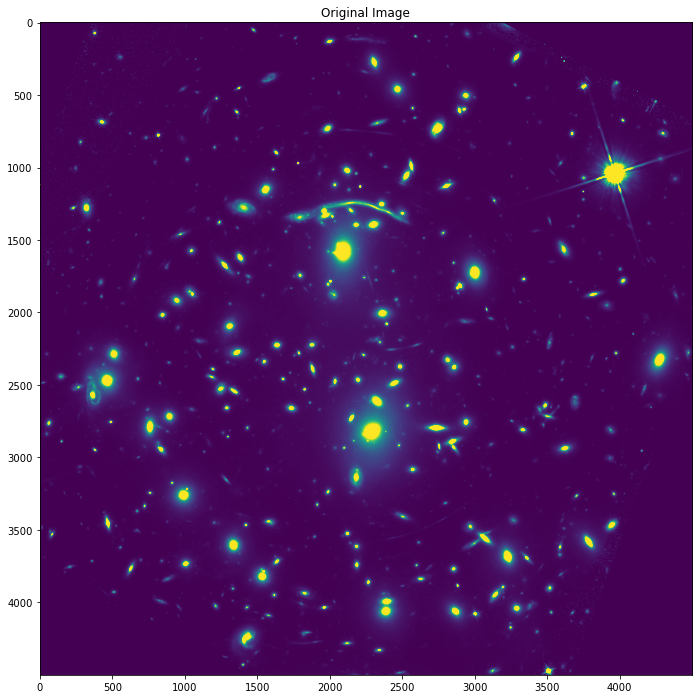

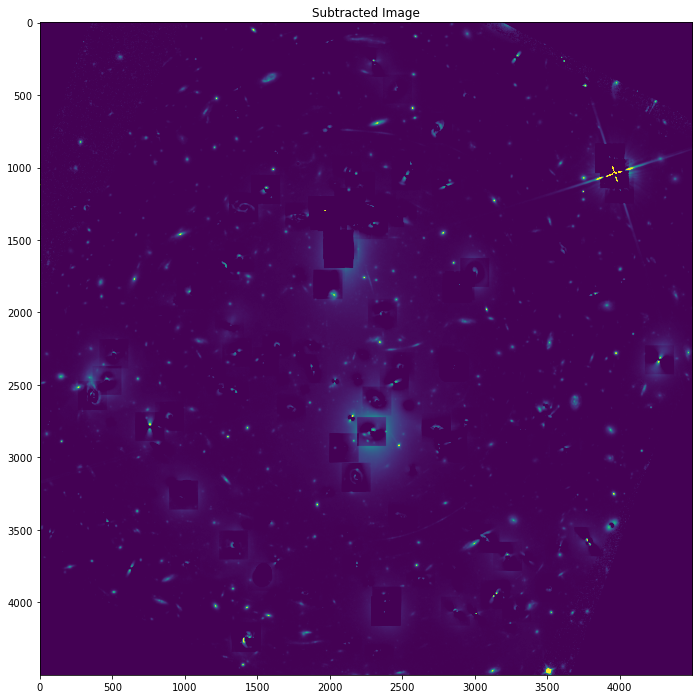

In [193]:
vmax = mean_noise*300
vmin = 0#np.unique(threshold)[0]
plt.imshow(image-image_copy, vmin=vmin, vmax=vmax)
plt.title("Model Image")
plt.show()


plt.imshow(image, vmin=vmin, vmax=vmax)
plt.title("Original Image")
plt.show()

plt.imshow(image_copy, vmin=vmin, vmax=vmax)
plt.title("Subtracted Image")
plt.show()

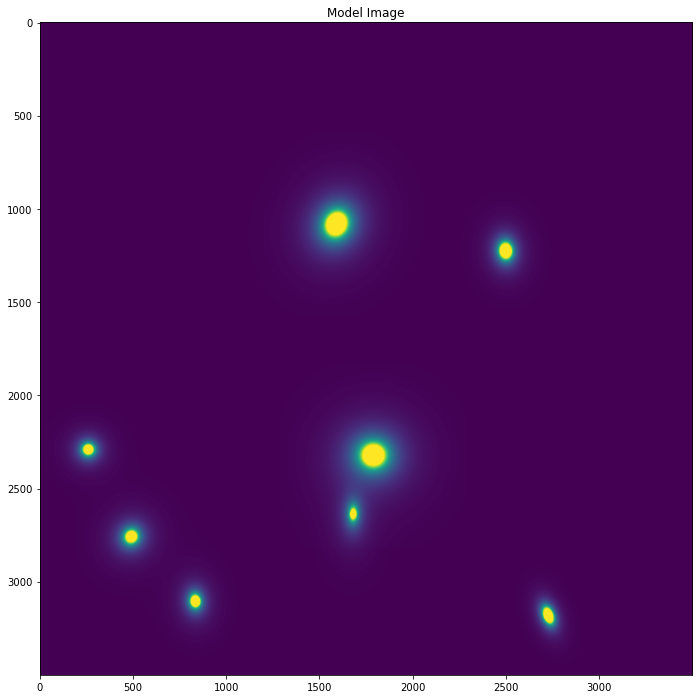

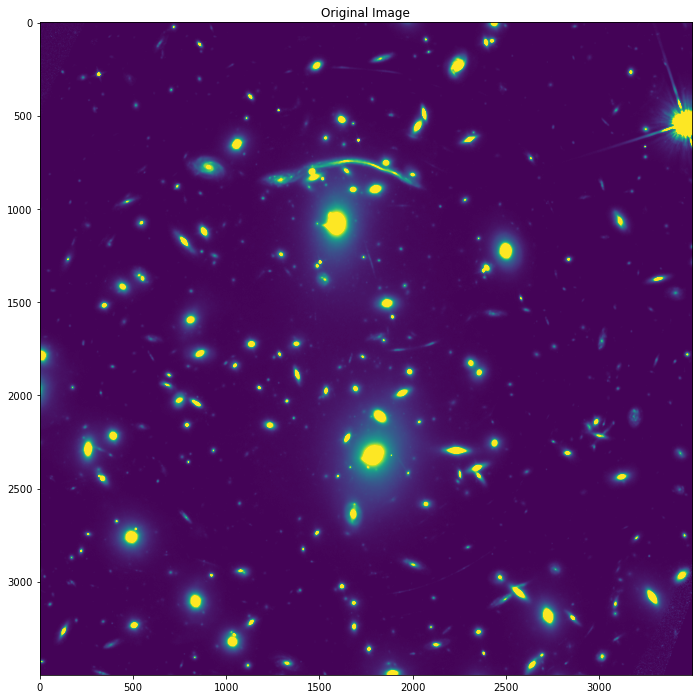

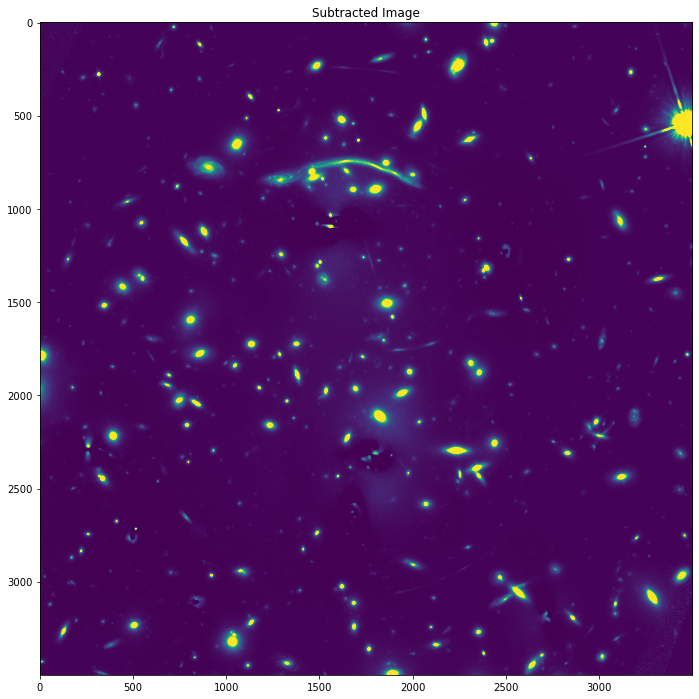

In [90]:
vmax = mean_noise*300
vmin = 0#np.unique(threshold)[0]
plt.imshow(image-image_copy, vmin=vmin, vmax=vmax)
plt.title("Model Image")
plt.show()


plt.imshow(image, vmin=vmin, vmax=vmax)
plt.title("Original Image")
plt.show()

plt.imshow(image_copy, vmin=vmin, vmax=vmax)
plt.title("Subtracted Image")
plt.show()

In [95]:
image = image_copy

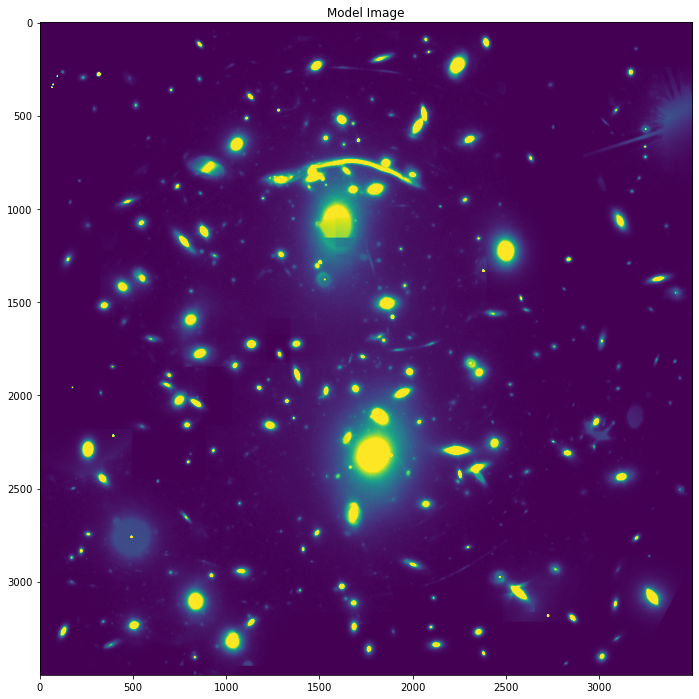

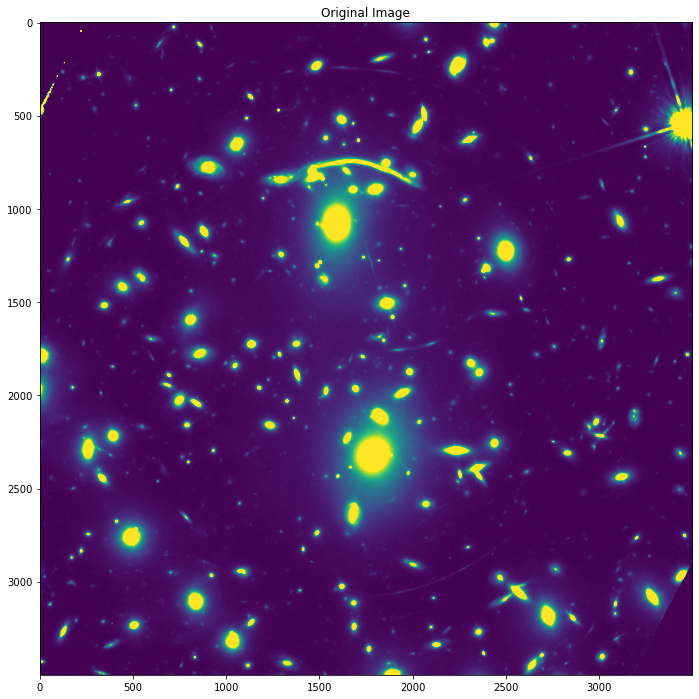

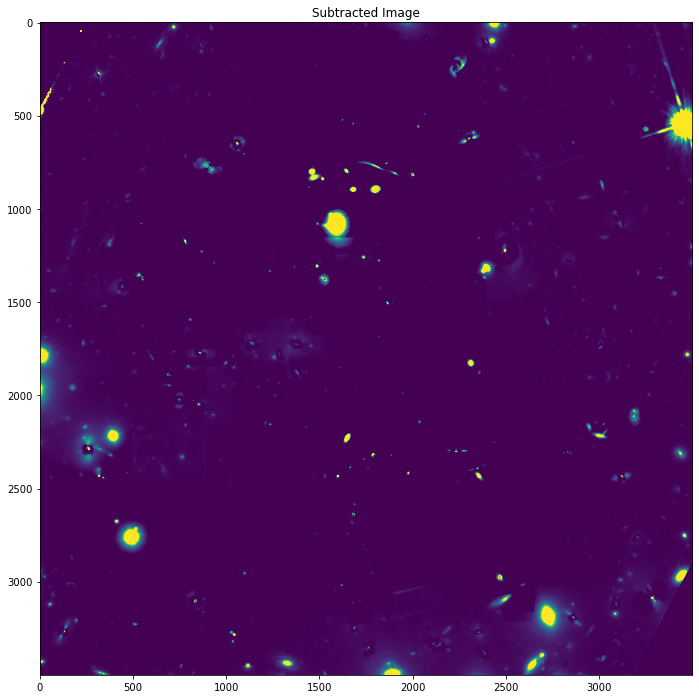

In [1175]:
vmax = mean_noise*200
vmin = 0#np.unique(threshold)[0]
plt.imshow(image-image_copy, vmin=vmin, vmax=vmax)
plt.title("Model Image")
plt.show()


plt.imshow(image, vmin=vmin, vmax=vmax)
plt.title("Original Image")
plt.show()

plt.imshow(image_copy, vmin=vmin, vmax=vmax)
plt.title("Subtracted Image")
plt.show()

In [1177]:
image = image_copy

## Pass 0

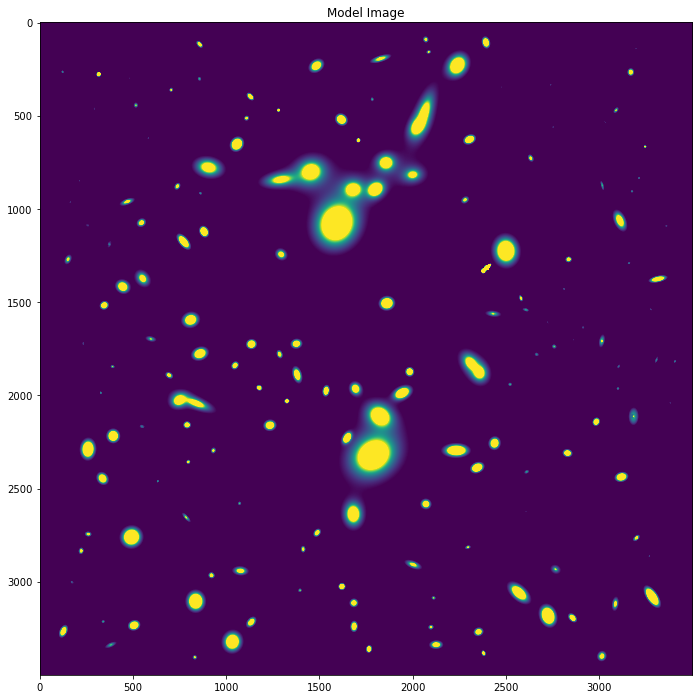

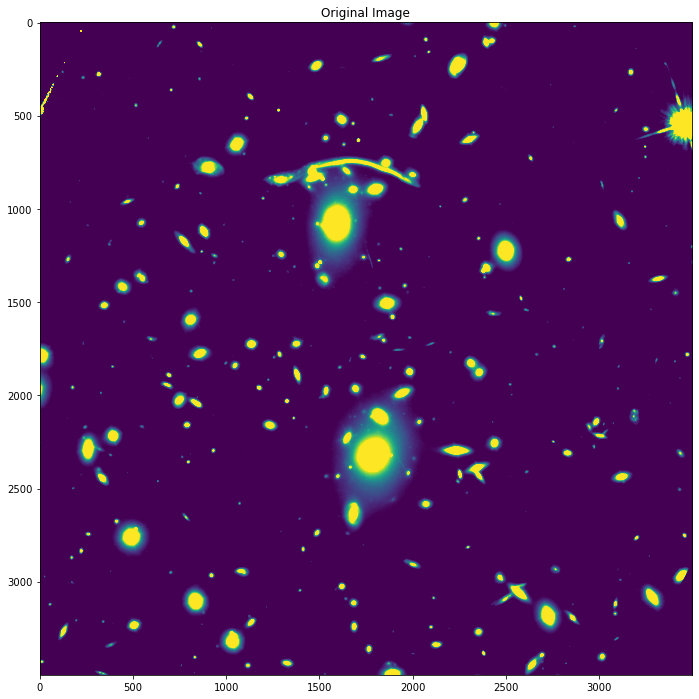

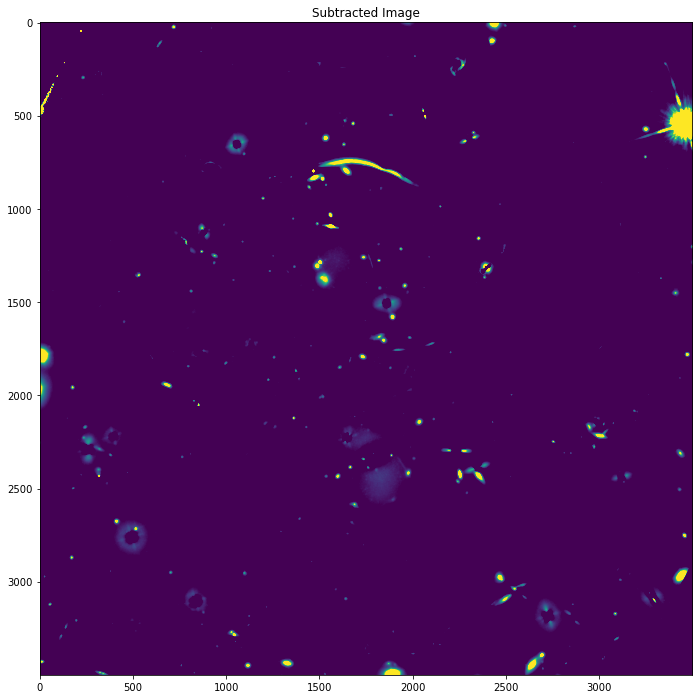

In [657]:
vmax = mean_noise*200
vmin = np.unique(threshold)[0]
plt.imshow(image-image_copy, vmin=vmin, vmax=vmax)
plt.title("Model Image")
plt.show()


plt.imshow(image, vmin=vmin, vmax=vmax)
plt.title("Original Image")
plt.show()

plt.imshow(image_copy, vmin=vmin, vmax=vmax)
plt.title("Subtracted Image")
plt.show()

## Pass 1

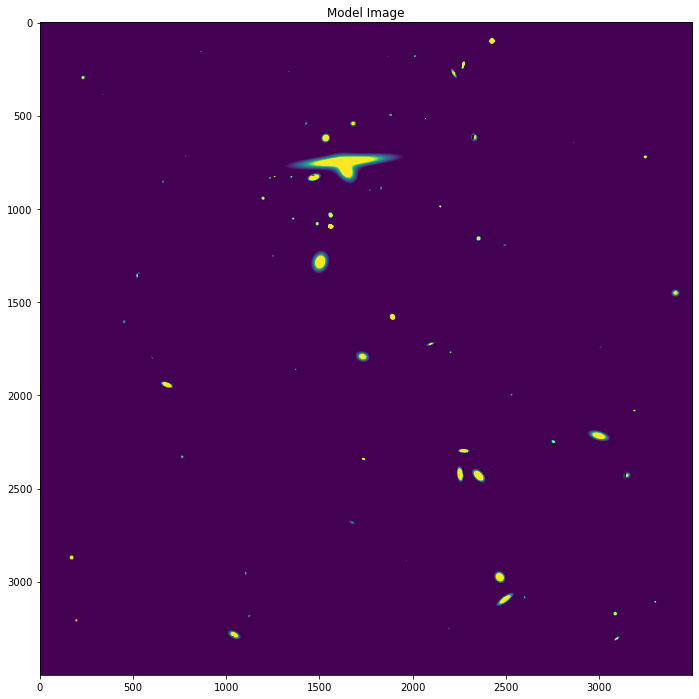

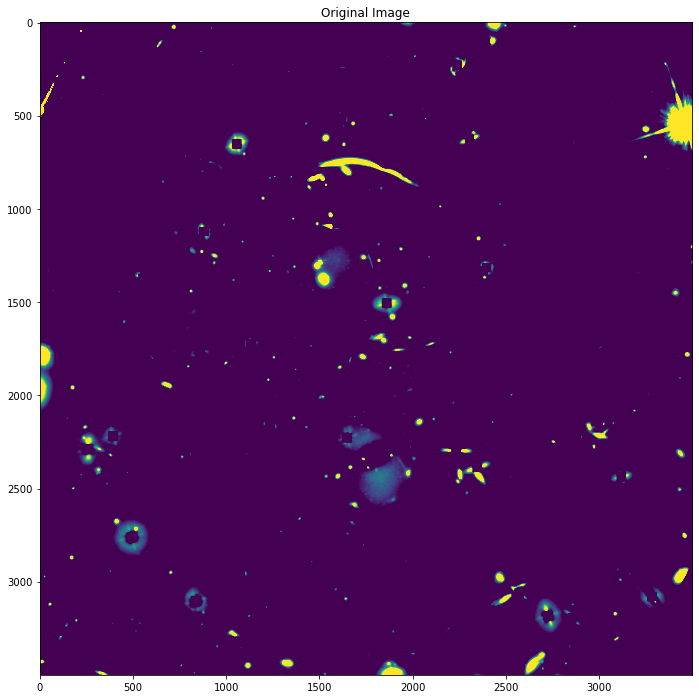

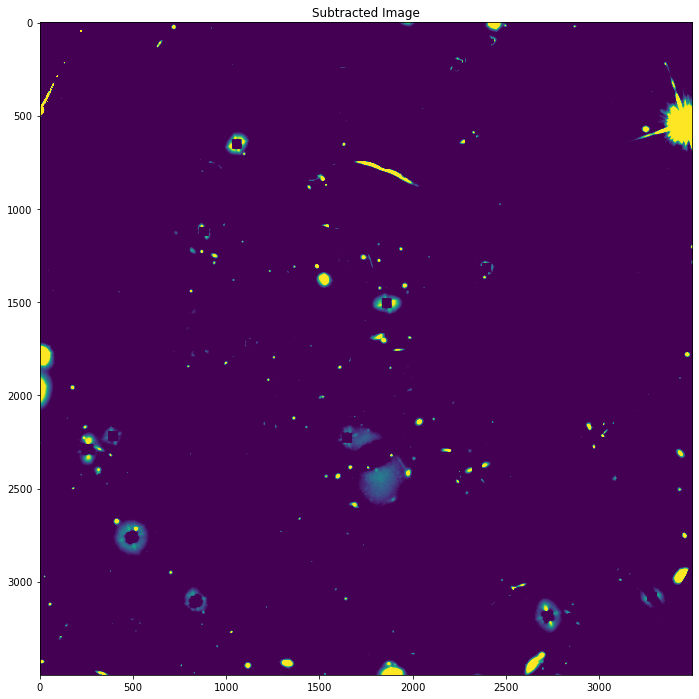

In [598]:
vmax = mean_noise*100
vmin = np.unique(threshold)[0]
plt.imshow(image-image_copy, vmin=vmin, vmax=vmax)
plt.title("Model Image")
plt.show()


plt.imshow(image, vmin=vmin, vmax=vmax)
plt.title("Original Image")
plt.show()

plt.imshow(image_copy, vmin=vmin, vmax=vmax)
plt.title("Subtracted Image")
plt.show()

## Pass 2

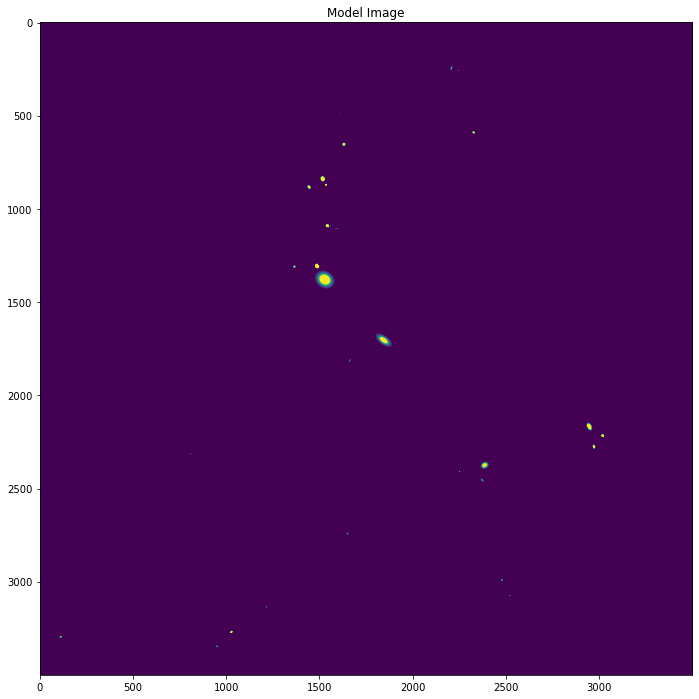

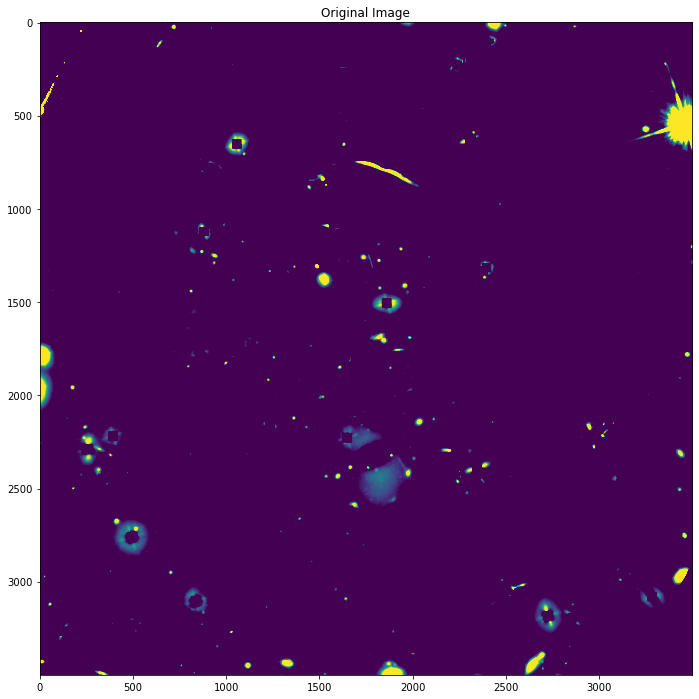

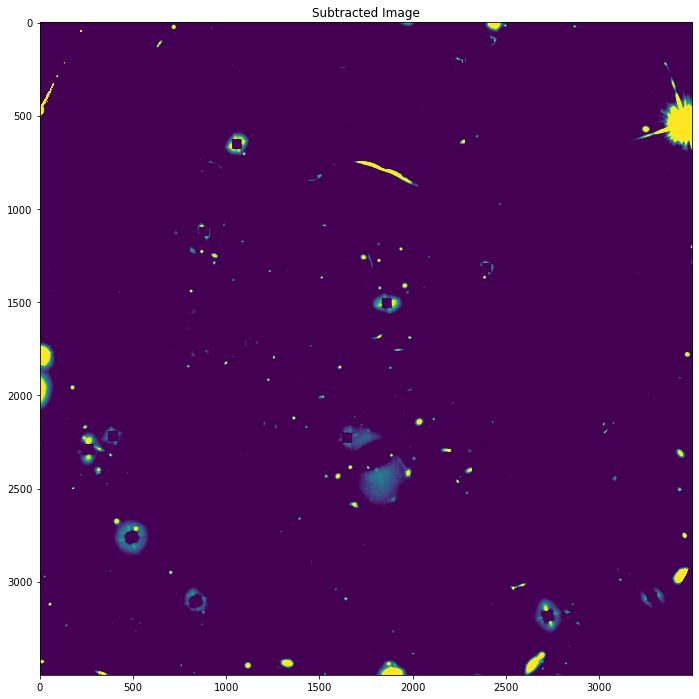

In [611]:
vmax = mean_noise*100
vmin = np.unique(threshold)[0]
plt.imshow(image-image_copy, vmin=vmin, vmax=vmax)
plt.title("Model Image")
plt.show()


plt.imshow(image, vmin=vmin, vmax=vmax)
plt.title("Original Image")
plt.show()

plt.imshow(image_copy, vmin=vmin, vmax=vmax)
plt.title("Subtracted Image")
plt.show()

## Pass 3

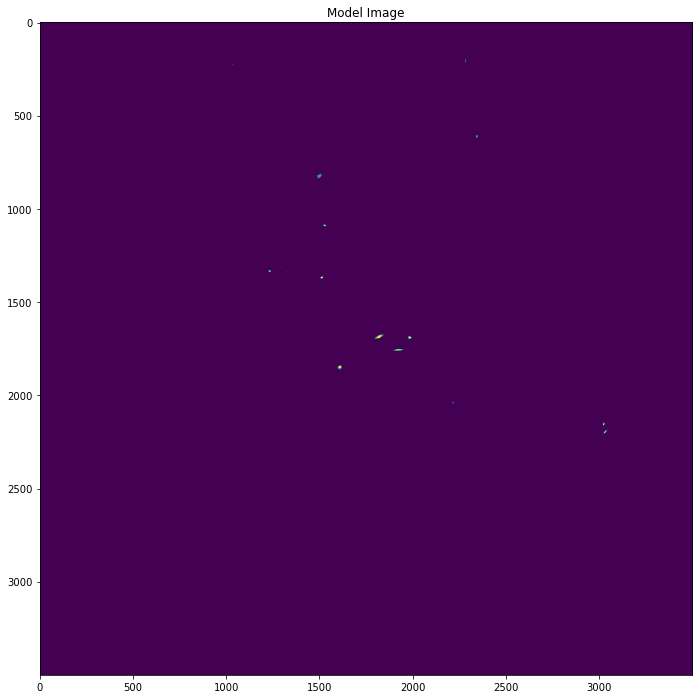

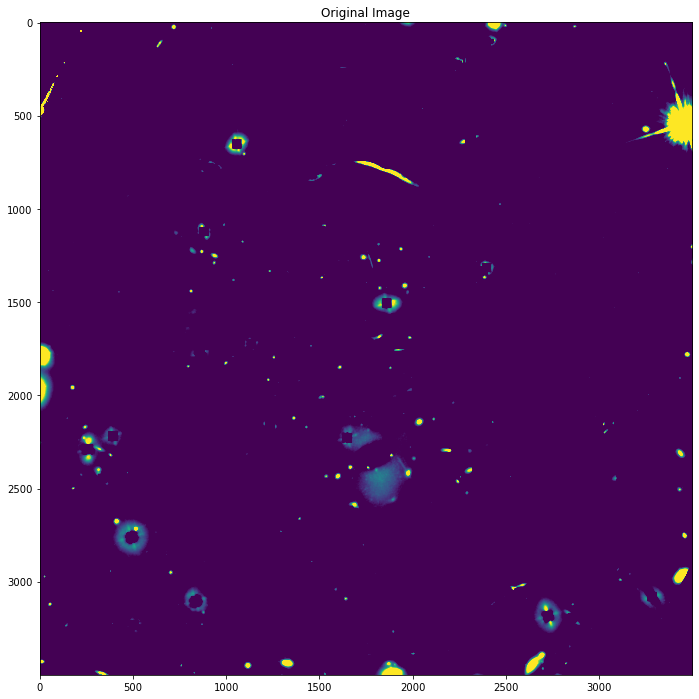

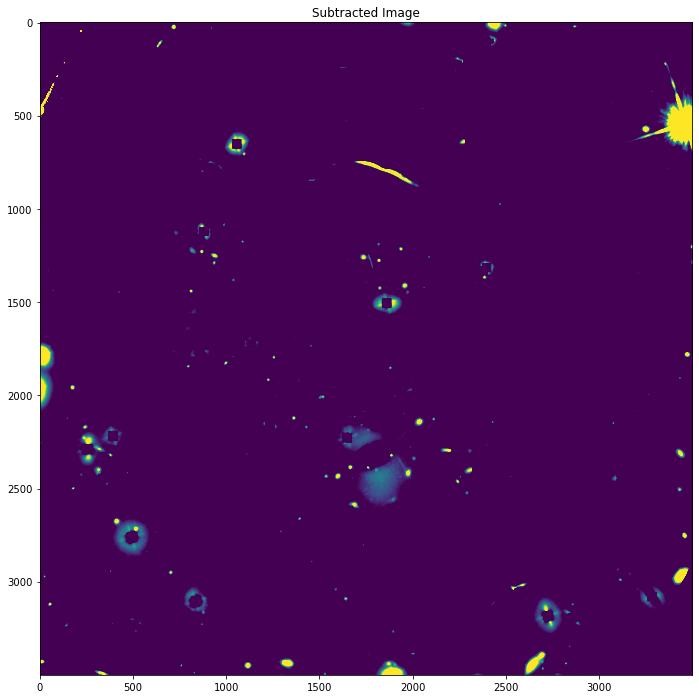

In [634]:
vmax = mean_noise*100
vmin = np.unique(threshold)[0]
plt.imshow(image-image_copy, vmin=vmin, vmax=vmax)
plt.title("Model Image")
plt.show()


plt.imshow(image, vmin=vmin, vmax=vmax)
plt.title("Original Image")
plt.show()

plt.imshow(image_copy, vmin=vmin, vmax=vmax)
plt.title("Subtracted Image")
plt.show()

# Pass End

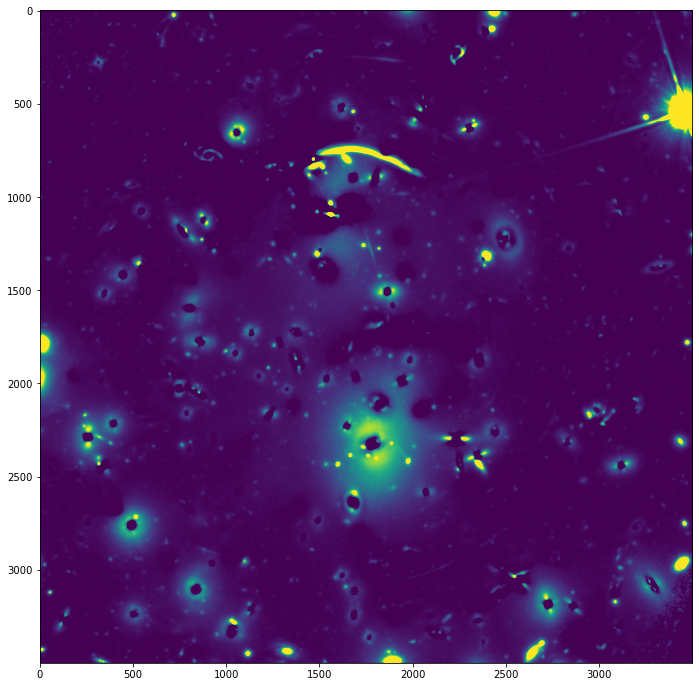

In [393]:
from astropy.convolution import convolve, convolve_fft
from astropy.convolution import Gaussian2DKernel

gauss = Gaussian2DKernel(int(10*gaussian_fwhm_to_sigma))
gauss.normalize()
gauss *= image.max()

plt.imshow(convolve_fft(image_copy, gauss), vmin=0, vmax=vmax)



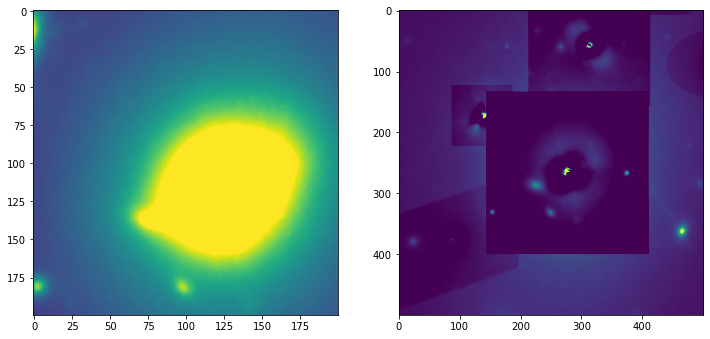

In [1022]:
temp = cutout(image, 1760, 2305, 200)
plt.subplot(121).imshow(temp, vmin=0, vmax=vmax)

temp = cutout(image_copy, 1760, 2305, 500)
plt.subplot(122).imshow(temp, vmin=0, vmax=vmax)

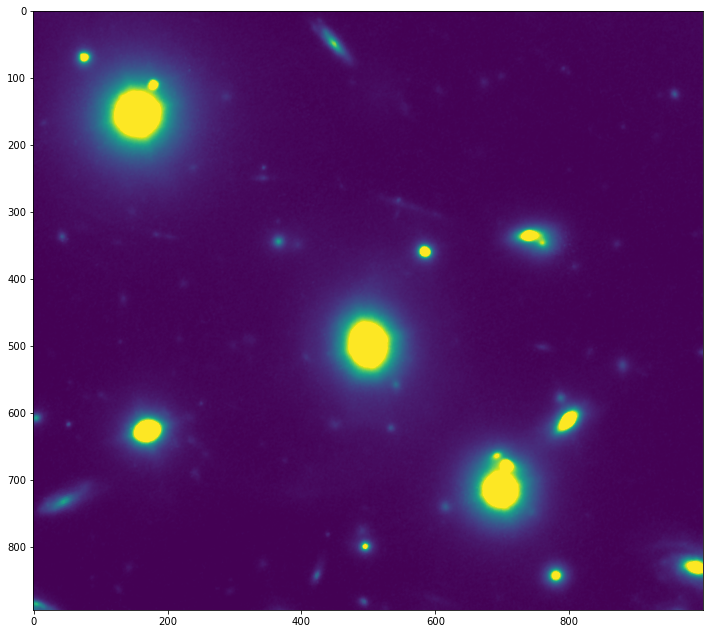

In [991]:
temp = cutout(image, 834, 3105, 1000)
#temp = np.clip(temp, sig3, temp.max())
plt.imshow(temp, vmin=0, vmax=vmax)

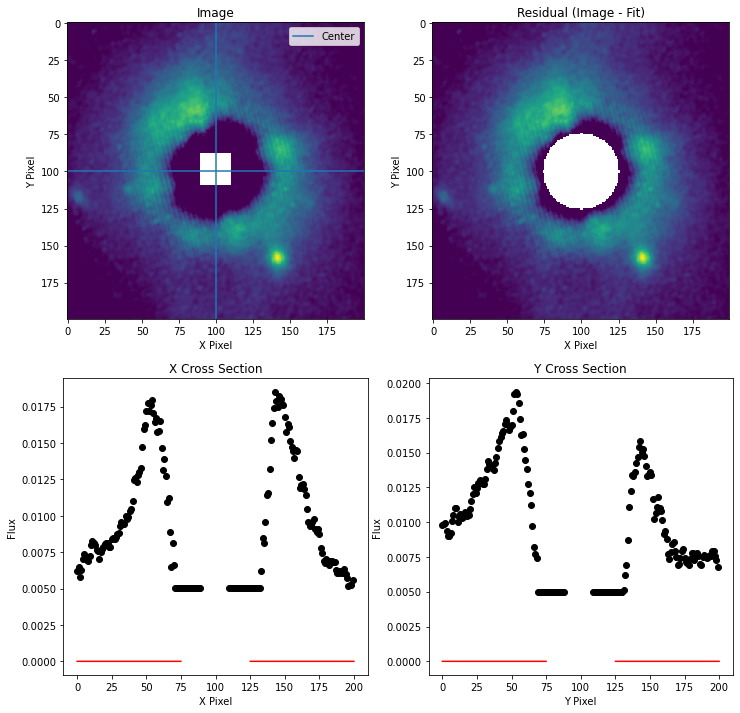

In [734]:
model, fit = fit_trapezoiddisk2d(temp)
plot_fit(temp, model);

In [81]:
 y_arange, x_arange = np.mgrid[:100, :100]

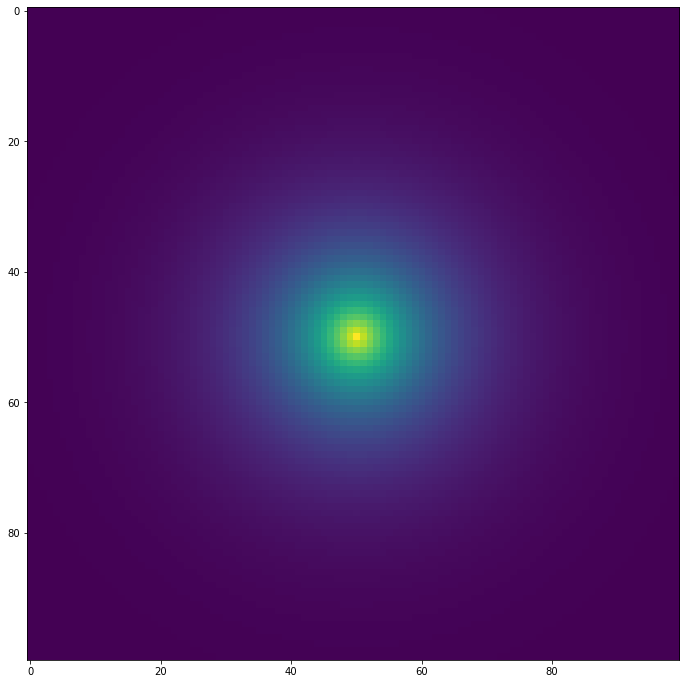

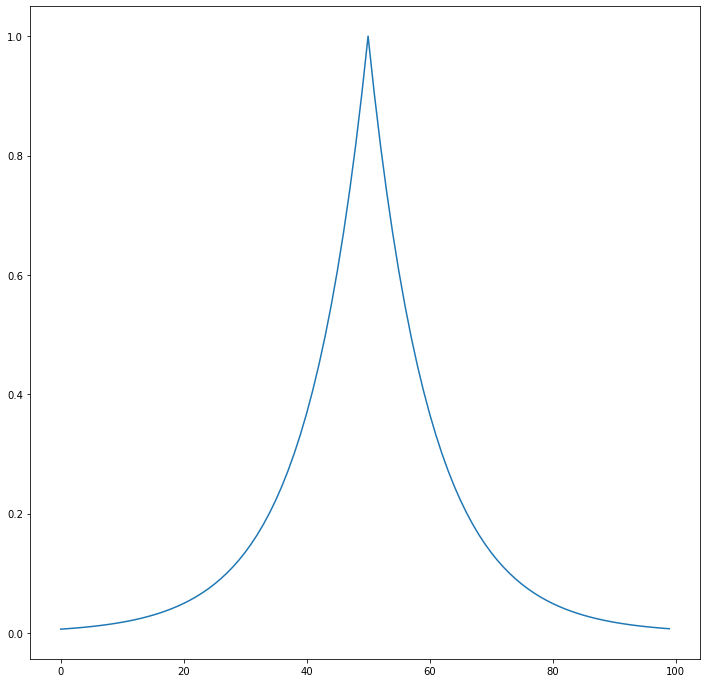

In [91]:
model = Exponential2d(amplitude=1, r_eff=10, x_0=y_arange.shape[0]//2, y_0=y_arange.shape[0]//2)
plt.imshow(model(y_arange, x_arange))
plt.show()

plt.plot(y_arange[:, int(model.x_0.value)], model(y_arange[:, int(model.x_0.value)], model.x_0))

In [87]:
x_arange[:, model.x_0]

IndexError: only integers, slices (`:`), ellipsis (`...`), numpy.newaxis (`None`) and integer or boolean arrays are valid indices

In [90]:
y_arange[:, int(model.x_0.value)]

array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
       17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
       34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50,
       51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67,
       68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84,
       85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99])

In [500]:
err = fit.fit_info['param_cov']
err.mean()

142.1211432015795

In [499]:
list(zip(model.param_names, model.parameters))

[('amplitude_0', 0.011504101420226285),
 ('r_eff_0', 360.6862483138099),
 ('n_0', 3.830302638130534),
 ('x_0_0', 275.51971374057706),
 ('y_0_0', 266.49055315063083),
 ('ellip_0', 0.17708172338583328),
 ('theta_0', -0.8178179135349284),
 ('amplitude_1', -0.12379278775773721),
 ('x_mean_1', 273.64461309620935),
 ('y_mean_1', 270.18773819940066),
 ('x_stddev_1', 55.795086111285755),
 ('y_stddev_1', 77.27237690905133),
 ('theta_1', 0.9131024018240003)]

In [293]:
list(zip(model.param_names, model.parameters))

[('amplitude', 0.24779804950161508),
 ('r_eff', 16.792034937150966),
 ('n', 1.6834706209547574),
 ('x_0', 78.60185304418862),
 ('y_0', 73.79155749104801),
 ('ellip', -0.13907517792862295),
 ('theta', -0.012045338652732811)]

In [58]:
# chi-squared test with similar proportions
from scipy.stats import chi2_contingency
from scipy.stats import chi2
# contingency table
table = [	[10, 20, 30],
			[6,  9,  17]]
print(table)
stat, p, dof, expected = chi2_contingency(table)
print('dof=%d' % dof)
print(expected)
# interpret test-statistic
prob = 0.95
critical = chi2.ppf(prob, dof)
print('probability=%.3f, critical=%.3f, stat=%.3f' % (prob, critical, stat))
if abs(stat) >= critical:
	print('Dependent (reject H0)')
else:
	print('Independent (fail to reject H0)')
# interpret p-value
alpha = 1.0 - prob
print('significance=%.3f, p=%.3f' % (alpha, p))
if p <= alpha:
	print('Dependent (reject H0)')
else:
	print('Independent (fail to reject H0)')

[[10, 20, 30], [6, 9, 17]]
dof=2
[[10.43478261 18.91304348 30.65217391]
 [ 5.56521739 10.08695652 16.34782609]]
probability=0.950, critical=5.991, stat=0.272
Independent (fail to reject H0)
significance=0.050, p=0.873
Independent (fail to reject H0)


(14, 22)

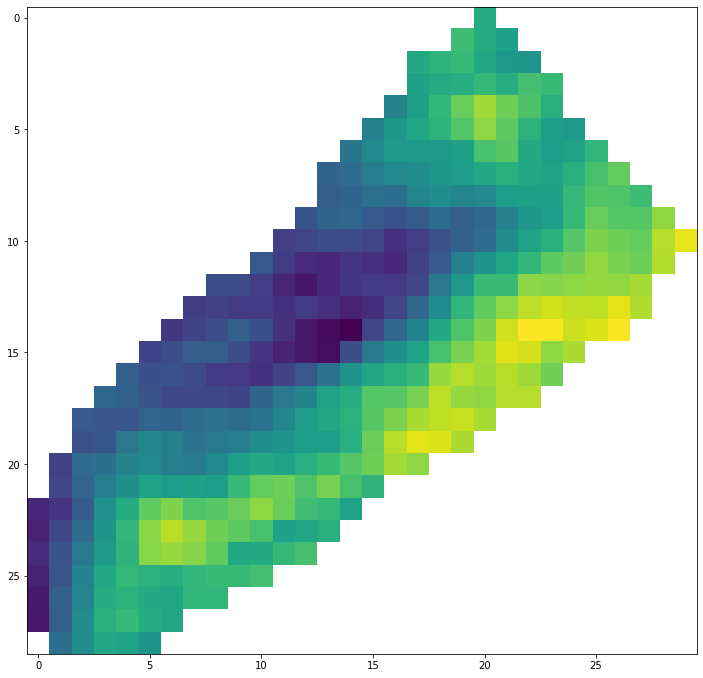

In [121]:
plt.imshow(obj.segment.make_cutout(image, masked_array=True))

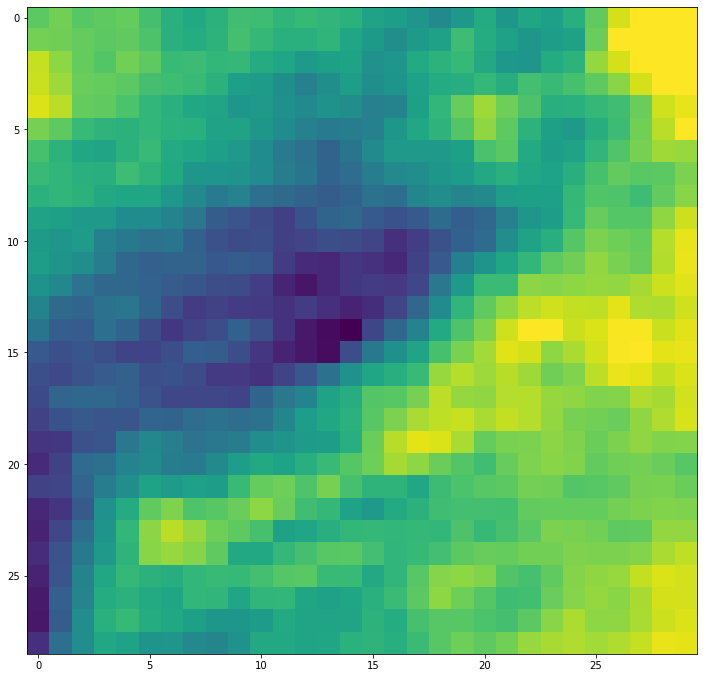

In [123]:

plt.imshow(image[3251:3280, 2158:2188], vmax=0.0018300455)

BoundingBox(ixmin=2158, ixmax=2188, iymin=3251, iymax=3280)

In [ ]:
models.Sersic2D

In [802]:
model

<Sersic2D(amplitude=0.08454217, r_eff=17.73055044, n=1.28872857, x_0=76.82791117, y_0=75.46909953, ellip=0.01538497, theta=-69480848.9358245)>

In [770]:
models.Sersic2D(amplitude=)

In [111]:
np.unique(temp)

masked_array(data=[0.006232967134565115, 0.007121657021343708,
                   0.007366343401372433, ..., 3.809312105178833,
                   3.9240472316741943, --],
             mask=[False, False, False, ..., False, False,  True],
       fill_value=1e+20,
            dtype=float32)

In [112]:
plt.imshow(z, vmax=mean_noise*200)

NameError: name 'z' is not defined

In [380]:
amon = image 

In [381]:
image = temp

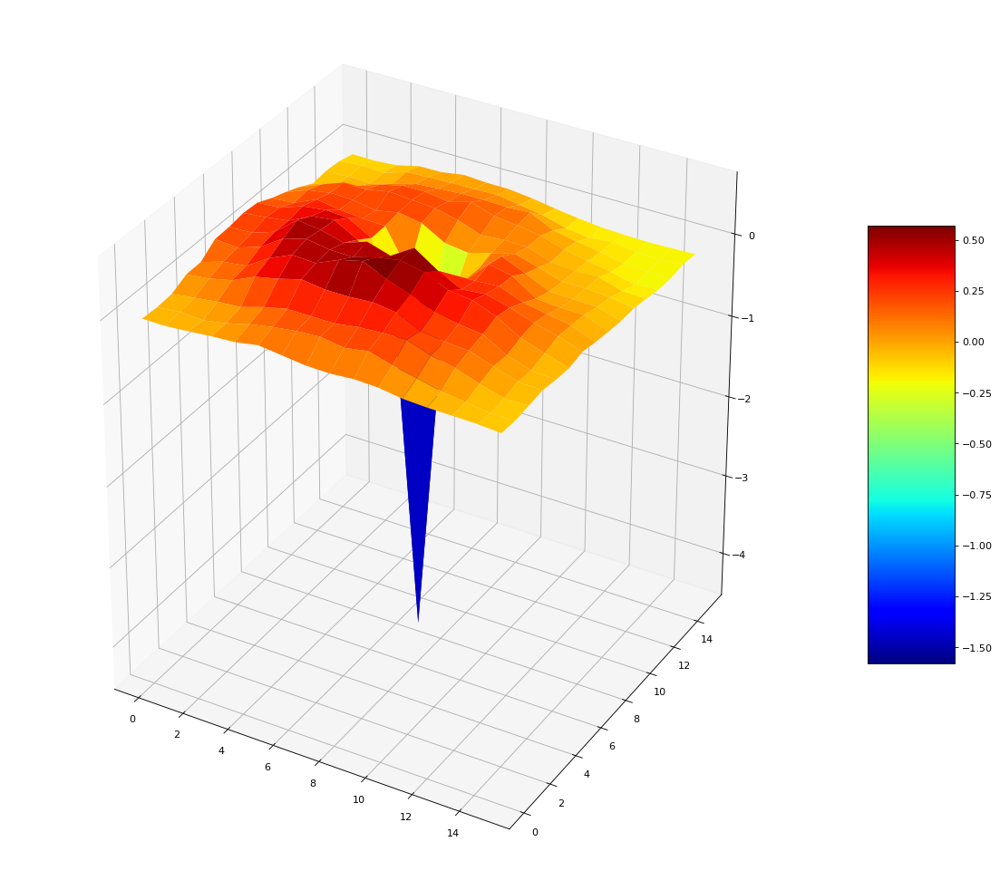

In [382]:
fig = plt.figure(figsize=(18, 16), dpi= 80, facecolor='w', edgecolor='k')
ax = fig.add_subplot(111, projection='3d')
y = np.arange(0, len(image), 1)
x = np.arange(0, len(image[0]), 1)
X, Y = np.meshgrid(x, y)
surf = ax.plot_surface(Y, X, np.clip(image,image.min(),image.mean()*80), cmap=cm.jet)
fig.colorbar(surf, shrink=0.5, aspect=5)
#ax.contourf3D(Y, X, np.sqrt(image))


In [383]:
image = amon  

In [471]:
len(segm_deblend.segments)

257

In [486]:
np.log(seg.make_cutout(image)).mean()

-4.323031

In [498]:
seg.data[0]

array([  0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0, 251, 251, 251, 251, 251, 251,
       251, 251, 251,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0])

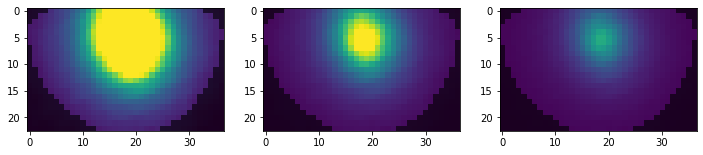

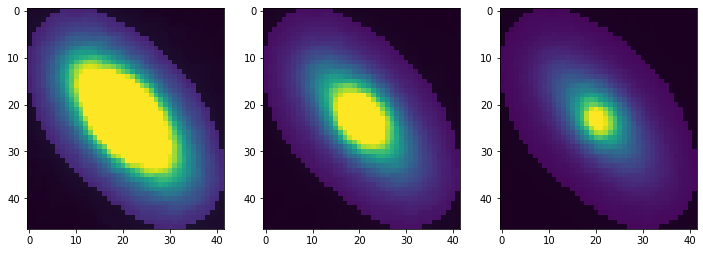

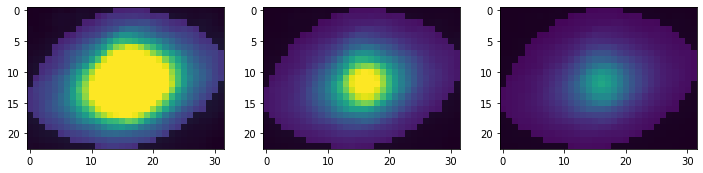

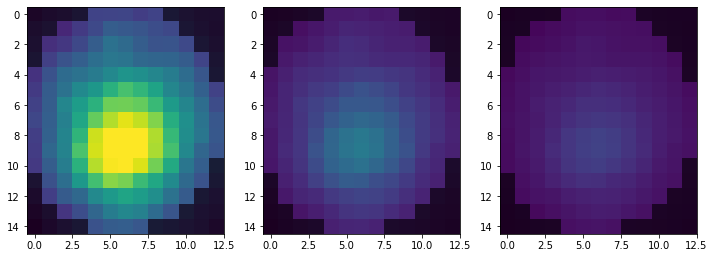

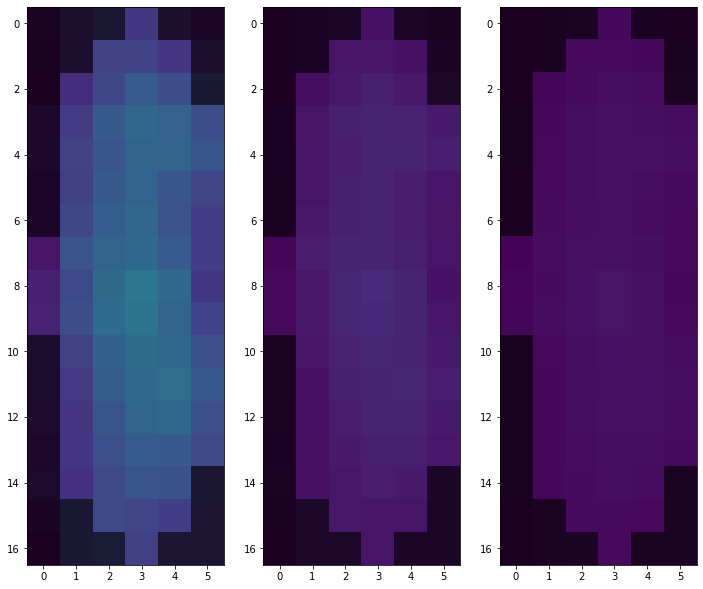

...

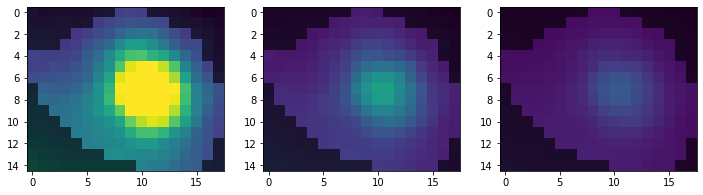

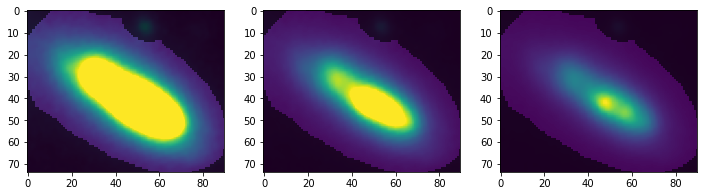

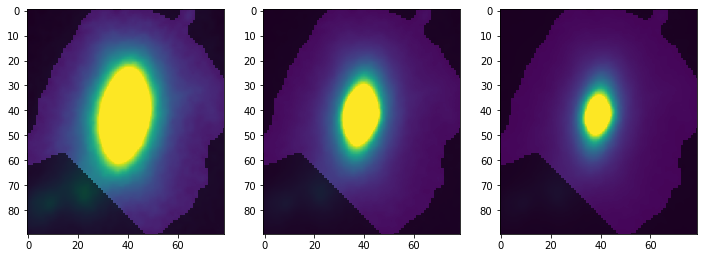

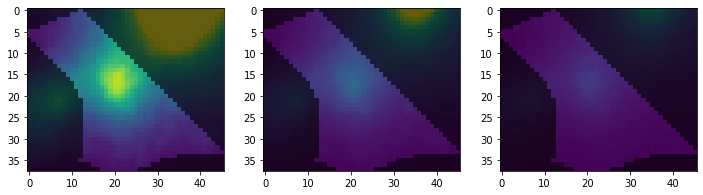

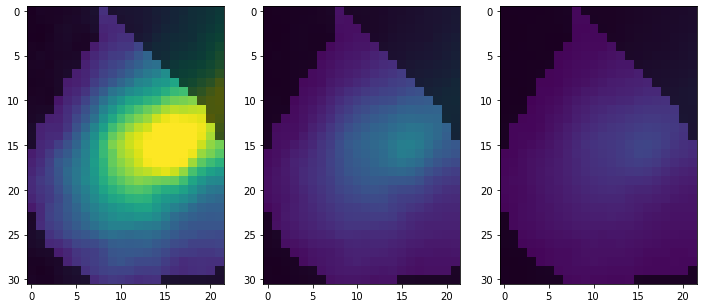

In [67]:
for seg in segm_deblend.segments[:]:
    fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(12, 12))
    
    temp = seg.make_cutout(image)
    ax1.imshow(temp, vmax=temp.mean()*2)
    ax2.imshow(temp, vmax=temp.mean()*5)
    ax3.imshow(temp, vmax=temp.mean()*10)
    
    mask = seg.data.copy()
    mask = mask.astype(float)
    mask[np.where(mask > 0.)] = np.nan
    ax1.imshow(mask,  cmap='gray', alpha=0.6)
    ax2.imshow(mask, cmap='gray', alpha=0.6)
    ax3.imshow(mask, cmap='gray', alpha=0.6)
    
    plt.show()
    

In [601]:
 mask

array([[ 0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,
         0., nan, nan, nan, nan, nan, nan,  0.,  0.,  0.,  0.,  0.,  0.,
         0.,  0.,  0.,  0.,  0.,  0.],
       [ 0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0., nan, nan,
        nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,  0.,  0.,  0.,
         0.,  0.,  0.,  0.,  0.,  0.],
       [ 0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0., nan, nan, nan, nan,
        nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
         0.,  0.,  0.,  0.,  0.,  0.],
       [ 0.,  0.,  0.,  0.,  0.,  0.,  0.,  0., nan, nan, nan, nan, nan,
        nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
        nan, nan,  0.,  0.,  0.,  0.],
       [ 0.,  0.,  0.,  0.,  0.,  0., nan, nan, nan, nan, nan, nan, nan,
        nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
        nan, nan, nan,  0.,  0.,  0.],
       [ 0.,  0.,  0.,  0.,  0., nan, nan, nan, nan, nan, nan, nan, nan,
  

In [551]:
np.where(mask == 0.)

(array([ 0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  1,  1,  1,  1,  1,  1,  1,  1,
         1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  2,  2,  2,  2,  2,
         2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  3,  3,  3,  3,  3,  3,  3,
         3,  3,  3,  3,  3,  4,  4,  4,  4,  4,  4,  4,  4,  4,  5,  5,  5,
         5,  5,  5,  5,  6,  6,  6,  6,  6,  7,  7,  7,  7,  8,  8,  8,  9,
         9, 10, 10, 11, 12, 12, 13, 14, 14, 15, 15, 15, 16, 16, 16, 17, 17,
        17, 17, 17, 17, 18, 18, 18, 18, 18, 18, 18, 18, 19, 19, 19, 19, 19,
        19, 19, 19, 19, 19, 20, 20, 20, 20, 20, 20, 20, 20, 20, 20, 20, 20,
        20, 20, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21,
        21, 21, 21, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22,
        22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22]),
 array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 20, 21, 22,
        23, 24, 25, 26, 27, 28, 29

Subtract estimated background and clip out negative values

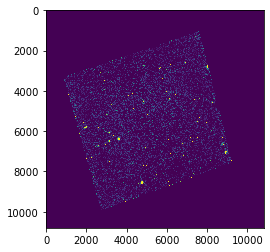

In [492]:
image = image - mean_noise
image = np.clip(image, 0, image.max())

plt.imshow(image, vmax=mean_noise*100)

### Make Catalog

In [517]:
fwhm = 12.
threshold = 100*mean_noise

daofind = DAOStarFinder(fwhm=fwhm, threshold=threshold)  

sources = daofind(image)

assert sources is not None, "sources is None"

print("{} objects found".format(len(sources)))

2332 objects found


### Make Apertures

In [518]:
positions = np.transpose((sources['xcentroid'], sources['ycentroid']))  
apertures = CircularAperture(positions, r=fwhm)   

### Do Photometry

In [519]:
phot_table = aperture_photometry(image, apertures)  

print(phot_table) 

 id       xcenter            ycenter           aperture_sum   
            pix                pix                            
---- ------------------ ------------------ -------------------
   1  7507.164579475982 1076.3472615205937  2.9466726488136468
   2  7582.209897856621 1083.4255997392036 0.14819885784641978
   3  7330.148406766949 1131.4241177482002 0.21335428781152926
   4  7270.963835810397 1152.6183958309423  0.2125946074744987
   5  7600.089668773877  1162.253626184575  0.2709612866198274
   6  7195.097966362596 1180.7582305663184 0.23924962513993187
   7  7588.152469039182 1188.1478100904028  0.5261876484226478
   8  7597.936174678438 1191.0227886967539  0.5349906998767404
   9  7109.403756274077  1211.725668411012  0.2565911183695436
  10  6907.263281094216 1278.2481584699158  0.1927506095834917
 ...                ...                ...                 ...
2323 3008.7362881994663  9557.078178899248  0.1259232086917017
2324  3283.425049370239  9637.818054988784 0.1318940846

### Plot

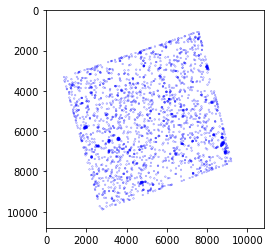

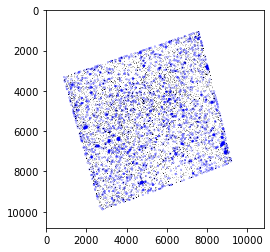

In [520]:
plt.imshow(np.zeros_like(image), cmap='gray_r')
apertures.plot(color='blue', lw=1.5, alpha=0.5)


plt.show()

plt.imshow(image, cmap='gray_r', vmax=mean_noise*50)
apertures.plot(color='blue', lw=1.5, alpha=0.5)

# Save Catalog to File

In [521]:
output_table = Table(sources)
output_table.add_column(phot_table['aperture_sum'])

In [522]:
output_table.write(output_path, format="ascii.csv", overwrite=True)

In [661]:
temp.mean()

0.010064324

In [820]:
sig8 = np.unique(detect_threshold(image, nsigma=3.))[0]
sig3 = np.unique(detect_threshold(image, nsigma=0.))[0]

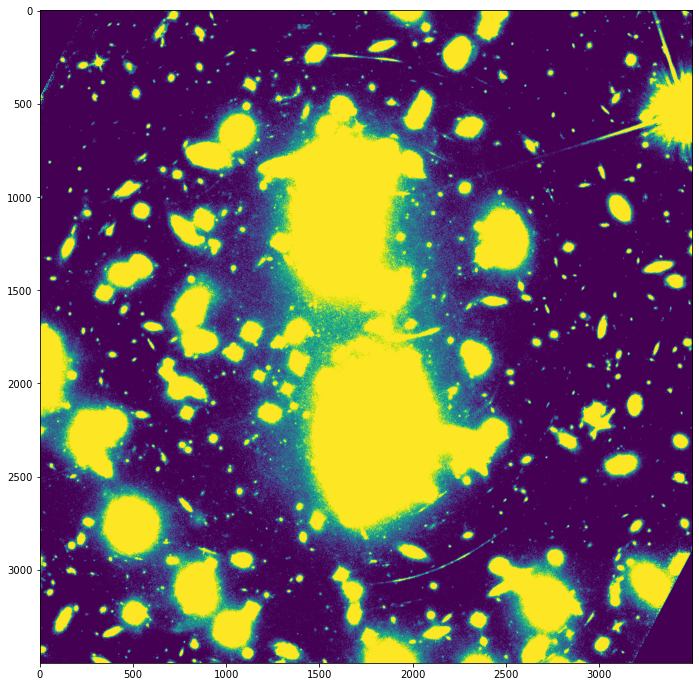

In [748]:
temp = np.clip(image, sig3, sig8)
plt.imshow(temp, vmin=sig3, vmax=sig8)

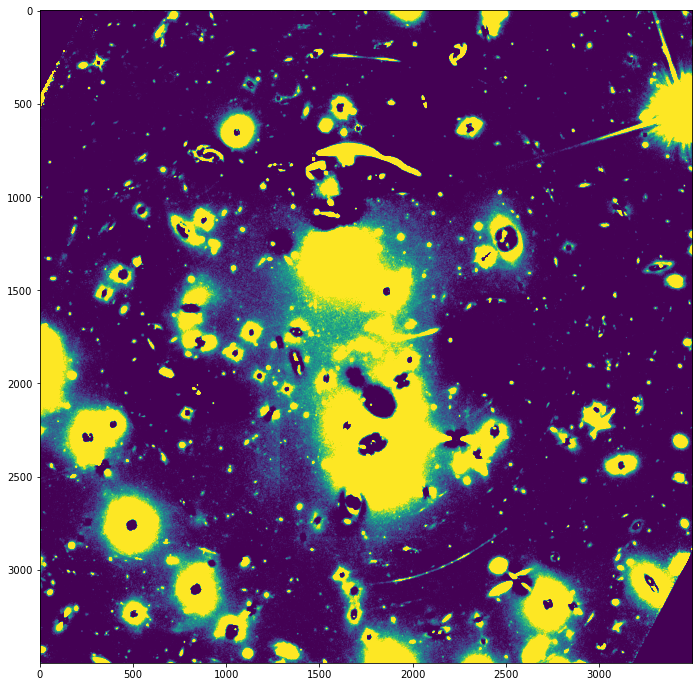

In [821]:
temp = np.clip(image_copy, sig3, image.max())
plt.imshow(temp, vmin=sig3, vmax=sig8)

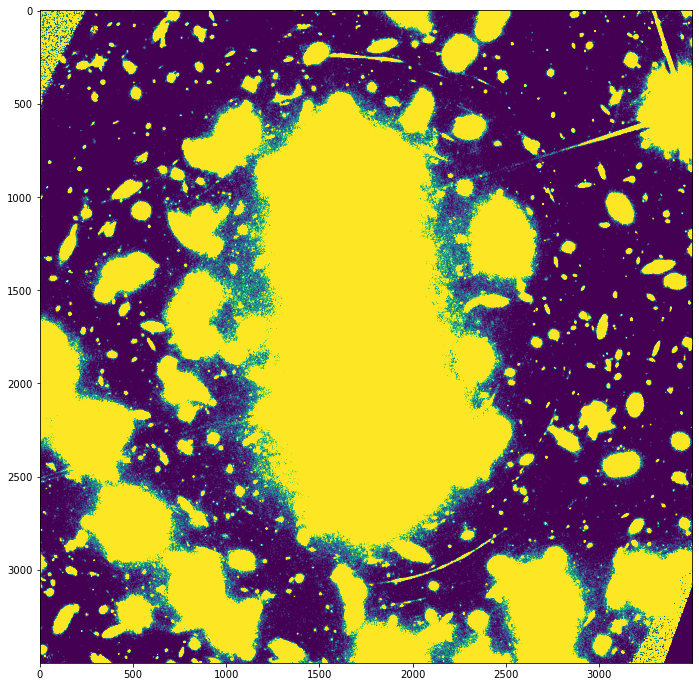

In [92]:
temp = np.clip(image, sig3, image.max())
plt.imshow(temp, vmin=sig3, vmax=sig8*2)

In [198]:
cx, cy = wcs.world_to_pixel_values(header["RA_TARG"], header["DEC_TARG"])
image = cutout(data, int(cx), int(cy), 4500)

In [199]:
y_arange, x_arange = np.mgrid[:image.shape[0], :image.shape[1]]

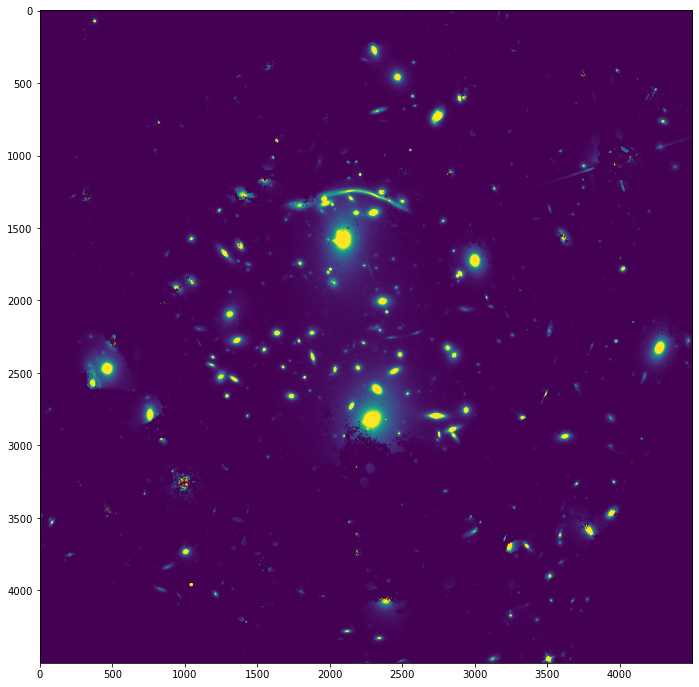

In [143]:
plt.imshow(image, vmin=sig3, vmax=mean_noise*300)
plt.contour(y_arange, x_arange, image, vmin=sig3, vmax=mean_noise*300)

In [220]:
spacing = (vmax - vmin)/4
levels = np.arange(vmin, vmax, spacing)
levels = np.append(levels, vmax)

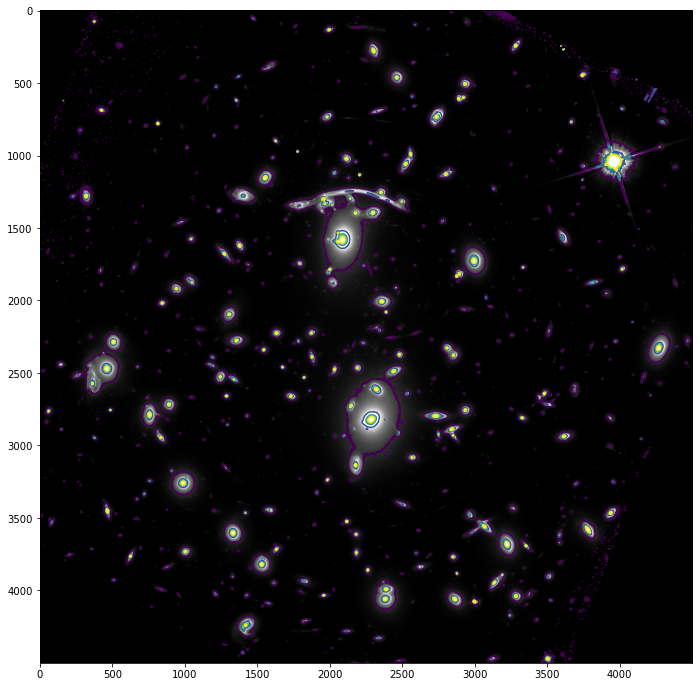

In [221]:
plt.imshow(image, vmin=sig3, vmax=mean_noise*300, cmap='Greys_r',)
plt.contour(x_arange, y_arange, image, levels=levels, vmin=vmin, vmax=vmax)

In [215]:
vmin = mean_noise*50

In [219]:
vmax = mean_noise*1000